In [1]:
## if you run in google colab, you need to uncomment the following and download the data and XRO source code to run this notebook

# run_google_colab = True
run_google_colab = False


In [2]:
import importlib.util
import subprocess
import sys
import warnings

warnings.filterwarnings("ignore")

# Function to check and install a package if not found
def install_if_missing(package):
    if importlib.util.find_spec(package) is None:
        print(f"Installing {package}...")
        subprocess.check_call([sys.executable, "-m", "pip", "install", package])
    else:
        print(f"{package} is already installed.")

# List of required packages
required_packages = [
    "matplotlib", "numpy", "xarray", "nc-time-axis", "cftime", "climpred", "dateutil", "seaborn",
]

if run_google_colab:
    # Install missing packages if needed
    for pkg in required_packages:
        install_if_missing(pkg)

# Importing libraries after ensuring they are installed
%config IPCompleter.greedy = True
%matplotlib inline
%config InlineBackend.figure_format='retina'
%load_ext autoreload
%autoreload 2

import datetime

import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import xarray as xr
from climpred import HindcastEnsemble
from dateutil.relativedelta import *
from matplotlib.ticker import AutoMinorLocator


In [3]:
if run_google_colab:
    # Download necessary files if running in Google Colab
    !wget -cq https://github.com/senclimate/XRO/raw/main/data/XRO_indices_oras5.nc
    !wget -cq https://github.com/senclimate/XRO/raw/main/code/XRO.py
    !wget -cq https://github.com/senclimate/XRO/raw/main/code/XRO_utils.py

# def setup_module_path():
module_path = '/proj/kimyy/Dropbox/source/python/all/Modules/XRO-main'
sys.path.append(module_path)

# Import necessary modules after ensuring files are available
from XRO import XRO, xcorr, SkewAccessor, plot_above_below_shading, plot_fill_between, pmtm
# from XRO_utils import SkewAccessor, plot_above_below_shading, plot_fill_between, pmtm

print("All required libraries are installed and imported successfully!")

All required libraries are installed and imported successfully!


In [4]:
# prepare NPP file
npp_file = '/mnt/lustre/proj/kimyy/Model/CESM2/ESP/for_LIM/LIM_input_obs_photoC_TOT_zint_100m_x1_210_x2_270_y1_-20_y2_10.nc'
npp_ds = xr.open_dataset(npp_file).sel(time=slice('1979-01', '2023-12'))
# print(npp_ds)
clim = npp_ds.sel(time=slice("1980-01-01", "2010-12-31")).groupby("time.month").mean("time")
anomalies = npp_ds.groupby("time.month") - clim
t = np.arange(anomalies.time.size)
coeffs = np.polyfit(t, anomalies['obs_photoC_TOT_zint_100m'].values, deg=2)
trend = np.polyval(coeffs, t)
npp_ds = anomalies - xr.DataArray(trend, dims=["time"], coords={"time": anomalies.time})

# prepare SSH file
ssh_file = '/mnt/lustre/proj/kimyy/Model/CESM2/ESP/for_LIM/LIM_input_obs_SSH_x1_210_x2_270_y1_-20_y2_10.nc'
ssh_ds = xr.open_dataset(ssh_file).sel(time=slice('1979-01', '2023-12'))
clim = ssh_ds.sel(time=slice("1980-01-01", "2010-12-31")).groupby("time.month").mean("time")
anomalies = ssh_ds.groupby("time.month") - clim
t = np.arange(anomalies.time.size)
coeffs = np.polyfit(t, anomalies['obs_SSH'].values, deg=2)
trend = np.polyval(coeffs, t)
ssh_ds = anomalies - xr.DataArray(trend, dims=["time"], coords={"time": anomalies.time})

# prepare SST file
sst_file = '/mnt/lustre/proj/kimyy/Model/CESM2/ESP/for_LIM/LIM_input_obs_TEMP_x1_210_x2_270_y1_-20_y2_10.nc'
sst_ds = xr.open_dataset(sst_file).sel(time=slice('1979-01', '2023-12'))
clim = sst_ds.sel(time=slice("1980-01-01", "2010-12-31")).groupby("time.month").mean("time")
anomalies = sst_ds.groupby("time.month") - clim
t = np.arange(anomalies.time.size)
coeffs = np.polyfit(t, anomalies['obs_SST'].values, deg=2)
trend = np.polyval(coeffs, t)
sst_ds = anomalies - xr.DataArray(trend, dims=["time"], coords={"time": anomalies.time})

# prepare MLD file
mld_file = '/mnt/lustre/proj/kimyy/Model/CESM2/ESP/for_LIM/LIM_input_obs_HBLT_x1_210_x2_270_y1_-20_y2_10.nc'
mld_ds = xr.open_dataset(mld_file).sel(time_counter=slice('1979-01', '2023-12'))
mld_ds = mld_ds.rename({'time_counter': 'time'})
clim = mld_ds.sel(time=slice("1980-01-01", "2010-12-31")).groupby("time.month").mean("time")
anomalies = mld_ds.groupby("time.month") - clim
t = np.arange(anomalies.time.size)
coeffs = np.polyfit(t, anomalies['obs_HBLT'].values, deg=2)
trend = np.polyval(coeffs, t)
mld_ds = anomalies - xr.DataArray(trend, dims=["time"], coords={"time": anomalies.time})


In [5]:
# load observed state vectors of XRO: which include ENSO, WWV, and other modes SST indices
# the order of variables is important, with first two must be ENSO SST and WWV;
if run_google_colab:
    obs_file = './XRO_indices_oras5.nc'
else:
    # obs_file = '../data/XRO_indices_oras5.nc'
    obs_file = '/mnt/lustre/proj/kimyy/Dropbox/source/python/all/Modules/RO_practical-main/data/XRO_indices_oras5.nc'

obs_ds = xr.open_dataset(obs_file).sel(time=slice('1998-01', '2023-12'))
obs_RO_ds = obs_ds[['Nino34', 'WWV']]
# print(obs_RO_ds)
print(obs_ds)
obs_ds.time

<xarray.Dataset> Size: 16kB
Dimensions:  (time: 312)
Coordinates:
  * time     (time) datetime64[ns] 2kB 1998-01-01 1998-02-01 ... 2023-12-01
    month    (time) int32 1kB ...
Data variables:
    Nino34   (time) float32 1kB ...
    WWV      (time) float32 1kB ...
    NPMM     (time) float32 1kB ...
    SPMM     (time) float32 1kB ...
    IOB      (time) float32 1kB ...
    IOD      (time) float32 1kB ...
    SIOD     (time) float32 1kB ...
    TNA      (time) float32 1kB ...
    ATL3     (time) float32 1kB ...
    SASD     (time) float32 1kB ...


<xarray.DataArray 'time' (time: 312)> Size: 2kB
array(['1998-01-01T00:00:00.000000000', '1998-02-01T00:00:00.000000000',
       '1998-03-01T00:00:00.000000000', ..., '2023-10-01T00:00:00.000000000',
       '2023-11-01T00:00:00.000000000', '2023-12-01T00:00:00.000000000'],
      dtype='datetime64[ns]')
Coordinates:
  * time     (time) datetime64[ns] 2kB 1998-01-01 1998-02-01 ... 2023-12-01
    month    (time) int32 1kB ...

In [6]:
# obs + npp
npp = npp_ds['obs_photoC_TOT_zint_100m'].rename('NPP')
npp_on_obs_time = npp.reindex(time=obs_RO_ds.time)
obs_ds_with_npp = obs_ds.copy()
obs_ds_with_npp['NPP'] = npp_on_obs_time

# obs + npp + ssh
ssh = ssh_ds['obs_SSH'].rename('SSH')
ssh_on_obs_time = ssh.reindex(time=obs_RO_ds.time, method='nearest', tolerance='20D')
obs_ds_with_ssh = obs_ds_with_npp.copy()
obs_ds_with_ssh['SSH'] = ssh_on_obs_time

# obs + npp + ssh + sst
# sst = sst_ds['obs_SST'].rename('SST')
# sst_on_obs_time = sst.reindex(time=obs_RO_ds.time)
# obs_ds_with_all = obs_ds_with_ssh.copy()
# obs_ds_with_all['SST'] = sst_on_obs_time

# mld = mld_ds['obs_HBLT'].rename('MLD').rename({'time_counter': 'time'})
mld = mld_ds['obs_HBLT'].rename('MLD')
mld_on_obs_time = mld.reindex(time=obs_RO_ds.time, method='nearest', tolerance='20D')
obs_ds_with_mld = obs_ds_with_ssh.copy()
obs_ds_with_mld['MLD'] = mld_on_obs_time

sst = sst_ds['obs_SST'].rename('SST')
sst_on_obs_time = sst.reindex(time=obs_RO_ds.time, method='nearest', tolerance='20D')
obs_ds_with_all = obs_ds_with_mld.copy()
obs_ds_with_all['SST'] = sst_on_obs_time


In [7]:
# File path

ds = obs_ds_with_all
# Variables to preprocess
varnames = ["SST", "NPP", "SSH", "MLD"]

# Function to remove monthly climatology (1980–2010) and quadratic trend
def deseason_detrend(da):
    # 1️⃣ Monthly climatology (1980–2010)
    # clim = da.sel(time=slice("1980-01-01", "2010-12-31")).groupby("time.month").mean("time")
    clim = da.sel(time=slice("1998-01-01", "2023-12-31")).groupby("time.month").mean("time")
    anomalies = da.groupby("time.month") - clim

    # 2️⃣ Quadratic trend (full period)
    t = np.arange(anomalies.time.size)
    coeffs = np.polyfit(t, anomalies.values, deg=2)
    trend = np.polyval(coeffs, t)

    return anomalies - xr.DataArray(trend, dims=["time"], coords={"time": anomalies.time})

# Apply preprocessing for each variable
processed_vars = {}
for v in varnames:
    print(f"Processing {v} ...")
    processed_vars[v] = deseason_detrend(ds[v])

# Merge processed variables into one dataset
ds_processed = xr.Dataset(processed_vars)

ds_processed

obs_all = xr.merge([obs_ds, ds_processed])
obs_all


Processing SST ...
Processing NPP ...
Processing SSH ...
Processing MLD ...


<xarray.Dataset> Size: 26kB
Dimensions:  (time: 312)
Coordinates:
  * time     (time) datetime64[ns] 2kB 1998-01-01 1998-02-01 ... 2023-12-01
    month    (time) int32 1kB 1 2 3 4 5 6 7 8 9 10 11 ... 3 4 5 6 7 8 9 10 11 12
Data variables: (12/14)
    Nino34   (time) float32 1kB ...
    WWV      (time) float32 1kB ...
    NPMM     (time) float32 1kB ...
    SPMM     (time) float32 1kB ...
    IOB      (time) float32 1kB ...
    IOD      (time) float32 1kB ...
    ...       ...
    ATL3     (time) float32 1kB ...
    SASD     (time) float32 1kB ...
    SST      (time) float64 2kB 1.855 1.601 1.6 1.017 ... 1.169 1.228 1.228
    NPP      (time) float64 2kB -93.48 -92.75 -108.9 -96.6 ... 20.94 23.1 -1.796
    SSH      (time) float64 2kB 0.1355 0.1146 0.08627 ... 0.03517 0.04502
    MLD      (time) float64 2kB 3.849 4.93 4.648 1.398 ... -3.878 7.102 6.112

In [8]:
import xarray as xr
import os
import re
import pandas as pd
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=RuntimeWarning)


# File path
model_file = "/mnt/lustre/proj/kimyy/Model/CESM2/ESP/for_LIM/LIM_input_LE_x1_210_x2_270_y1_-20_y2_10.nc"

# Open and slice time
ds = xr.open_dataset(model_file).sel(time=slice("1998-01-01", "2023-12-31"))

# Convert CESM 'days since 1998-01-17' to datetime64
ds["time"] = xr.decode_cf(ds[["time"]]).time

# Variables to preprocess
varnames = ["TEMP", "photoC_TOT_zint_100m", "SSH", "HBLT", "Fe"]

# Function to remove monthly climatology (1980–2010) and quadratic trend
def deseason_detrend(da):
    # 1️⃣ Monthly climatology (1980–2010)
    clim = da.sel(time=slice("1998-01-01", "2023-12-31")).groupby("time.month").mean("time")
    anomalies = da.groupby("time.month") - clim

    # 2️⃣ Quadratic trend (full period)
    t = np.arange(anomalies.time.size)
    coeffs = np.polyfit(t, anomalies.mean("ens_LE").values, deg=2)
    trend = np.polyval(coeffs, t)

    return anomalies - xr.DataArray(trend, dims=["time"], coords={"time": anomalies.time})

# Apply preprocessing for each variable
processed_vars = {}
for v in varnames:
    print(f"Processing {v} ...")
    processed_vars[v] = deseason_detrend(ds[v])

# Merge processed variables into one dataset
ds_processed = xr.Dataset(processed_vars)

# Add auxiliary coordinate
# ds_processed = ds_processed.assign_coords(month=("time", ds_processed["time"].dt.month))

# ✅ done
ds_processed = ds_processed.isel(ens_LE=0)
#units cm -> m
ds_processed['SSH']=ds_processed['SSH']/100
ds_processed['HBLT']=ds_processed['HBLT']/100
ds_processed['photoC_TOT_zint_100m']=ds_processed['photoC_TOT_zint_100m']*1000/8.32/10**7*100*100*86400
#LE NPP : mmol/m^3 cm/s (mmol/m^3 cm/s == nmol/cm^2/s)
# nmol/cm^2/s -> 1000/8.32/10^7 *100 *100 * 86400 -> mg / m^-2 / day
ds_processed


# read indices
# Base directory
base_dir = "/mnt/lustre/proj/kimyy/Model/CESM2/ESP/for_XRO/"

# Pattern for model files
files = sorted([f for f in os.listdir(base_dir) if f.endswith(".nc") and "XRO_input_LE_" in f])

# Variable name map (optional: if you want short names)
name_map = {
    "ENSO": "Nino34",
    "WWV": "WWV",
    "NPMM": "NPMM",
    "SPMM": "SPMM",
    "IOB": "IOB",
    "IOD": "IOD",
    "SIOD": "SIOD",
    "TNA": "TNA",
    "ATL3": "ATL3",
    "SASD": "SASD",
}

# Container for each variable
datasets = {}

for f in files:
    path = os.path.join(base_dir, f)
    # extract variable name from filename, e.g. XRO_input_LE_ENSO.nc → ENSO
    var = re.search(r"XRO_input_LE_(.*)\.nc", f).group(1)
    var_short = name_map.get(var, var)  # rename to match OBS if needed
    ds = xr.open_dataset(path)

    # ensure time consistency
    # ds = ds.sel(time=slice("1998-01", "2023-12"))
    ds = ds.sel(time=slice("1998-01", "2023-12"))
    # pick the main variable automatically
    data_var = list(ds.data_vars)[0]
    datasets[var_short] = ds[data_var]

# Merge into one dataset
model_ds = xr.Dataset(datasets)

# Add month coordinate (like model_ds)
# model_ds = model_ds.assign_coords(month=("time", model_ds["time"].dt.month))

model_ds=model_ds.isel(ens_LE=0)
print(model_ds)


# removing monthly climatology (1998~2023)
# removing quadratic trend (all period)

# Variables to skip. Those dipole variables are already preprocessed
skip_vars = ["IOD", "SIOD", "SASD"]

# Create an empty container for processed variables
processed_vars = {}

for var in model_ds.data_vars:
    da = model_ds[var]

    if var in skip_vars:
        # Skip preprocessing for these
        processed_vars[var] = da
        print(f"Skipping preprocessing for {var}")
        continue

    # 1️⃣ Remove monthly climatology (1980–2010)
    clim = da.sel(time=slice("1998-01-01", "2023-12-31")).groupby("time.month").mean("time")
    anomalies = da.groupby("time.month") - clim

    # 2️⃣ Remove quadratic trend (over full time)
    t = np.arange(anomalies.time.size)
    coeffs = np.polyfit(t, anomalies.values, deg=2)
    trend = np.polyval(coeffs, t)
    detrended = anomalies - xr.DataArray(trend, dims=["time"], coords={"time": anomalies.time})

    processed_vars[var] = detrended.astype(np.float32)
    print(f"Processed {var}")

# Merge all processed variables back into one dataset
model_ds_processed = xr.Dataset(processed_vars, coords={"time": model_ds.time})
# model_ds_processed = model_ds_processed.assign_coords(month=("time", model_ds.time.dt.month))

# and units (cm -> m)
model_ds_processed['WWV']=model_ds_processed['WWV']/100

# model_ds_processed = model_ds_processed.rename_vars({
#     "ALT3": "ATL3",
# })
model_ds_processed




# merging indices & local variables
model_all = xr.merge([model_ds_processed, ds_processed])



# postprocessing

model_all = xr.merge([model_ds_processed, ds_processed])
model_all = model_all.rename_vars({
    "TEMP": "SST",
    "photoC_TOT_zint_100m": "NPP",
    "HBLT": "MLD"
})

# --- Convert time to datetime64 if not already ---
if (
    "cftime" in str(type(model_all.time.values[0]))
    or "CFTimeIndex" in str(type(model_all.indexes.get("time", None)))
):
    model_all["time"] = model_all.indexes["time"].to_datetimeindex()
elif not pd.api.types.is_datetime64_any_dtype(model_all.time):
    model_all = xr.decode_cf(model_all)

# --- Create target obs-style time axis (1998-01-01 → 2023-12-01) ---
obs_time = pd.date_range("1998-01-01", "2023-12-01", freq="MS")

# --- Ensure same length before assigning ---
n_model = model_all.sizes["time"]
n_obs = len(obs_time)
n_min = min(n_model, n_obs)

model_all = model_all.isel(time=slice(0, n_min))
obs_time = obs_time[:n_min]

# --- Replace with new monthly timestamps ---
model_all = model_all.assign_coords(time=("time", obs_time))


model_all



Processing TEMP ...
Processing photoC_TOT_zint_100m ...
Processing SSH ...
Processing HBLT ...
Processing Fe ...
<xarray.Dataset> Size: 22kB
Dimensions:  (time: 312)
Coordinates:
    ens_LE   int64 8B 0
  * time     (time) object 2kB 1998-01-17 00:00:00 ... 2023-12-17 00:00:00
    month    (time) int64 2kB 1 2 3 4 5 6 7 8 9 10 11 ... 3 4 5 6 7 8 9 10 11 12
Data variables:
    ATL3     (time) float32 1kB ...
    Nino34   (time) float32 1kB ...
    IOB      (time) float32 1kB ...
    IOD      (time) float64 2kB ...
    NPMM     (time) float32 1kB ...
    SASD     (time) float64 2kB ...
    SIOD     (time) float64 2kB ...
    SPMM     (time) float32 1kB ...
    TNA      (time) float32 1kB ...
    WWV      (time) float64 2kB ...
Processed ATL3
Processed Nino34
Processed IOB
Skipping preprocessing for IOD
Processed NPMM
Skipping preprocessing for SASD
Skipping preprocessing for SIOD
Processed SPMM
Processed TNA
Processed WWV


<xarray.Dataset> Size: 34kB
Dimensions:  (time: 312)
Coordinates:
    ens_LE   int64 8B 0
    month    (time) int64 2kB 1 2 3 4 5 6 7 8 9 10 11 ... 3 4 5 6 7 8 9 10 11 12
  * time     (time) datetime64[ns] 2kB 1998-01-01 1998-02-01 ... 2023-12-01
Data variables: (12/15)
    ATL3     (time) float32 1kB -0.5262 -0.3542 -0.3116 ... -0.4799 -0.66
    Nino34   (time) float32 1kB 1.125 1.073 0.9869 ... -1.706 -2.059 -2.087
    IOB      (time) float32 1kB -0.04865 -0.03409 -0.06281 ... -0.2762 -0.536
    IOD      (time) float64 2kB ...
    NPMM     (time) float32 1kB 0.5614 0.7964 0.7415 ... -0.2981 -0.05504 0.1242
    SASD     (time) float64 2kB ...
    ...       ...
    WWV      (time) float32 1kB 1.282 2.263 2.701 1.582 ... 10.6 9.742 12.11
    SST      (time) float64 2kB 0.7171 0.6704 0.8445 ... -1.821 -2.026 -2.063
    NPP      (time) float64 2kB -1.045 30.28 4.239 ... -110.6 -34.5 -3.563
    SSH      (time) float64 2kB 0.03204 0.03437 0.04504 ... -0.05581 -0.05267
    MLD      (time) float64 2kB -0.06342 -1.49 -4.833 ... 9.124 3.054 4.371
    Fe       (time) float64 2kB -1.139e-06 -3.391e-07 ... 3.384e-05 2.62e-05

In [11]:
obs_all

<xarray.Dataset> Size: 26kB
Dimensions:  (time: 312)
Coordinates:
  * time     (time) datetime64[ns] 2kB 1998-01-01 1998-02-01 ... 2023-12-01
    month    (time) int32 1kB 1 2 3 4 5 6 7 8 9 10 11 ... 3 4 5 6 7 8 9 10 11 12
Data variables: (12/14)
    Nino34   (time) float32 1kB ...
    WWV      (time) float32 1kB ...
    NPMM     (time) float32 1kB ...
    SPMM     (time) float32 1kB ...
    IOB      (time) float32 1kB ...
    IOD      (time) float32 1kB ...
    ...       ...
    ATL3     (time) float32 1kB ...
    SASD     (time) float32 1kB ...
    SST      (time) float64 2kB 1.855 1.601 1.6 1.017 ... 1.169 1.228 1.228
    NPP      (time) float64 2kB -93.48 -92.75 -108.9 -96.6 ... 20.94 23.1 -1.796
    SSH      (time) float64 2kB 0.1355 0.1146 0.08627 ... 0.03517 0.04502
    MLD      (time) float64 2kB 3.849 4.93 4.648 1.398 ... -3.878 7.102 6.112

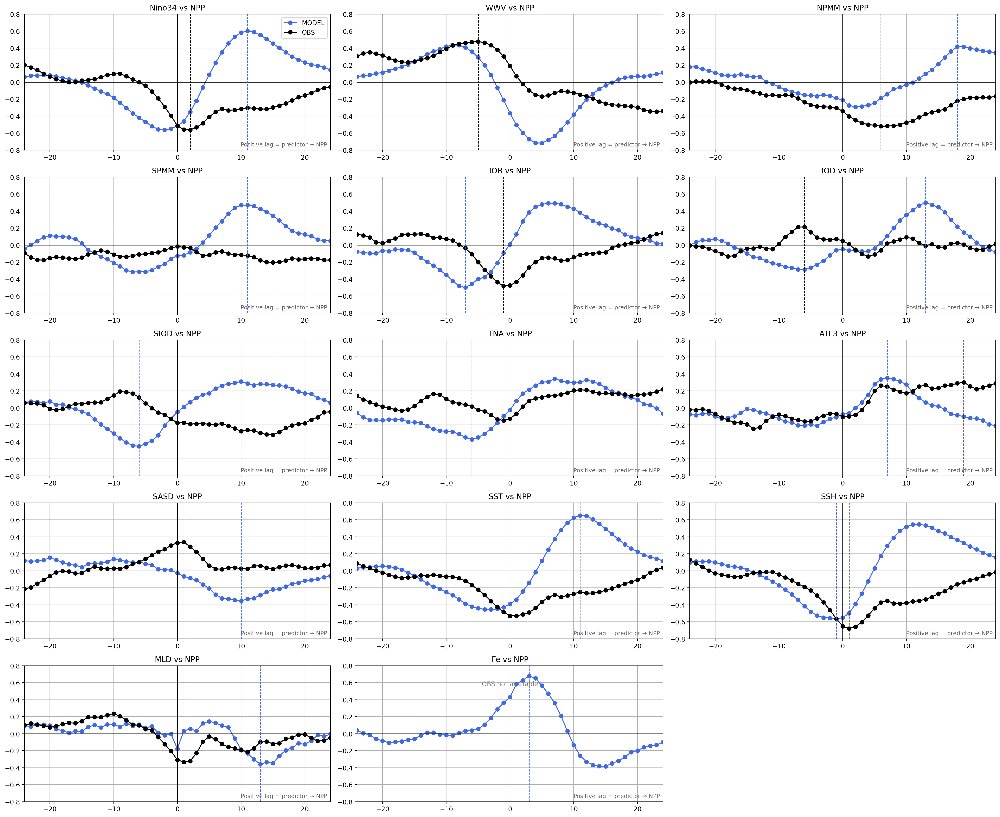

In [17]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

# ---------------------------------------------------------
# Function: compute lead-lag correlation
# ---------------------------------------------------------
def leadlag_corr(x, y, max_lag=24):
    lags = np.arange(-max_lag, max_lag + 1)
    corr = np.zeros(len(lags))

    for i, lag in enumerate(lags):
        if lag > 0:
            c = xr.corr(x.shift(time=lag), y, dim="time")
        elif lag < 0:
            c = xr.corr(x, y.shift(time=-lag), dim="time")
        else:
            c = xr.corr(x, y, dim="time")
        corr[i] = c.values
    return lags, corr


# =========================================================
# 1) VARIABLE LIST  — Fe 추가됨
# =========================================================
var_list = [
    "Nino34","WWV","NPMM","SPMM","IOB","IOD","SIOD",
    "TNA","ATL3","SASD","SST","SSH","MLD",
    "Fe"      # added
]


# =========================================================
# 2) TARGET VAR = NPP
# =========================================================
target_obs  = obs_all["NPP"]
target_mod  = model_all["NPP"]


# =========================================================
# Panel settings — 3 columns
# =========================================================
n = len(var_list)
ncol = 3
nrow = int(np.ceil(n / ncol))

plt.figure(figsize=(22, 18))

for i, var in enumerate(var_list):
    ax = plt.subplot(nrow, ncol, i+1)

    # -------- predictor load ----------
    x_mod = model_all[var]

    # -------- MODEL NaN alignment ----------
    valid_mod = xr.ufuncs.isfinite(x_mod) & xr.ufuncs.isfinite(target_mod)
    xm = x_mod.where(valid_mod, drop=True)
    ym = target_mod.where(valid_mod, drop=True)

    # -------- MODEL correlation ----------
    lags, corr_mod = leadlag_corr(xm, ym, max_lag=24)

    # -------- Plot MODEL line (blue) ----------
    ax.plot(lags, corr_mod, marker='o', color='royalblue', label='MODEL')

    # -------- OBS line (only if exists) ----------
    if var in obs_all:
        x_obs = obs_all[var]
        valid_obs = xr.ufuncs.isfinite(x_obs) & xr.ufuncs.isfinite(target_obs)
        xo = x_obs.where(valid_obs, drop=True)
        yo = target_obs.where(valid_obs, drop=True)
        _, corr_obs = leadlag_corr(xo, yo, max_lag=24)
        ax.plot(lags, corr_obs, marker='o', color='black', label='OBS')
    else:
        # Fe처럼 OBS가 없을 때
        ax.text(0.5, 0.85, "OBS not available", fontsize=10,
                transform=ax.transAxes, ha='center', color='gray')

    # Zero lines
    ax.axhline(0, color='k', linewidth=1)
    ax.axvline(0, color='k', linewidth=1)

    ax.set_ylim(-0.8, 0.8)
    ax.set_xlim(-24, 24)
    ax.grid(True)

    # ------------ strongest correlation markers ------------
    # MODEL
    idx_mod = np.nanargmax(np.abs(corr_mod))
    lag_mod = lags[idx_mod]
    ax.axvline(lag_mod, color='royalblue', linestyle='--', linewidth=1)

    # OBS strongest (if exists)
    if var in obs_all:
        idx_obs = np.nanargmax(np.abs(corr_obs))
        lag_obs = lags[idx_obs]
        ax.axvline(lag_obs, color='black', linestyle='--', linewidth=1)

    # annotation
    ax.text(
        0.99, 0.02,
        "Positive lag = predictor → NPP",
        ha='right', va='bottom', fontsize=9,
        transform=ax.transAxes, color='dimgray'
    )

    ax.set_title(f"{var} vs NPP", fontsize=12)

    if i == 0:
        ax.legend(fontsize=10)

plt.tight_layout()
plt.show()


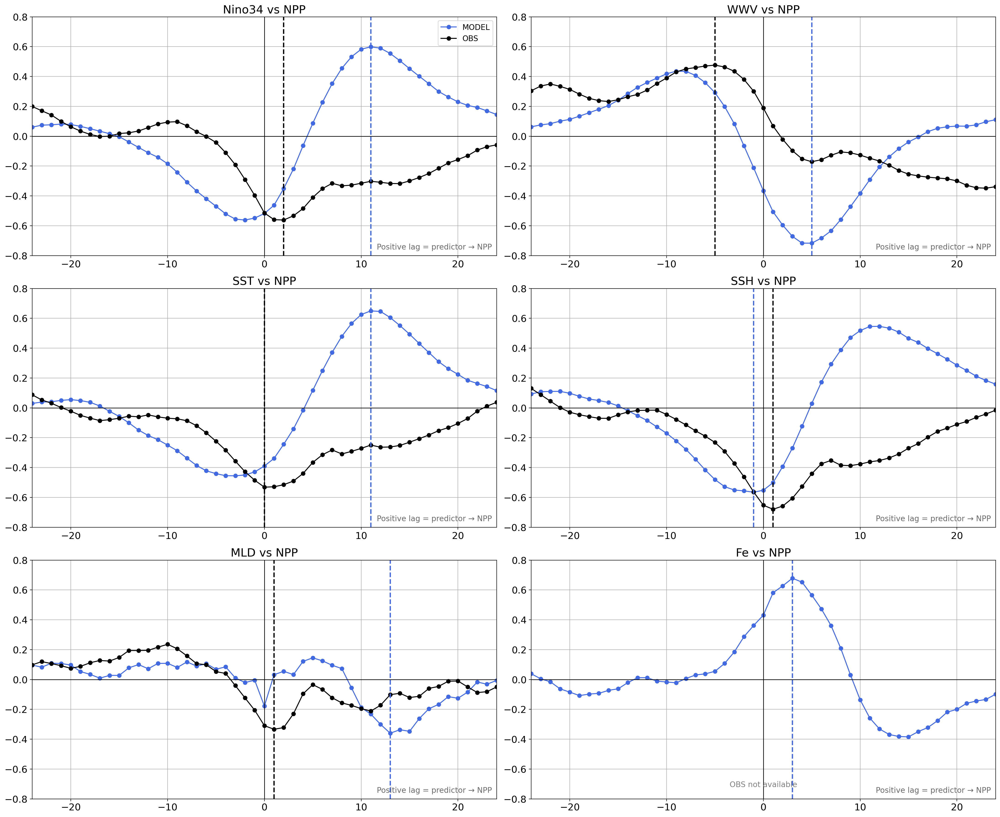

In [23]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

# ---------------------------------------------------------
# Function: compute lead-lag correlation
# ---------------------------------------------------------
def leadlag_corr(x, y, max_lag=24):
    lags = np.arange(-max_lag, max_lag + 1)
    corr = np.zeros(len(lags))

    for i, lag in enumerate(lags):
        if lag > 0:
            c = xr.corr(x.shift(time=lag), y, dim="time")
        elif lag < 0:
            c = xr.corr(x, y.shift(time=-lag), dim="time")
        else:
            c = xr.corr(x, y, dim="time")
        corr[i] = c.values
    return lags, corr


# =========================================================
# 1) VARIABLE LIST  — Fe 추가됨
# =========================================================
var_list = [
    "Nino34","WWV","SST","SSH","MLD","Fe"
]


# =========================================================
# 2) TARGET VAR = NPP
# =========================================================
target_obs  = obs_all["NPP"]
target_mod  = model_all["NPP"]


# =========================================================
# Panel settings — 3 columns
# =========================================================
n = len(var_list)
ncol = 2
nrow = int(np.ceil(n / ncol))

plt.figure(figsize=(22, 18))

for i, var in enumerate(var_list):
    ax = plt.subplot(nrow, ncol, i+1)

    # -------- predictor load ----------
    x_mod = model_all[var]

    # -------- MODEL NaN alignment ----------
    valid_mod = xr.ufuncs.isfinite(x_mod) & xr.ufuncs.isfinite(target_mod)
    xm = x_mod.where(valid_mod, drop=True)
    ym = target_mod.where(valid_mod, drop=True)

    # -------- MODEL correlation ----------
    lags, corr_mod = leadlag_corr(xm, ym, max_lag=24)

    # -------- Plot MODEL line (blue) ----------
    ax.plot(lags, corr_mod, marker='o', color='royalblue', label='MODEL')

    # -------- OBS line (only if exists) ----------
    if var in obs_all:
        x_obs = obs_all[var]
        valid_obs = xr.ufuncs.isfinite(x_obs) & xr.ufuncs.isfinite(target_obs)
        xo = x_obs.where(valid_obs, drop=True)
        yo = target_obs.where(valid_obs, drop=True)
        _, corr_obs = leadlag_corr(xo, yo, max_lag=24)
        ax.plot(lags, corr_obs, marker='o', color='black', label='OBS')
    else:
        # Fe처럼 OBS가 없을 때
        ax.text(0.5, 0.05, "OBS not available", fontsize=12,
                transform=ax.transAxes, ha='center', color='gray')

    # Zero lines
    ax.axhline(0, color='k', linewidth=1)
    ax.axvline(0, color='k', linewidth=1)

    ax.set_ylim(-0.8, 0.8)
    ax.set_xlim(-24, 24)
    ax.grid(True)

    # ------------ strongest correlation markers ------------
    # MODEL
    idx_mod = np.nanargmax(np.abs(corr_mod))
    lag_mod = lags[idx_mod]
    ax.axvline(lag_mod, color='royalblue', linestyle='--', linewidth=2)

    # OBS strongest (if exists)
    if var in obs_all:
        idx_obs = np.nanargmax(np.abs(corr_obs))
        lag_obs = lags[idx_obs]
        ax.axvline(lag_obs, color='black', linestyle='--', linewidth=2)

    # annotation
    ax.text(
        0.99, 0.02,
        "Positive lag = predictor → NPP",
        ha='right', va='bottom', fontsize=12,
        transform=ax.transAxes, color='dimgray'
    )

    ax.set_title(f"{var} vs NPP", fontsize=18)

    if i == 0:
        ax.legend(fontsize=12)

    ax.tick_params(axis='both', labelsize=15)

plt.tight_layout()
plt.show()


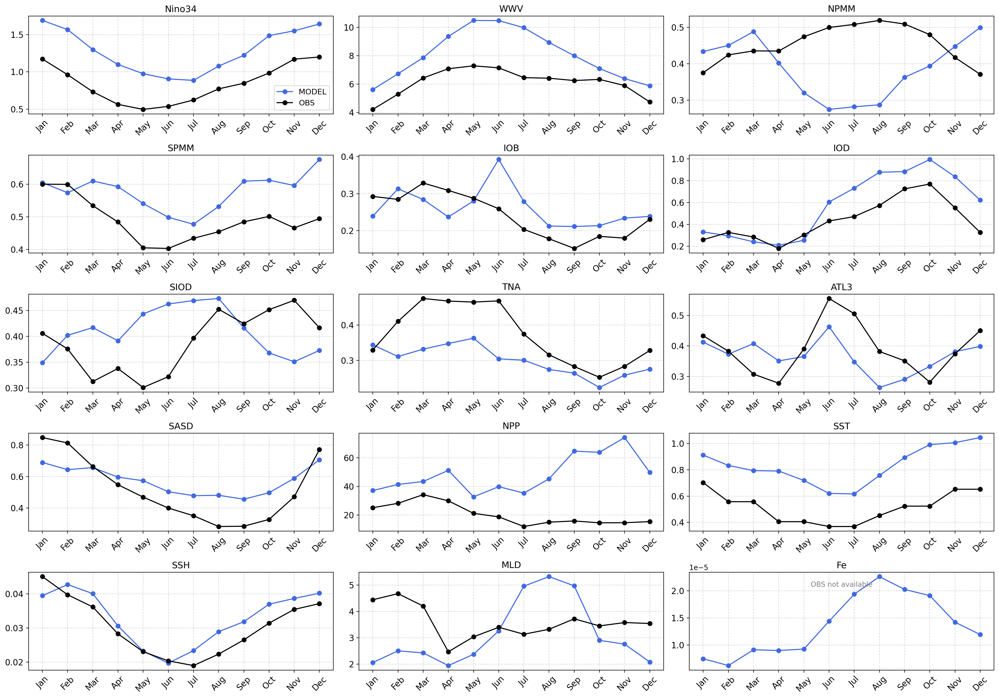

In [29]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

# ---------------------------------------------------------
# Variable list (Fe has only model data)
# ---------------------------------------------------------
var_list = [
    "Nino34","WWV","NPMM","SPMM","IOB","IOD","SIOD",
    "TNA","ATL3","SASD","NPP", "SST","SSH","MLD","Fe"
]

# ---------------------------------------------------------
# Function: compute monthly standard deviation of interannual anomalies
# ---------------------------------------------------------
def monthly_std(da):
    # Remove monthly climatology first
    clim = da.groupby("time.month").mean("time")
    anom = da.groupby("time.month") - clim
    # Compute standard deviation within each month across years
    std  = anom.groupby("time.month").std("time")
    return std

# ---------------------------------------------------------
# Panel layout: 3 columns
# ---------------------------------------------------------
ncol = 3
nrow = int(np.ceil(len(var_list) / ncol))

fig, axes = plt.subplots(nrow, ncol, figsize=(20, 14))
axes = axes.flatten()

calendar = ["Jan","Feb","Mar","Apr","May","Jun",
            "Jul","Aug","Sep","Oct","Nov","Dec"]

for i, var in enumerate(var_list):
    ax = axes[i]

    # ---- MODEL ----
    if var in model_all:
        std_mod = monthly_std(model_all[var])
        ax.plot(std_mod["month"], std_mod, color="royalblue",
                marker="o", label="MODEL")

    # ---- OBS ----
    if var in obs_all:
        std_obs = monthly_std(obs_all[var])
        ax.plot(std_obs["month"], std_obs, color="black",
                marker="o", label="OBS")
    else:
        # If OBS data is missing (e.g., Fe)
        ax.text(0.5, 0.85, "OBS not available", fontsize=10,
                ha='center', transform=ax.transAxes, color="gray")

    # ---- Aesthetics ----
    ax.set_xticks(np.arange(1,13))
    ax.set_xticklabels(calendar, rotation=45)
    ax.grid(True, linestyle="--", alpha=0.5)
    ax.set_title(var, fontsize=13)
    ax.tick_params(axis='both', labelsize=12)

    if i == 0:
        ax.legend(fontsize=11)

# Hide empty panels if any
for j in range(i+1, len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()


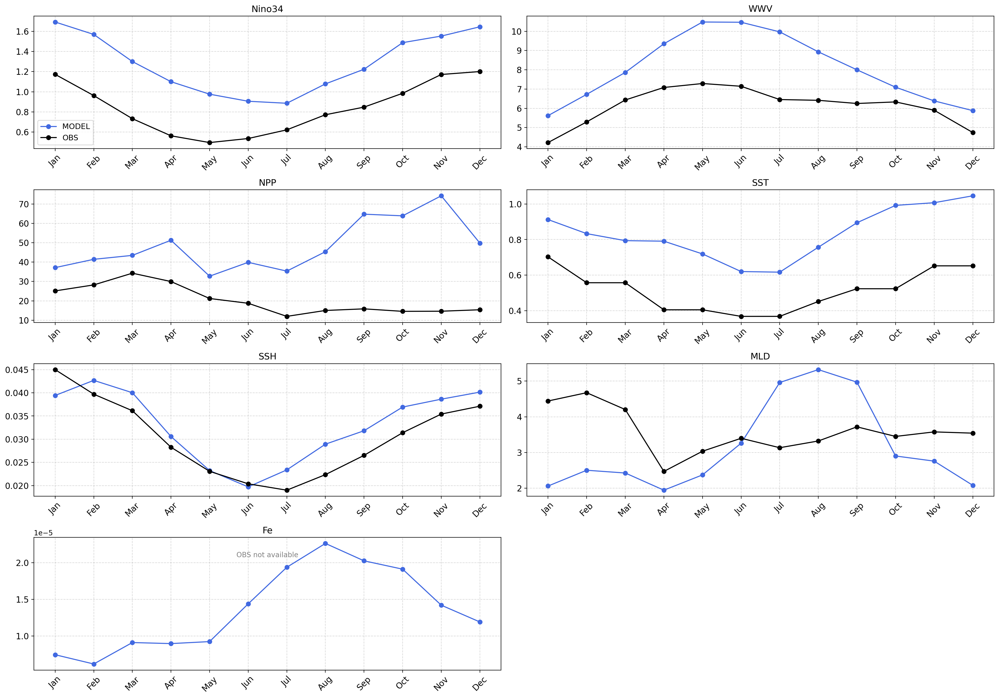

In [30]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

# ---------------------------------------------------------
# Variable list (Fe has only model data)
# ---------------------------------------------------------
var_list = [
    "Nino34","WWV", "NPP", "SST","SSH","MLD","Fe"
]

# ---------------------------------------------------------
# Function: compute monthly standard deviation of interannual anomalies
# ---------------------------------------------------------
def monthly_std(da):
    # Remove monthly climatology first
    clim = da.groupby("time.month").mean("time")
    anom = da.groupby("time.month") - clim
    # Compute standard deviation within each month across years
    std  = anom.groupby("time.month").std("time")
    return std

# ---------------------------------------------------------
# Panel layout: 3 columns
# ---------------------------------------------------------
ncol = 2
nrow = int(np.ceil(len(var_list) / ncol))

fig, axes = plt.subplots(nrow, ncol, figsize=(20, 14))
axes = axes.flatten()

calendar = ["Jan","Feb","Mar","Apr","May","Jun",
            "Jul","Aug","Sep","Oct","Nov","Dec"]

for i, var in enumerate(var_list):
    ax = axes[i]

    # ---- MODEL ----
    if var in model_all:
        std_mod = monthly_std(model_all[var])
        ax.plot(std_mod["month"], std_mod, color="royalblue",
                marker="o", label="MODEL")

    # ---- OBS ----
    if var in obs_all:
        std_obs = monthly_std(obs_all[var])
        ax.plot(std_obs["month"], std_obs, color="black",
                marker="o", label="OBS")
    else:
        # If OBS data is missing (e.g., Fe)
        ax.text(0.5, 0.85, "OBS not available", fontsize=10,
                ha='center', transform=ax.transAxes, color="gray")

    # ---- Aesthetics ----
    ax.set_xticks(np.arange(1,13))
    ax.set_xticklabels(calendar, rotation=45)
    ax.grid(True, linestyle="--", alpha=0.5)
    ax.set_title(var, fontsize=13)
    ax.tick_params(axis='both', labelsize=12)

    if i == 0:
        ax.legend(fontsize=11)

# Hide empty panels if any
for j in range(i+1, len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()


In [ ]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

# ---------------------------------------------------------
# Variable list (Fe has only model data)
# ---------------------------------------------------------
var_list = [
    "Nino34","WWV", "NPP", "SST","SSH","MLD"
]

# ---------------------------------------------------------
# Function: compute monthly standard deviation of interannual anomalies
# ---------------------------------------------------------
def monthly_std(da):
    # Remove monthly climatology first
    clim = da.groupby("time.month").mean("time")
    anom = da.groupby("time.month") - clim
    # Compute standard deviation within each month across years
    std  = anom.groupby("time.month").std("time")
    return std

# ---------------------------------------------------------
# Panel layout: 3 columns
# ---------------------------------------------------------
ncol = 2
nrow = int(np.ceil(len(var_list) / ncol))

fig, axes = plt.subplots(nrow, ncol, figsize=(20, 14))
axes = axes.flatten()

calendar = ["Jan","Feb","Mar","Apr","May","Jun",
            "Jul","Aug","Sep","Oct","Nov","Dec"]

for i, var in enumerate(var_list):
    ax = axes[i]

    # # ---- MODEL ----
    # if var in model_all:
    #     std_mod = monthly_std(model_all[var])
    #     ax.plot(std_mod["month"], std_mod, color="royalblue",
    #             marker="o", label="MODEL")

    # ---- OBS ----
    if var in obs_all:
        std_obs = monthly_std(obs_all[var])
        ax.plot(std_obs["month"], std_obs, color="black",
                marker="o", label="OBS")
    else:
        # If OBS data is missing (e.g., Fe)
        ax.text(0.5, 0.85, "OBS not available", fontsize=10,
                ha='center', transform=ax.transAxes, color="gray")

    # ---- Aesthetics ----
    ax.set_xticks(np.arange(1,13))
    ax.set_xticklabels(calendar, rotation=45)
    ax.grid(True, linestyle="--", alpha=0.5)
    ax.set_title(var, fontsize=13)
    ax.tick_params(axis='both', labelsize=12)

    if i == 0:
        ax.legend(fontsize=11)

# Hide empty panels if any
for j in range(i+1, len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()


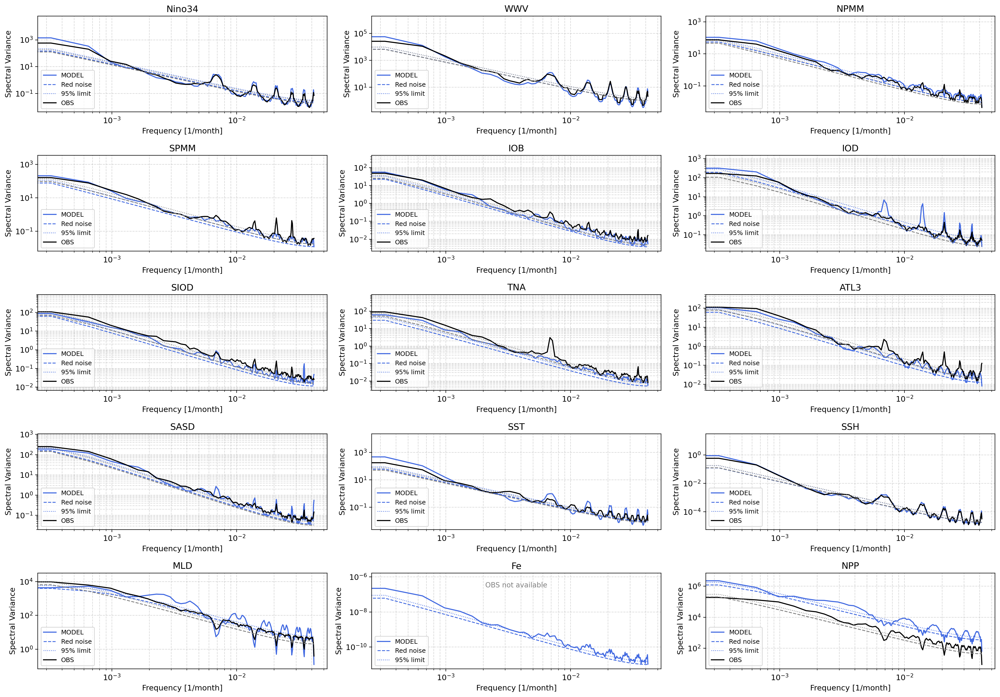

In [32]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
from scipy.signal import welch
from scipy.stats import chi2

# ---------------------------------------------------------
# Variable list
# ---------------------------------------------------------
var_list = [
    "Nino34","WWV","NPMM","SPMM","IOB","IOD","SIOD",
    "TNA","ATL3","SASD","NPP","SST","SSH","MLD","Fe"
]

# ---------------------------------------------------------
# Function: compute AR(1) red-noise spectrum and 95% CI
# ---------------------------------------------------------
def red_noise_spectrum(data, fs=1/12.0, nperseg=256):
    data = data - np.nanmean(data)
    data = data[np.isfinite(data)]
    f, Pxx = welch(data, fs=fs, nperseg=min(nperseg, len(data)//2))

    # lag-1 autocorrelation
    r1 = np.corrcoef(data[:-1], data[1:])[0, 1]
    # theoretical red-noise spectrum
    Sred = (1 - r1**2) / (1 + r1**2 - 2*r1*np.cos(2*np.pi*f/fs))
    Sred = Sred * np.var(data) * (1/fs)

    # 95% confidence limit (chi-square 2 dof)
    dof = 2 * len(data) / nperseg
    red95 = Sred * chi2.ppf(0.95, dof) / dof
    return f, Pxx, Sred, red95

# ---------------------------------------------------------
# Panel layout
# ---------------------------------------------------------
ncol = 3
nrow = int(np.ceil(len(var_list)/ncol))
fig, axes = plt.subplots(nrow, ncol, figsize=(20,14))
axes = axes.flatten()

for i, var in enumerate(var_list):
    ax = axes[i]

    # ---- MODEL ----
    if var in model_all:
        data_mod = (model_all[var] - model_all[var].groupby("time.month").mean("time")).dropna("time")
        f, Pxx, Sred, red95 = red_noise_spectrum(data_mod.values)
        ax.loglog(f, Pxx, color="royalblue", label="MODEL")
        ax.loglog(f, Sred, color="royalblue", ls="--", lw=1.2, label="Red noise")
        ax.loglog(f, red95, color="royalblue", ls=":", lw=1.0, label="95% limit")

    # ---- OBS ----
    if var in obs_all:
        data_obs = (obs_all[var] - obs_all[var].groupby("time.month").mean("time")).dropna("time")
        f, Pxx, Sred, red95 = red_noise_spectrum(data_obs.values)
        ax.loglog(f, Pxx, color="black", label="OBS")
        ax.loglog(f, Sred, color="gray", ls="--", lw=1.2)
        ax.loglog(f, red95, color="gray", ls=":", lw=1.0)
    else:
        ax.text(0.5, 0.85, "OBS not available", fontsize=10,
                ha="center", transform=ax.transAxes, color="gray")

    # ---- Formatting ----
    ax.set_xlabel("Frequency [1/month]", fontsize=11)
    ax.set_ylabel("Spectral Variance", fontsize=11)
    ax.grid(True, which="both", ls="--", alpha=0.5)
    ax.set_title(var, fontsize=13)
    ax.tick_params(axis="both", labelsize=11)
    ax.legend(fontsize=9, loc="lower left")

# hide unused panels
for j in range(i+1, len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()


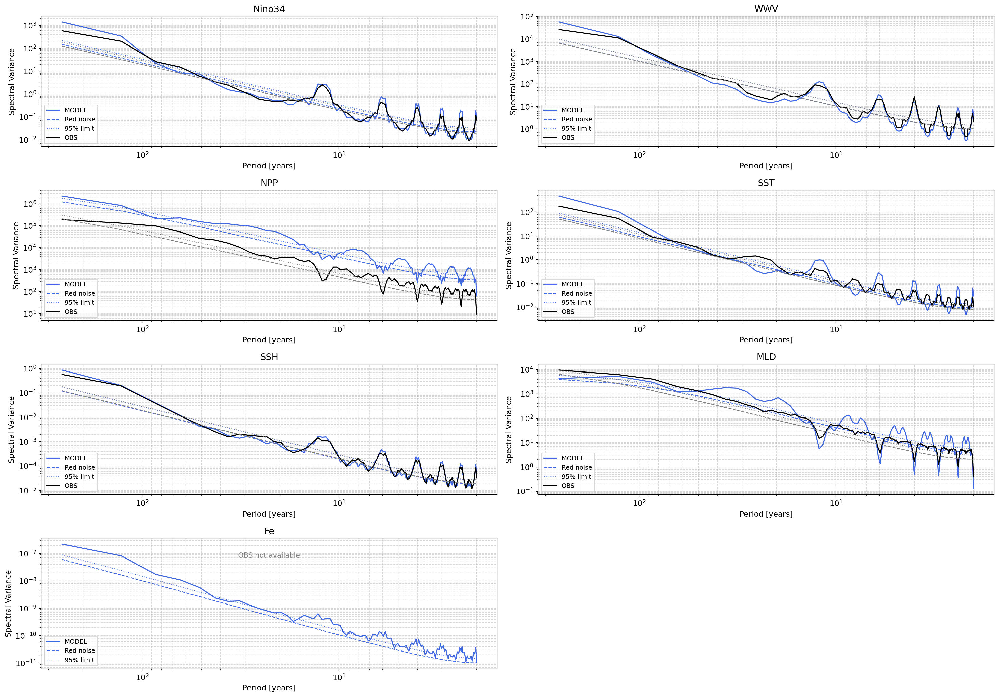

In [34]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
from scipy.signal import welch
from scipy.stats import chi2

# ---------------------------------------------------------
# Variable list
# ---------------------------------------------------------
var_list = ["Nino34","WWV","NPP","SST","SSH","MLD","Fe"]

# ---------------------------------------------------------
# Function: compute AR(1) red-noise spectrum and 95% CI
# ---------------------------------------------------------
def red_noise_spectrum(data, fs=1/12.0, nperseg=256):
    data = data - np.nanmean(data)
    data = data[np.isfinite(data)]
    f, Pxx = welch(data, fs=fs, nperseg=min(nperseg, len(data)//2))

    # lag-1 autocorrelation
    r1 = np.corrcoef(data[:-1], data[1:])[0, 1]
    # theoretical red-noise spectrum
    Sred = (1 - r1**2) / (1 + r1**2 - 2*r1*np.cos(2*np.pi*f/fs))
    Sred = Sred * np.var(data) * (1/fs)

    # 95% confidence limit (chi-square 2 dof)
    dof = 2 * len(data) / nperseg
    red95 = Sred * chi2.ppf(0.95, dof) / dof
    return f, Pxx, Sred, red95

# ---------------------------------------------------------
# Panel layout
# ---------------------------------------------------------
ncol = 2
nrow = int(np.ceil(len(var_list)/ncol))
fig, axes = plt.subplots(nrow, ncol, figsize=(20,14))
axes = axes.flatten()

for i, var in enumerate(var_list):
    ax = axes[i]

    # ---- MODEL ----
    if var in model_all:
        data_mod = (model_all[var] - model_all[var].groupby("time.month").mean("time")).dropna("time")
        f, Pxx, Sred, red95 = red_noise_spectrum(data_mod.values)

        # Convert frequency (1/month) → period (years)
        period = 1 / (f * 12)
        ax.loglog(period, Pxx, color="royalblue", label="MODEL")
        ax.loglog(period, Sred, color="royalblue", ls="--", lw=1.2, label="Red noise")
        ax.loglog(period, red95, color="royalblue", ls=":", lw=1.0, label="95% limit")

    # ---- OBS ----
    if var in obs_all:
        data_obs = (obs_all[var] - obs_all[var].groupby("time.month").mean("time")).dropna("time")
        f, Pxx, Sred, red95 = red_noise_spectrum(data_obs.values)
        period = 1 / (f * 12)
        ax.loglog(period, Pxx, color="black", label="OBS")
        ax.loglog(period, Sred, color="gray", ls="--", lw=1.2)
        ax.loglog(period, red95, color="gray", ls=":", lw=1.0)
    else:
        ax.text(0.5, 0.85, "OBS not available", fontsize=10,
                ha="center", transform=ax.transAxes, color="gray")

    # ---- Formatting ----
    ax.set_xlabel("Period [years]", fontsize=11)
    ax.set_ylabel("Spectral Variance", fontsize=11)
    ax.grid(True, which="both", ls="--", alpha=0.5)
    ax.set_title(var, fontsize=13)
    ax.tick_params(axis="both", labelsize=11)
    ax.legend(fontsize=9, loc="lower left")

    # Invert x-axis so longer periods (low frequency) appear on the left
    ax.invert_xaxis()

# Hide unused panels
for j in range(i+1, len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()


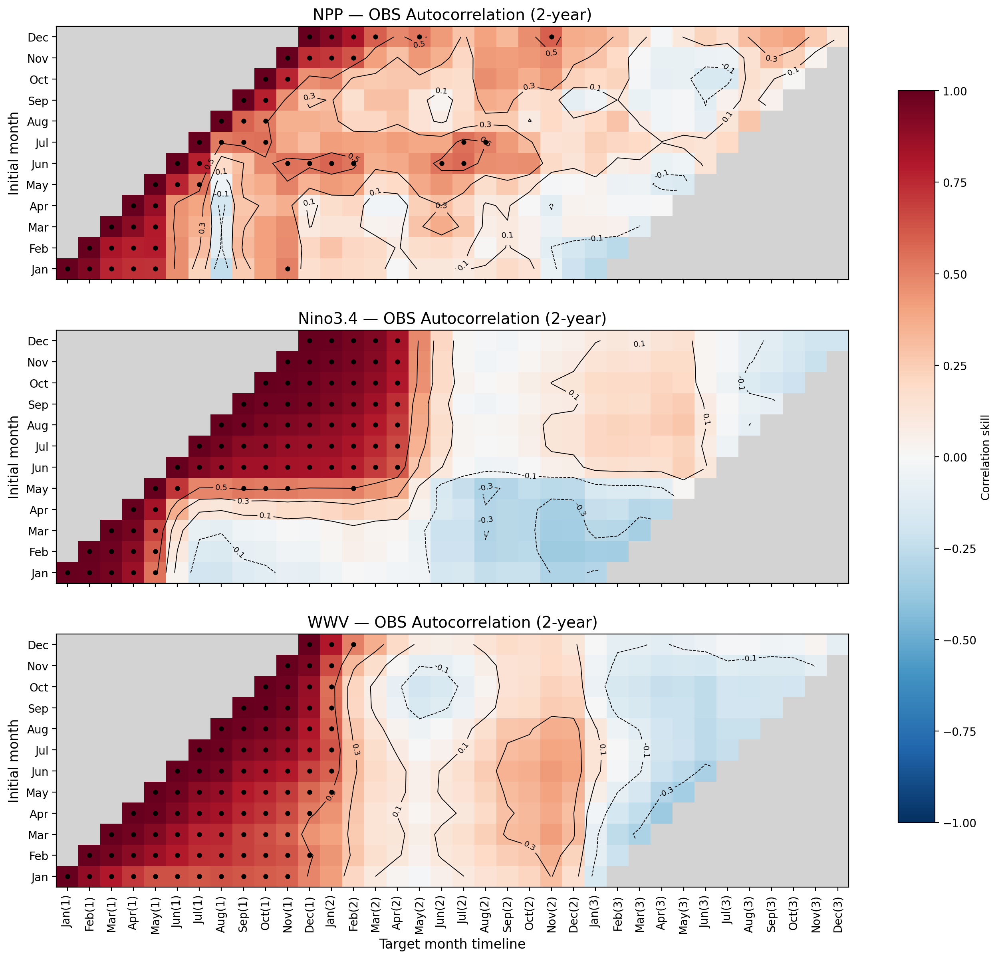

In [94]:
import numpy as np
import matplotlib.pyplot as plt

def oras_multiyear_shifted(da, month, max_lag=24):
    """
    ORAS5/XRO multiyear predictability map aligned by initial month,
    with left-side gray masking and 2-year target timeline.
    """
    m = month.values.astype(int)
    x = da.values
    N = len(x)

    # 1) persistence skill: 12 × (lag+1)
    pers = np.full((12, max_lag+1), np.nan)

    for init_m in range(1, 13):
        idx_init = np.where(m == init_m)[0]

        for lag in range(max_lag+1):
            idx_tgt = idx_init + lag
            idx_tgt = idx_tgt[idx_tgt < N]

            if len(idx_tgt) < 5:
                continue
            
            corr = np.corrcoef(
                x[idx_init[:len(idx_tgt)]],
                x[idx_tgt]
            )[0,1]

            pers[init_m-1, lag] = corr

    # 2) shifted ORAS-style matrix
    W = max_lag + 12   # 12-month shift + 24-month lag (2 years)
    skill = np.full((12, W), np.nan)

    for im in range(1, 13):
        shift = im - 1
        skill[im-1, shift:shift+max_lag+1] = pers[im-1, :]

    return skill


# ------------------------------------------------------
# Variables to plot (3-panel)
# ------------------------------------------------------
vars_to_plot = {
    "NPP": obs_all["NPP"],
    "Nino3.4": obs_all["Nino34"],
    "WWV": obs_all["WWV"],
}

month = obs_all["month"]
max_lag = 24

skills = {name: oras_multiyear_shifted(da, month, max_lag)
          for name, da in vars_to_plot.items()}

# ------------------------------------------------------
# Build target-month labels (2 years)
# ------------------------------------------------------
calendar = ["Jan","Feb","Mar","Apr","May","Jun","Jul",
            "Aug","Sep","Oct","Nov","Dec"]

labels = []
year = 1
for i in range(max_lag + 12):   # 12 month shift + 24 lags
    mo = i % 12
    if i > 0 and mo == 0:
        year += 1
    labels.append(f"{calendar[mo]}({year})")


# ------------------------------------------------------
# Panel plot (3 rows)
# ------------------------------------------------------
fig, axes = plt.subplots(3, 1, figsize=(16, 14), sharex=True)

cmap = plt.get_cmap("RdBu_r").copy()
cmap.set_bad(color='lightgray')

for ax, (name, skill) in zip(axes, skills.items()):

    masked = np.ma.masked_where(np.isnan(skill), skill)

    # --- main heatmap ---
    im = ax.imshow(
        masked, origin="lower", cmap=cmap,
        vmin=-1, vmax=1, aspect="auto"
    )

    # --- contour line ---
    contour_levels = [-0.5, -0.3, -0.1, 0.1, 0.3, 0.5]
    CS = ax.contour(
        masked, levels=contour_levels,
        colors='black', linewidths=0.7
    )
    ax.clabel(CS, fmt='%0.1f', fontsize=7)

    # --- dot marker where correlation >= 0.5 ---
    yy, xx = np.where(skill >= 0.5)
    ax.scatter(xx, yy, s=12, color='black', marker='o')

    ax.set_yticks(np.arange(12))
    ax.set_yticklabels(calendar)

    ax.set_ylabel("Initial month", fontsize=12)
    ax.set_title(f"{name} — OBS Autocorrelation (2-year)", fontsize=14)

# Shared x-axis
axes[-1].set_xticks(np.arange(len(labels)))
axes[-1].set_xticklabels(labels, rotation=90)
axes[-1].set_xlabel("Target month timeline", fontsize=12)

# Single colorbar
cbar = fig.colorbar(im, ax=axes.ravel().tolist(), shrink=0.85,
                    label="Correlation skill")

# plt.tight_layout()
plt.show()


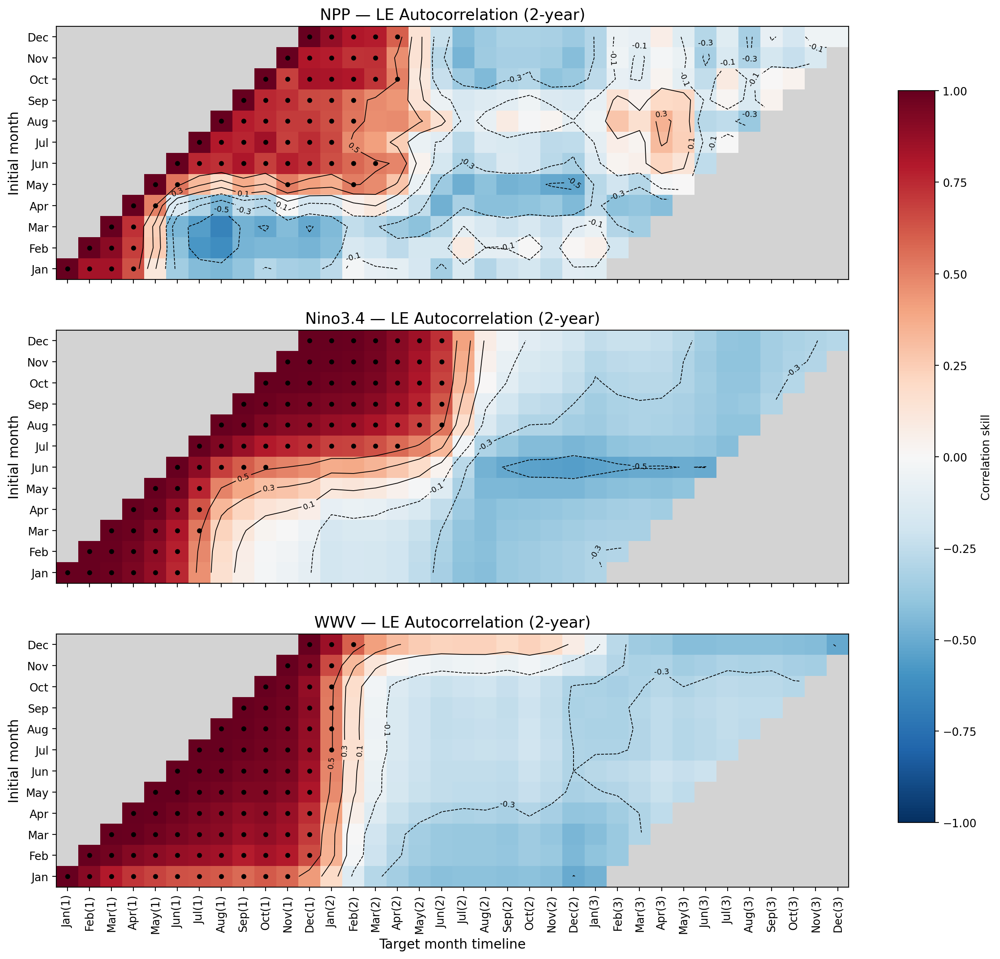

In [92]:
import numpy as np
import matplotlib.pyplot as plt

def oras_multiyear_shifted(da, month, max_lag=24):
    """
    ORAS5/XRO multiyear predictability map aligned by initial month,
    with left-side gray masking and 2-year target timeline.
    """
    m = month.values.astype(int)
    x = da.values
    N = len(x)

    # 1) persistence skill: 12 × (lag+1)
    pers = np.full((12, max_lag+1), np.nan)

    for init_m in range(1, 13):
        idx_init = np.where(m == init_m)[0]

        for lag in range(max_lag+1):
            idx_tgt = idx_init + lag
            idx_tgt = idx_tgt[idx_tgt < N]

            if len(idx_tgt) < 5:
                continue
            
            corr = np.corrcoef(
                x[idx_init[:len(idx_tgt)]],
                x[idx_tgt]
            )[0,1]

            pers[init_m-1, lag] = corr

    # 2) shifted ORAS-style matrix
    W = max_lag + 12   # 12-month shift + 24-month lag (2 years)
    skill = np.full((12, W), np.nan)

    for im in range(1, 13):
        shift = im - 1
        skill[im-1, shift:shift+max_lag+1] = pers[im-1, :]

    return skill


# ------------------------------------------------------
# Variables to plot (3-panel)
# ------------------------------------------------------
vars_to_plot = {
    "NPP": model_all["NPP"],
    "Nino3.4": model_all["Nino34"],
    "WWV": model_all["WWV"],
}

month = obs_all["month"]
max_lag = 24

skills = {name: oras_multiyear_shifted(da, month, max_lag)
          for name, da in vars_to_plot.items()}

# ------------------------------------------------------
# Build target-month labels (2 years)
# ------------------------------------------------------
calendar = ["Jan","Feb","Mar","Apr","May","Jun","Jul",
            "Aug","Sep","Oct","Nov","Dec"]

labels = []
year = 1
for i in range(max_lag + 12):   # 12 month shift + 24 lags
    mo = i % 12
    if i > 0 and mo == 0:
        year += 1
    labels.append(f"{calendar[mo]}({year})")


# ------------------------------------------------------
# Panel plot (3 rows)
# ------------------------------------------------------
fig, axes = plt.subplots(3, 1, figsize=(16, 14), sharex=True)

cmap = plt.get_cmap("RdBu_r").copy()
cmap.set_bad(color='lightgray')

for ax, (name, skill) in zip(axes, skills.items()):

    masked = np.ma.masked_where(np.isnan(skill), skill)

    # --- main heatmap ---
    im = ax.imshow(
        masked, origin="lower", cmap=cmap,
        vmin=-1, vmax=1, aspect="auto"
    )

    # --- contour line ---
    contour_levels = [-0.5, -0.3, -0.1, 0.1, 0.3, 0.5]
    CS = ax.contour(
        masked, levels=contour_levels,
        colors='black', linewidths=0.7
    )
    ax.clabel(CS, fmt='%0.1f', fontsize=7)

    # --- dot marker where correlation >= 0.5 ---
    yy, xx = np.where(skill >= 0.5)
    ax.scatter(xx, yy, s=12, color='black', marker='o')

    ax.set_yticks(np.arange(12))
    ax.set_yticklabels(calendar)

    ax.set_ylabel("Initial month", fontsize=12)
    ax.set_title(f"{name} — LE Autocorrelation (2-year)", fontsize=14)

# Shared x-axis
axes[-1].set_xticks(np.arange(len(labels)))
axes[-1].set_xticklabels(labels, rotation=90)
axes[-1].set_xlabel("Target month timeline", fontsize=12)

# Single colorbar
cbar = fig.colorbar(im, ax=axes.ravel().tolist(), shrink=0.85,
                    label="Correlation skill")

# plt.tight_layout()
plt.show()


In [78]:
def calc_forecast_skill(fcst_ds, ref_ds, metric='acc', is_mv3=True, comparison="e2o", 
                        by_month=True, verify_periods=slice('1998-01', '2023-12')):
    try:
        fcst_ds = fcst_ds.squeeze().drop('member')
    except:
        pass

    if is_mv3:
        fcst_ds = fcst_ds.rolling(init=3, center=True, min_periods=1).mean('init')
        ref_mv3 = ref_ds.rolling(time=3, center=True, min_periods=1).mean().dropna(dim='time')
    else:
        ref_mv3 = ref_ds

    hc_XRO = HindcastEnsemble(fcst_ds.sel(init=verify_periods))
    hc_XRO = hc_XRO.add_observations(ref_mv3)
    if by_month:
        skill_XRO = hc_XRO.verify(metric=metric, comparison=comparison, alignment="maximize", dim=["init"], skipna=True, groupby='month')
    else:
        skill_XRO = hc_XRO.verify(metric=metric, comparison=comparison, alignment="maximize", dim=["init"], skipna=True)
        # skill_raw = hc_XRO.verify(metric=metric, comparison=comparison, alignment="maximize", dim=[ ], skipna=True)
    try:
        del skill_XRO.attrs['skipna']
        skill_XRO = skill_XRO.drop('skill')
    except:
        pass

    for var in skill_XRO.data_vars:
        if var != 'model':
            skill_XRO[var].encoding['dtype'] = 'float32'
            skill_XRO[var].encoding['_FillValue'] = 1e20
    return skill_XRO

In [71]:
def calc_forecast_skill_full(fcst_ds, ref_ds, metric='acc', is_mv3=True,
                             comparison="e2o", verify_periods=slice('1998-01', '2023-12')):
    from climpred import HindcastEnsemble
    import numpy as np
    import xarray as xr

    # 1️⃣ optional smoothing
    try:
        fcst_ds = fcst_ds.squeeze().drop('member')
    except Exception:
        pass

    if is_mv3:
        fcst_ds = fcst_ds.rolling(init=3, center=True, min_periods=1).mean('init')
        ref_ds  = ref_ds.rolling(time=3, center=True, min_periods=1).mean().dropna(dim='time')

    # 2️⃣ setup
    hc = HindcastEnsemble(fcst_ds.sel(init=verify_periods))
    hc = hc.add_observations(ref_ds)

    fcst = hc._datasets["initialized"]
    obs  = hc._datasets["observations"]

    leads = fcst["lead"].values
    vars_ = [v for v in fcst.data_vars if v != 'member']

    result_mean = xr.Dataset()
    result_std  = xr.Dataset()

    for v in vars_:
        mean_list, std_list = [], []
        for L in leads:
            f = fcst[v].sel(lead=L).dropna("init")
            o = obs[v].dropna("time")

            init_times = f["init"].values
            skill_vals = []

            for it in init_times:
                try:
                    ftmp = f.sel(init=it)
                    otmp = o.sel(time=slice(it, it + np.timedelta64(int(L), "M")))

                    if metric == "acc":
                        skill_val = xr.corr(ftmp, otmp, dim="time").values
                    elif metric == "rmse":
                        diff = (ftmp - otmp) ** 2
                        skill_val = np.sqrt(diff.mean().values)
                    elif metric == "bias":
                        skill_val = (ftmp - otmp).mean().values
                    else:
                        raise ValueError(f"Unsupported metric: {metric}")

                    skill_vals.append(skill_val)

                except Exception:
                    pass

            # 평균 및 표준편차
            mean_list.append(np.nanmean(skill_vals))
            std_list.append(np.nanstd(skill_vals))

        result_mean[v] = xr.DataArray(mean_list, dims=["lead"], coords={"lead": leads})
        result_std[v]  = xr.DataArray(std_list, dims=["lead"], coords={"lead": leads})

    # 3️⃣ merge std variables
    for v in vars_:
        result_mean[f"{v}_std"] = result_std[v]

    return result_mean


In [44]:
slice_train = slice('1998-01', '2023-12')
slice_verif = slice('1998-01', '2023-12')
XRO_ac1 = XRO(ncycle=12, ac_order=1, is_forward=True)
XRO_ann = XRO(ncycle=12, ac_order=0, is_forward=True)
XRO_NPP_ac1 = XRO(ncycle=12, ac_order=1, is_forward=True)
XRO_NPP_ac2 = XRO(ncycle=12, ac_order=2, is_forward=True)

obs_XRO_NPP_ds = obs_ds_with_npp[['Nino34', 'WWV', 'NPMM', 'SPMM', 'IOB', 'IOD', 'SIOD', 'TNA', 'ATL3', 'SASD', 'NPP']]


In [87]:
# OBS control run

OBS_fit_XRO_NPP = XRO_NPP_ac2.fit_matrix(obs_all.sel(time=slice_train), maskNT=['T2', 'TH'], maskNH=['T2'], maskb=['IOD'])

OBS_XRO_NPP_fcst = XRO_NPP_ac2.reforecast(fit_ds=OBS_fit_XRO_NPP, init_ds=obs_all.sel(time=slice_verif), n_month=24, ncopy=1, noise_type='zero')

OBS_acc_XRO_NPP = calc_forecast_skill(OBS_XRO_NPP_fcst, obs_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))
OBS_acc_mon_XRO_NPP = calc_forecast_skill(OBS_XRO_NPP_fcst, obs_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=True, verify_periods=slice('1998-01', '2023-12'))
OBS_rmse_XRO_NPP = calc_forecast_skill(OBS_XRO_NPP_fcst, obs_all.sel(time=slice_verif), 
                                           metric='rmse', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))

# OBS_acc_XRO_NPP = calc_forecast_skill_full(OBS_XRO_NPP_fcst, obs_all.sel(time=slice_verif), 
#                                           metric='acc', is_mv3=True,  verify_periods=slice('1998-01', '2023-12'))

# OBS_rmse_XRO_NPP = calc_forecast_skill_full(OBS_XRO_NPP_fcst, obs_all.sel(time=slice_verif), 
#                                            metric='rmse', is_mv3=True,  verify_periods=slice('1998-01', '2023-12'))

# OBS (Nino uninitialized)

obs_U_nino = obs_all.copy()
obs_U_nino["Nino34"] = xr.zeros_like(obs_all["Nino34"])
obs_U_nino["WWV"]    = xr.zeros_like(obs_all["WWV"])

OBS_XRO_NPP_fcst_U_nino = XRO_NPP_ac2.reforecast(fit_ds=OBS_fit_XRO_NPP, init_ds=obs_U_nino.sel(time=slice_verif), n_month=24, ncopy=1, noise_type='zero')

OBS_acc_XRO_NPP_U_nino = calc_forecast_skill(OBS_XRO_NPP_fcst_U_nino, obs_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))
OBS_acc_mon_XRO_NPP_U_nino = calc_forecast_skill(OBS_XRO_NPP_fcst_U_nino, obs_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=True, verify_periods=slice('1998-01', '2023-12'))

OBS_rmse_XRO_NPP_U_nino = calc_forecast_skill(OBS_XRO_NPP_fcst_U_nino, obs_all.sel(time=slice_verif), 
                                           metric='rmse', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))

# OBS (EXPO, IO, AO uninitialized)

obs_U_ext = obs_all.copy()
# obs_U_ext["Nino34"] = xr.zeros_like(obs_all["Nino34"])
# obs_U_ext["WWV"]    = xr.zeros_like(obs_all["WWV"])
obs_U_ext["NPMM"]   = xr.zeros_like(obs_all["NPMM"])
obs_U_ext["SPMM"]   = xr.zeros_like(obs_all["SPMM"])
obs_U_ext["IOB"]    = xr.zeros_like(obs_all["IOB"])
obs_U_ext["IOD"]    = xr.zeros_like(obs_all["IOD"])
obs_U_ext["SIOD"]   = xr.zeros_like(obs_all["SIOD"])
obs_U_ext["TNA"]    = xr.zeros_like(obs_all["TNA"])
obs_U_ext["ATL3"]   = xr.zeros_like(obs_all["ATL3"])
obs_U_ext["SASD"]   = xr.zeros_like(obs_all["SASD"])
# obs_U_ext["SST"]    = xr.zeros_like(obs_all["SST"])
# obs_U_ext["NPP"]    = xr.zeros_like(obs_all["NPP"])
# obs_U_ext["SSH"]    = xr.zeros_like(obs_all["SSH"])
# obs_U_ext["MLD"]    = xr.zeros_like(obs_all["MLD"])

OBS_XRO_NPP_fcst_U_ext = XRO_NPP_ac2.reforecast(fit_ds=OBS_fit_XRO_NPP, init_ds=obs_U_ext.sel(time=slice_verif), n_month=24, ncopy=1, noise_type='zero')

OBS_acc_XRO_NPP_U_ext = calc_forecast_skill(OBS_XRO_NPP_fcst_U_ext, obs_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))
OBS_acc_mon_XRO_NPP_U_ext = calc_forecast_skill(OBS_XRO_NPP_fcst_U_ext, obs_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=True, verify_periods=slice('1998-01', '2023-12'))
OBS_rmse_XRO_NPP_U_ext = calc_forecast_skill(OBS_XRO_NPP_fcst_U_ext, obs_all.sel(time=slice_verif), 
                                           metric='rmse', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))

# OBS (NPP uninitialized)

obs_U_npp = obs_all.copy()
# obs_U_npp["Nino34"] = xr.zeros_like(obs_all["Nino34"])
# obs_U_npp["WWV"]    = xr.zeros_like(obs_all["WWV"])
# obs_U_npp["NPMM"]   = xr.zeros_like(obs_all["NPMM"])
# obs_U_npp["SPMM"]   = xr.zeros_like(obs_all["SPMM"])
# obs_U_npp["IOB"]    = xr.zeros_like(obs_all["IOB"])
# obs_U_npp["IOD"]    = xr.zeros_like(obs_all["IOD"])
# obs_U_npp["SIOD"]   = xr.zeros_like(obs_all["SIOD"])
# obs_U_npp["TNA"]    = xr.zeros_like(obs_all["TNA"])
# obs_U_npp["ATL3"]   = xr.zeros_like(obs_all["ATL3"])
# obs_U_npp["SASD"]   = xr.zeros_like(obs_all["SASD"])
# obs_U_npp["SST"]    = xr.zeros_like(obs_all["SST"])
obs_U_npp["NPP"]    = xr.zeros_like(obs_all["NPP"])
# obs_U_npp["SSH"]    = xr.zeros_like(obs_all["SSH"])
# obs_U_npp["MLD"]    = xr.zeros_like(obs_all["MLD"])

OBS_XRO_NPP_fcst_U_npp = XRO_NPP_ac2.reforecast(fit_ds=OBS_fit_XRO_NPP, init_ds=obs_U_npp.sel(time=slice_verif), n_month=24, ncopy=1, noise_type='zero')

OBS_acc_XRO_NPP_U_npp = calc_forecast_skill(OBS_XRO_NPP_fcst_U_npp, obs_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))
OBS_acc_mon_XRO_NPP_U_npp = calc_forecast_skill(OBS_XRO_NPP_fcst_U_npp, obs_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=True, verify_periods=slice('1998-01', '2023-12'))
OBS_rmse_XRO_NPP_U_npp = calc_forecast_skill(OBS_XRO_NPP_fcst_U_npp, obs_all.sel(time=slice_verif), 
                                           metric='rmse', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))

# OBS (local uninitialized)

obs_U_local = obs_all.copy()
# obs_U_local["Nino34"] = xr.zeros_like(obs_all["Nino34"])
# obs_U_local["WWV"]    = xr.zeros_like(obs_all["WWV"])
# obs_U_local["NPMM"]   = xr.zeros_like(obs_all["NPMM"])
# obs_U_local["SPMM"]   = xr.zeros_like(obs_all["SPMM"])
# obs_U_local["IOB"]    = xr.zeros_like(obs_all["IOB"])
# obs_U_local["IOD"]    = xr.zeros_like(obs_all["IOD"])
# obs_U_local["SIOD"]   = xr.zeros_like(obs_all["SIOD"])
# obs_U_local["TNA"]    = xr.zeros_like(obs_all["TNA"])
# obs_U_local["ATL3"]   = xr.zeros_like(obs_all["ATL3"])
# obs_U_local["SASD"]   = xr.zeros_like(obs_all["SASD"])
obs_U_local["SST"]    = xr.zeros_like(obs_all["SST"])
# obs_U_local["NPP"]    = xr.zeros_like(obs_all["NPP"])
obs_U_local["SSH"]    = xr.zeros_like(obs_all["SSH"])
obs_U_local["MLD"]    = xr.zeros_like(obs_all["MLD"])

OBS_XRO_NPP_fcst_U_local = XRO_NPP_ac2.reforecast(fit_ds=OBS_fit_XRO_NPP, init_ds=obs_U_local.sel(time=slice_verif), n_month=24, ncopy=1, noise_type='zero')

OBS_acc_XRO_NPP_U_local = calc_forecast_skill(OBS_XRO_NPP_fcst_U_local, obs_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))
OBS_acc_mon_XRO_NPP_U_local = calc_forecast_skill(OBS_XRO_NPP_fcst_U_local, obs_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=True, verify_periods=slice('1998-01', '2023-12'))
OBS_rmse_XRO_NPP_U_local = calc_forecast_skill(OBS_XRO_NPP_fcst_U_local, obs_all.sel(time=slice_verif), 
                                           metric='rmse', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))


In [100]:
# MOD control run

MOD_fit_XRO_NPP = XRO_NPP_ac2.fit_matrix(model_all.sel(time=slice_train), maskNT=['T2', 'TH'], maskNH=['T2'], maskb=['IOD'])

MOD_XRO_NPP_fcst = XRO_NPP_ac2.reforecast(fit_ds=MOD_fit_XRO_NPP, init_ds=model_all.sel(time=slice_verif), n_month=24, ncopy=1, noise_type='zero')

MOD_acc_XRO_NPP = calc_forecast_skill(MOD_XRO_NPP_fcst, model_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))
MOD_acc_mon_XRO_NPP = calc_forecast_skill(MOD_XRO_NPP_fcst, model_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=True, verify_periods=slice('1998-01', '2023-12'))
MOD_rmse_XRO_NPP = calc_forecast_skill(MOD_XRO_NPP_fcst, model_all.sel(time=slice_verif), 
                                           metric='rmse', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))

# MOD_acc_XRO_NPP = calc_forecast_skill_full(MOD_XRO_NPP_fcst, model_all.sel(time=slice_verif), 
#                                           metric='acc', is_mv3=True,  verify_periods=slice('1998-01', '2023-12'))

# MOD_rmse_XRO_NPP = calc_forecast_skill_full(MOD_XRO_NPP_fcst, model_all.sel(time=slice_verif), 
#                                            metric='rmse', is_mv3=True,  verify_periods=slice('1998-01', '2023-12'))

# MOD (Nino uninitialized)

model_U_nino = model_all.copy()
model_U_nino["Nino34"] = xr.zeros_like(model_all["Nino34"])
model_U_nino["WWV"]    = xr.zeros_like(model_all["WWV"])

MOD_XRO_NPP_fcst_U_nino = XRO_NPP_ac2.reforecast(fit_ds=MOD_fit_XRO_NPP, init_ds=model_U_nino.sel(time=slice_verif), n_month=24, ncopy=1, noise_type='zero')

MOD_acc_XRO_NPP_U_nino = calc_forecast_skill(MOD_XRO_NPP_fcst_U_nino, model_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))
MOD_acc_mon_XRO_NPP_U_nino = calc_forecast_skill(MOD_XRO_NPP_fcst_U_nino, model_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=True, verify_periods=slice('1998-01', '2023-12'))

MOD_rmse_XRO_NPP_U_nino = calc_forecast_skill(MOD_XRO_NPP_fcst_U_nino, model_all.sel(time=slice_verif), 
                                           metric='rmse', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))

# MOD (EXPO, IO, AO uninitialized)

model_U_ext = model_all.copy()
# model_U_ext["Nino34"] = xr.zeros_like(model_all["Nino34"])
# model_U_ext["WWV"]    = xr.zeros_like(model_all["WWV"])
model_U_ext["NPMM"]   = xr.zeros_like(model_all["NPMM"])
model_U_ext["SPMM"]   = xr.zeros_like(model_all["SPMM"])
model_U_ext["IOB"]    = xr.zeros_like(model_all["IOB"])
model_U_ext["IOD"]    = xr.zeros_like(model_all["IOD"])
model_U_ext["SIOD"]   = xr.zeros_like(model_all["SIOD"])
model_U_ext["TNA"]    = xr.zeros_like(model_all["TNA"])
model_U_ext["ATL3"]   = xr.zeros_like(model_all["ATL3"])
model_U_ext["SASD"]   = xr.zeros_like(model_all["SASD"])
# model_U_ext["SST"]    = xr.zeros_like(model_all["SST"])
# model_U_ext["NPP"]    = xr.zeros_like(model_all["NPP"])
# model_U_ext["SSH"]    = xr.zeros_like(model_all["SSH"])
# model_U_ext["MLD"]    = xr.zeros_like(model_all["MLD"])

MOD_XRO_NPP_fcst_U_ext = XRO_NPP_ac2.reforecast(fit_ds=MOD_fit_XRO_NPP, init_ds=model_U_ext.sel(time=slice_verif), n_month=24, ncopy=1, noise_type='zero')

MOD_acc_XRO_NPP_U_ext = calc_forecast_skill(MOD_XRO_NPP_fcst_U_ext, model_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))
MOD_acc_mon_XRO_NPP_U_ext = calc_forecast_skill(MOD_XRO_NPP_fcst_U_ext, model_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=True, verify_periods=slice('1998-01', '2023-12'))
MOD_rmse_XRO_NPP_U_ext = calc_forecast_skill(MOD_XRO_NPP_fcst_U_ext, model_all.sel(time=slice_verif), 
                                           metric='rmse', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))

# MOD (NPP uninitialized)

model_U_npp = model_all.copy()
# model_U_npp["Nino34"] = xr.zeros_like(model_all["Nino34"])
# model_U_npp["WWV"]    = xr.zeros_like(model_all["WWV"])
# model_U_npp["NPMM"]   = xr.zeros_like(model_all["NPMM"])
# model_U_npp["SPMM"]   = xr.zeros_like(model_all["SPMM"])
# model_U_npp["IOB"]    = xr.zeros_like(model_all["IOB"])
# model_U_npp["IOD"]    = xr.zeros_like(model_all["IOD"])
# model_U_npp["SIOD"]   = xr.zeros_like(model_all["SIOD"])
# model_U_npp["TNA"]    = xr.zeros_like(model_all["TNA"])
# model_U_npp["ATL3"]   = xr.zeros_like(model_all["ATL3"])
# model_U_npp["SASD"]   = xr.zeros_like(model_all["SASD"])
# model_U_npp["SST"]    = xr.zeros_like(model_all["SST"])
model_U_npp["NPP"]    = xr.zeros_like(model_all["NPP"])
# model_U_npp["SSH"]    = xr.zeros_like(model_all["SSH"])
# model_U_npp["MLD"]    = xr.zeros_like(model_all["MLD"])

MOD_XRO_NPP_fcst_U_npp = XRO_NPP_ac2.reforecast(fit_ds=MOD_fit_XRO_NPP, init_ds=model_U_npp.sel(time=slice_verif), n_month=24, ncopy=1, noise_type='zero')

MOD_acc_XRO_NPP_U_npp = calc_forecast_skill(MOD_XRO_NPP_fcst_U_npp, model_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))
MOD_acc_mon_XRO_NPP_U_npp = calc_forecast_skill(MOD_XRO_NPP_fcst_U_npp, model_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=True, verify_periods=slice('1998-01', '2023-12'))
MOD_rmse_XRO_NPP_U_npp = calc_forecast_skill(MOD_XRO_NPP_fcst_U_npp, model_all.sel(time=slice_verif), 
                                           metric='rmse', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))

# MOD (local uninitialized)

model_U_local = model_all.copy()
# model_U_local["Nino34"] = xr.zeros_like(model_all["Nino34"])
# model_U_local["WWV"]    = xr.zeros_like(model_all["WWV"])
# model_U_local["NPMM"]   = xr.zeros_like(model_all["NPMM"])
# model_U_local["SPMM"]   = xr.zeros_like(model_all["SPMM"])
# model_U_local["IOB"]    = xr.zeros_like(model_all["IOB"])
# model_U_local["IOD"]    = xr.zeros_like(model_all["IOD"])
# model_U_local["SIOD"]   = xr.zeros_like(model_all["SIOD"])
# model_U_local["TNA"]    = xr.zeros_like(model_all["TNA"])
# model_U_local["ATL3"]   = xr.zeros_like(model_all["ATL3"])
# model_U_local["SASD"]   = xr.zeros_like(model_all["SASD"])
model_U_local["SST"]    = xr.zeros_like(model_all["SST"])
# model_U_local["NPP"]    = xr.zeros_like(model_all["NPP"])
model_U_local["SSH"]    = xr.zeros_like(model_all["SSH"])
model_U_local["MLD"]    = xr.zeros_like(model_all["MLD"])

MOD_XRO_NPP_fcst_U_local = XRO_NPP_ac2.reforecast(fit_ds=MOD_fit_XRO_NPP, init_ds=model_U_local.sel(time=slice_verif), n_month=24, ncopy=1, noise_type='zero')

MOD_acc_XRO_NPP_U_local = calc_forecast_skill(MOD_XRO_NPP_fcst_U_local, model_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))
MOD_acc_mon_XRO_NPP_U_local = calc_forecast_skill(MOD_XRO_NPP_fcst_U_local, model_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=True, verify_periods=slice('1998-01', '2023-12'))
MOD_rmse_XRO_NPP_U_local = calc_forecast_skill(MOD_XRO_NPP_fcst_U_local, model_all.sel(time=slice_verif), 
                                           metric='rmse', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))

# MOD (Nutrient uninitialized)

model_U_nut = model_all.copy()
model_U_nut["Fe"]    = xr.zeros_like(model_all["Fe"])

MOD_XRO_NPP_fcst_U_nut = XRO_NPP_ac2.reforecast(fit_ds=MOD_fit_XRO_NPP, init_ds=model_U_nut.sel(time=slice_verif), n_month=24, ncopy=1, noise_type='zero')

MOD_acc_XRO_NPP_U_nut = calc_forecast_skill(MOD_XRO_NPP_fcst_U_nut, model_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))
MOD_acc_mon_XRO_NPP_U_nut = calc_forecast_skill(MOD_XRO_NPP_fcst_U_nut, model_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=True, verify_periods=slice('1998-01', '2023-12'))
MOD_rmse_XRO_NPP_U_nut = calc_forecast_skill(MOD_XRO_NPP_fcst_U_nut, model_all.sel(time=slice_verif), 
                                           metric='rmse', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))


In [121]:
 model_all

<xarray.Dataset> Size: 34kB
Dimensions:  (time: 312)
Coordinates:
    ens_LE   int64 8B 0
    month    (time) int64 2kB 1 2 3 4 5 6 7 8 9 10 11 ... 3 4 5 6 7 8 9 10 11 12
  * time     (time) datetime64[ns] 2kB 1998-01-01 1998-02-01 ... 2023-12-01
Data variables: (12/15)
    ATL3     (time) float32 1kB -0.5262 -0.3542 -0.3116 ... -0.4799 -0.66
    Nino34   (time) float32 1kB 1.125 1.073 0.9869 ... -1.706 -2.059 -2.087
    IOB      (time) float32 1kB -0.04865 -0.03409 -0.06281 ... -0.2762 -0.536
    IOD      (time) float64 2kB 0.2019 -0.001317 -0.06754 ... -1.964 -1.277
    NPMM     (time) float32 1kB 0.5614 0.7964 0.7415 ... -0.2981 -0.05504 0.1242
    SASD     (time) float64 2kB -1.063 -1.507 -1.204 ... -0.06205 -0.149
    ...       ...
    WWV      (time) float32 1kB 1.282 2.263 2.701 1.582 ... 10.6 9.742 12.11
    SST      (time) float64 2kB 0.7171 0.6704 0.8445 ... -1.821 -2.026 -2.063
    NPP      (time) float64 2kB -1.045 30.28 4.239 ... -110.6 -34.5 -3.563
    SSH      (time) float64 2kB 0.03204 0.03437 0.04504 ... -0.05581 -0.05267
    MLD      (time) float64 2kB -0.06342 -1.49 -4.833 ... 9.124 3.054 4.371
    Fe       (time) float64 2kB -1.139e-06 -3.391e-07 ... 3.384e-05 2.62e-05

In [122]:
# MOD control run to predict OBS

model_obs_all = model_all[['Nino34', 'WWV', 'NPMM', 'SPMM', 'IOB', 'IOD', 'SIOD', 'TNA', 'ATL3', 'SASD', 'SST', 'NPP', 'SSH', 'MLD']]


MOD_OBS_fit_XRO_NPP = XRO_NPP_ac2.fit_matrix(model_obs_all.sel(time=slice_train), maskNT=['T2', 'TH'], maskNH=['T2'], maskb=['IOD'])

MOD_OBS_XRO_NPP_fcst = XRO_NPP_ac2.reforecast(fit_ds=MOD_OBS_fit_XRO_NPP, init_ds=obs_all.sel(time=slice_verif), n_month=24, ncopy=1, noise_type='zero')

MOD_OBS_acc_XRO_NPP = calc_forecast_skill(MOD_OBS_XRO_NPP_fcst, obs_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))
MOD_OBS_acc_mon_XRO_NPP = calc_forecast_skill(MOD_OBS_XRO_NPP_fcst, obs_all.sel(time=slice_verif), 
                                          metric='acc', is_mv3=True, by_month=True, verify_periods=slice('1998-01', '2023-12'))
MOD_OBS_rmse_XRO_NPP = calc_forecast_skill(MOD_OBS_XRO_NPP_fcst, obs_all.sel(time=slice_verif), 
                                           metric='rmse', is_mv3=True, by_month=False, verify_periods=slice('1998-01', '2023-12'))



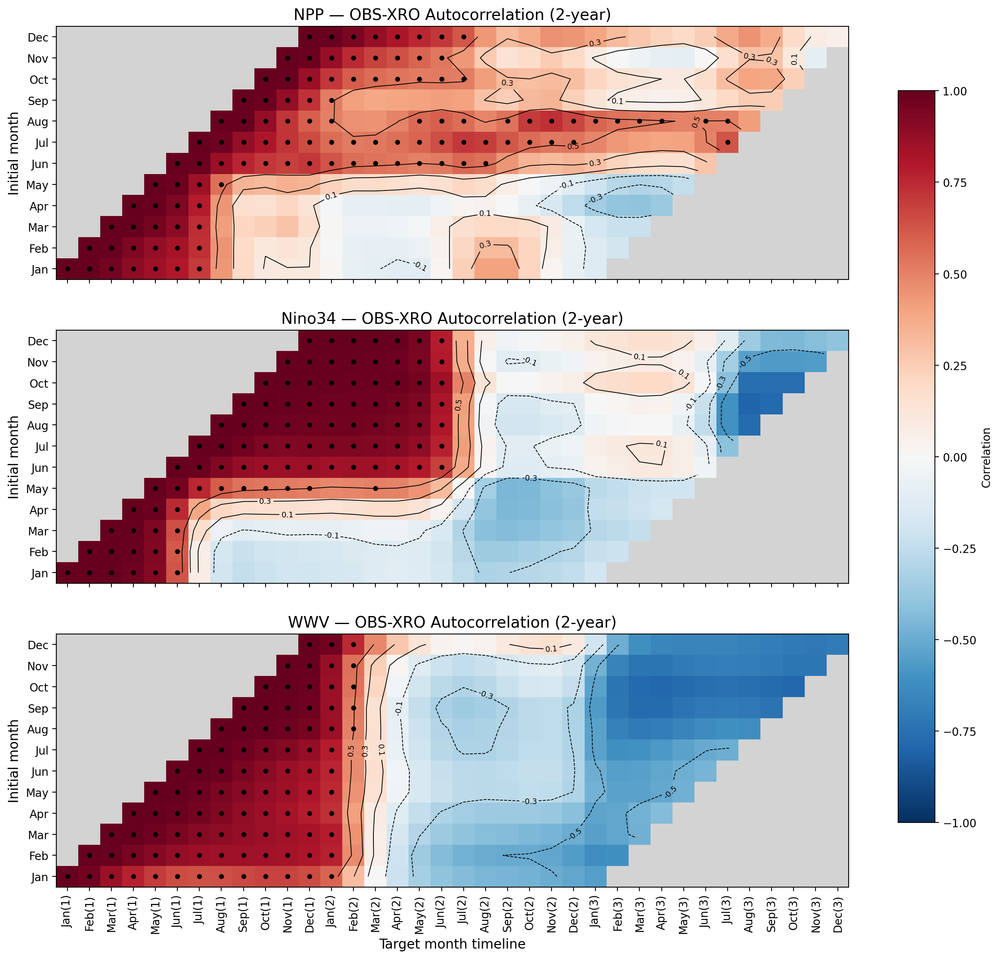

In [95]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

def oras_multiyear_from_forecast(ds, varname, max_lag=24):
    """
    Compute ORAS-style multiyear predictability (autocorrelation) map
    from forecast dataset with (init, lead) structure.
    """
    # Extract variable and relevant coordinates
    da = ds[varname]
    month = ds["month"].values.astype(int)
    leads = da["lead"].values
    n_init = da.sizes["init"]
    
    # 1) Correlation: 12 × (lag+1)
    pers = np.full((12, max_lag+1), np.nan)

    # Loop over initial month
    for init_m in range(1, 13):
        idx_init = np.where(month == init_m)[0]

        for lag in range(max_lag+1):
            # check if we can shift leads without going out of bounds
            if lag >= len(leads):
                continue
            valid_idx = idx_init[idx_init + lag < n_init]

            if len(valid_idx) < 5:
                continue

            # Flatten along lead axis: use all available forecast points
            x = da[valid_idx, 0].values  # lead 0 values
            y = da[valid_idx, lag].values

            if np.all(np.isnan(x)) or np.all(np.isnan(y)):
                continue

            corr = np.corrcoef(x, y)[0, 1]
            pers[init_m - 1, lag] = corr

    # 2) Shifted ORAS-style matrix
    W = max_lag + 12
    skill = np.full((12, W), np.nan)
    for im in range(1, 13):
        shift = im - 1
        skill[im - 1, shift:shift + max_lag + 1] = pers[im - 1, :]

    return skill

# =========================================================
# Example usage
# =========================================================
max_lag = 24
vars_to_plot = ["NPP", "Nino34", "WWV"]

skills = {v: oras_multiyear_from_forecast(OBS_XRO_NPP_fcst, v, max_lag=max_lag)
          for v in vars_to_plot}

# =========================================================
# Plot
# =========================================================
calendar = ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug",
            "Sep","Oct","Nov","Dec"]

labels = []
year = 1
for i in range(max_lag + 12):
    mo = i % 12
    if i > 0 and mo == 0:
        year += 1
    labels.append(f"{calendar[mo]}({year})")

fig, axes = plt.subplots(len(vars_to_plot), 1, figsize=(16, 14), sharex=True)
cmap = plt.get_cmap("RdBu_r").copy()
cmap.set_bad(color='lightgray')

for ax, name in zip(axes, vars_to_plot):
    skill = skills[name]
    masked = np.ma.masked_where(np.isnan(skill), skill)

    im = ax.imshow(masked, origin="lower", cmap=cmap, vmin=-1, vmax=1, aspect="auto")

    # Contour lines
    levels = [-0.5, -0.3, -0.1, 0.1, 0.3, 0.5]
    CS = ax.contour(masked, levels=levels, colors='black', linewidths=0.7)
    ax.clabel(CS, fmt='%0.1f', fontsize=7)

    # Dot markers for r ≥ 0.5
    yy, xx = np.where(skill >= 0.5)
    ax.scatter(xx, yy, s=12, color='black', marker='o')

    ax.set_yticks(np.arange(12))
    ax.set_yticklabels(calendar)
    ax.set_ylabel("Initial month", fontsize=12)
    ax.set_title(f"{name} — OBS-XRO Autocorrelation (2-year)", fontsize=14)

axes[-1].set_xticks(np.arange(len(labels)))
axes[-1].set_xticklabels(labels, rotation=90)
axes[-1].set_xlabel("Target month timeline", fontsize=12)

fig.colorbar(im, ax=axes.ravel().tolist(), shrink=0.85, label="Correlation")
# plt.tight_layout()
plt.show()


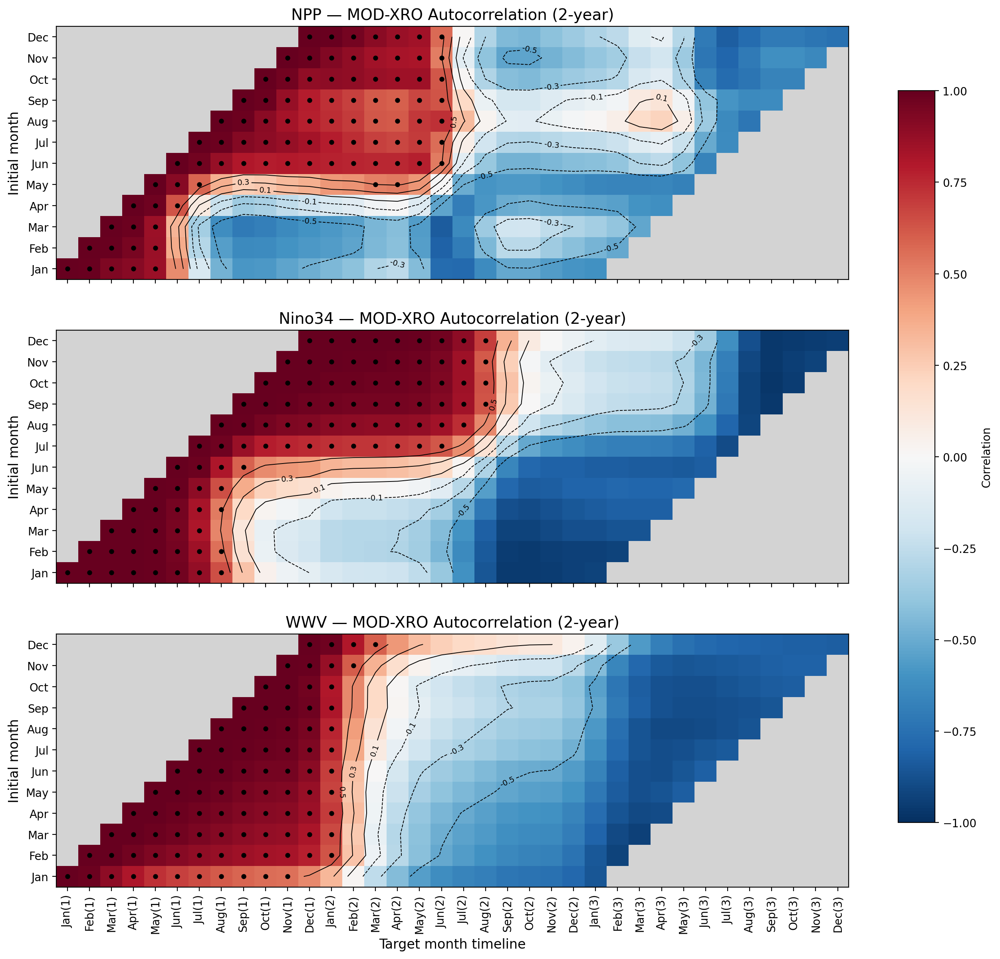

In [126]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

def oras_multiyear_from_forecast(ds, varname, max_lag=24):
    """
    Compute ORAS-style multiyear predictability (autocorrelation) map
    from forecast dataset with (init, lead) structure.
    """
    # Extract variable and relevant coordinates
    da = ds[varname]
    month = ds["month"].values.astype(int)
    leads = da["lead"].values
    n_init = da.sizes["init"]
    
    # 1) Correlation: 12 × (lag+1)
    pers = np.full((12, max_lag+1), np.nan)

    # Loop over initial month
    for init_m in range(1, 13):
        idx_init = np.where(month == init_m)[0]

        for lag in range(max_lag+1):
            # check if we can shift leads without going out of bounds
            if lag >= len(leads):
                continue
            valid_idx = idx_init[idx_init + lag < n_init]

            if len(valid_idx) < 5:
                continue

            # Flatten along lead axis: use all available forecast points
            x = da[valid_idx, 0].values  # lead 0 values
            y = da[valid_idx, lag].values

            if np.all(np.isnan(x)) or np.all(np.isnan(y)):
                continue

            corr = np.corrcoef(x, y)[0, 1]
            pers[init_m - 1, lag] = corr

    # 2) Shifted ORAS-style matrix
    W = max_lag + 12
    skill = np.full((12, W), np.nan)
    for im in range(1, 13):
        shift = im - 1
        skill[im - 1, shift:shift + max_lag + 1] = pers[im - 1, :]

    return skill

# =========================================================
# Example usage
# =========================================================
max_lag = 24
vars_to_plot = ["NPP", "Nino34", "WWV"]

skills = {v: oras_multiyear_from_forecast(MOD_XRO_NPP_fcst, v, max_lag=max_lag)
          for v in vars_to_plot}

# =========================================================
# Plot
# =========================================================
calendar = ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug",
            "Sep","Oct","Nov","Dec"]

labels = []
year = 1
for i in range(max_lag + 12):
    mo = i % 12
    if i > 0 and mo == 0:
        year += 1
    labels.append(f"{calendar[mo]}({year})")

fig, axes = plt.subplots(len(vars_to_plot), 1, figsize=(16, 14), sharex=True)
cmap = plt.get_cmap("RdBu_r").copy()
cmap.set_bad(color='lightgray')

for ax, name in zip(axes, vars_to_plot):
    skill = skills[name]
    masked = np.ma.masked_where(np.isnan(skill), skill)

    im = ax.imshow(masked, origin="lower", cmap=cmap, vmin=-1, vmax=1, aspect="auto")

    # Contour lines
    levels = [-0.5, -0.3, -0.1, 0.1, 0.3, 0.5]
    CS = ax.contour(masked, levels=levels, colors='black', linewidths=0.7)
    ax.clabel(CS, fmt='%0.1f', fontsize=7)

    # Dot markers for r ≥ 0.5
    yy, xx = np.where(skill >= 0.5)
    ax.scatter(xx, yy, s=12, color='black', marker='o')

    ax.set_yticks(np.arange(12))
    ax.set_yticklabels(calendar)
    ax.set_ylabel("Initial month", fontsize=12)
    ax.set_title(f"{name} — MOD-XRO Autocorrelation (2-year)", fontsize=14)

axes[-1].set_xticks(np.arange(len(labels)))
axes[-1].set_xticklabels(labels, rotation=90)
axes[-1].set_xlabel("Target month timeline", fontsize=12)

fig.colorbar(im, ax=axes.ravel().tolist(), shrink=0.85, label="Correlation")
# plt.tight_layout()
plt.show()


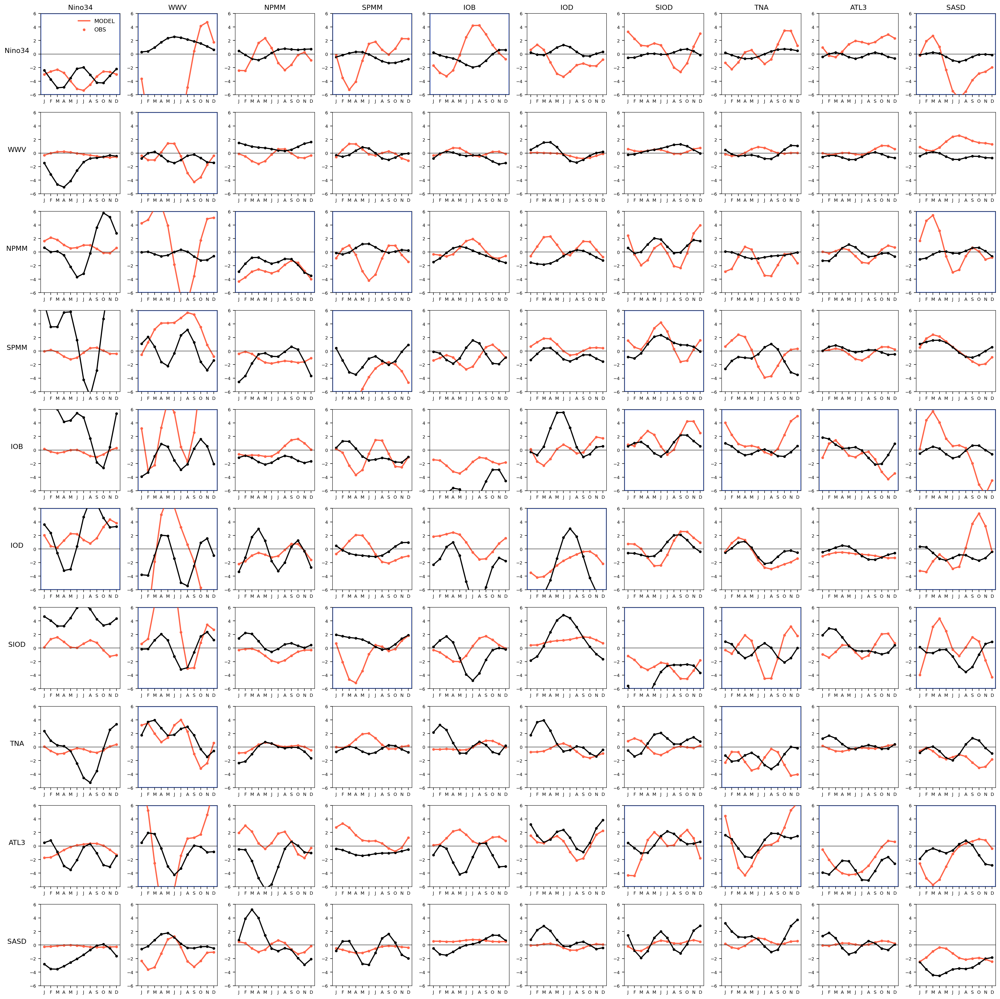

In [104]:
import numpy as np
import matplotlib.pyplot as plt

var_names = ["Nino34","WWV","NPMM","SPMM","IOB","IOD","SIOD","TNA","ATL3","SASD"]

Y_idx = range(10)
X_idx = range(10)

Lac_obs = OBS_fit_XRO_NPP["normLac"].values
Lac_mod = MOD_fit_XRO_NPP["normLac"].values

calendar = ["J","F","M","A","M","J","J","A","S","O","N","D"]

fig, axes = plt.subplots(10, 10, figsize=(22, 22))
axes = np.atleast_2d(axes)

for iy, y in enumerate(Y_idx):
    for ix, x in enumerate(X_idx):
        ax = axes[iy, ix]

        obs_curve = Lac_obs[y, x, :]
        mod_curve = Lac_mod[y, x, :]

        ax.plot(range(12), mod_curve, color="tomato", lw=2)
        ax.scatter(range(12), mod_curve, color="tomato", s=10)

        ax.plot(range(12), obs_curve, color="black", lw=1.8)
        ax.scatter(range(12), obs_curve, color="black", s=10)

        ax.axhline(0, color="k", lw=0.6)

        # y-axis limit
        ax.set_ylim(-6, 6)

        # ★ x-axis: all 12 months
        ax.set_xticks(range(12))
        ax.set_xticklabels(calendar, fontsize=7)

        ax.tick_params(axis='y', labelsize=7)

        if np.max(np.abs(mod_curve)) > 4.0:
            ax.add_patch(plt.Rectangle(
                (0,0), 1,1, fill=False, edgecolor="royalblue",
                transform=ax.transAxes, lw=2
            ))

        for spine in ax.spines.values():
            spine.set_linewidth(0.6)

for ix in X_idx:
    axes[0, ix].set_title(var_names[ix], fontsize=11)

for iy in Y_idx:
    axes[iy, 0].set_ylabel(var_names[iy], fontsize=11, rotation=0, labelpad=20)

axes[0, 0].legend(["MODEL","OBS"], fontsize=9, loc='upper right', frameon=False)

plt.tight_layout()
plt.show()


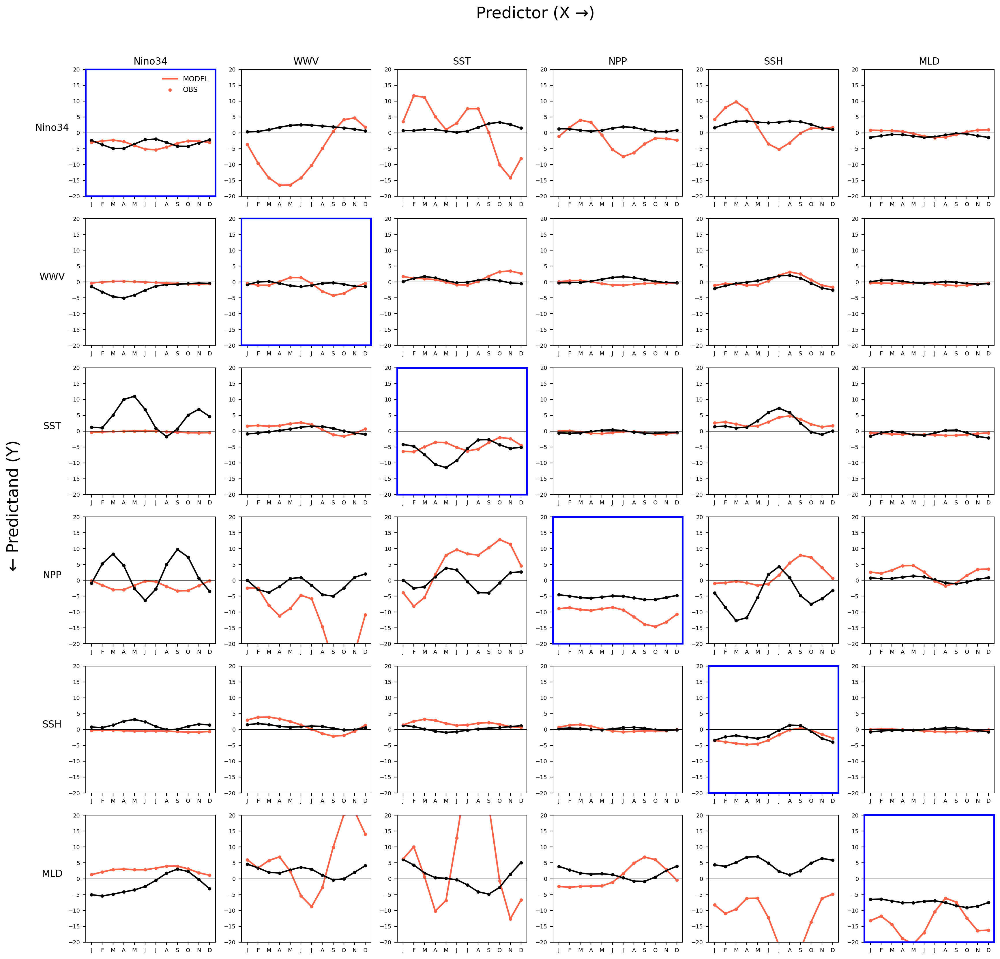

In [118]:
import numpy as np
import matplotlib.pyplot as plt

# variables to plot (6×6 grid)
var_names = ["Nino34","WWV","SST","NPP","SSH","MLD"]

# original ordering in normLac
full_order = ["Nino34","WWV","NPMM","SPMM","IOB","IOD","SIOD",
              "TNA","ATL3","SASD","SST","NPP","SSH","MLD"]

# index mapping
index_map = [full_order.index(v) for v in var_names]

# extract Lac arrays
Lac_obs = OBS_fit_XRO_NPP["normLac"].values      # (rankY, rankX, cycle)
Lac_mod = MOD_fit_XRO_NPP["normLac"].values

calendar = ["J","F","M","A","M","J","J","A","S","O","N","D"]

n = len(var_names)
fig, axes = plt.subplots(n, n, figsize=(18, 18))
axes = np.atleast_2d(axes)

for iy, y in enumerate(index_map):
    for ix, x in enumerate(index_map):
        ax = axes[iy, ix]

        obs_curve = Lac_obs[y, x, :]
        mod_curve = Lac_mod[y, x, :]

        # model (tomato)
        ax.plot(range(12), mod_curve, color="tomato", lw=2)
        ax.scatter(range(12), mod_curve, color="tomato", s=10)

        # obs (black)
        ax.plot(range(12), obs_curve, color="black", lw=1.8)
        ax.scatter(range(12), obs_curve, color="black", s=10)

        ax.axhline(0, color="k", lw=0.7)

        ax.set_ylim(-20, 20)
        ax.set_xticks(range(12))
        ax.set_xticklabels(calendar, fontsize=7)
        ax.tick_params(axis='y', labelsize=7)

        # default spine
        for spine in ax.spines.values():
            spine.set_linewidth(0.7)

        # diagonal blue frame
        if iy == ix:
            for spine in ax.spines.values():
                spine.set_edgecolor("blue")
                spine.set_linewidth(2.2)

# column titles
for ix, name in enumerate(var_names):
    axes[0, ix].set_title(name, fontsize=12)

# row labels
for iy, name in enumerate(var_names):
    axes[iy, 0].set_ylabel(name, fontsize=12, rotation=0, labelpad=20)

# legend only once
axes[0, 0].legend(["MODEL","OBS"], fontsize=9, loc='upper right', frameon=False)

# -----------------------------
#  🔥 Add large axis labels
# -----------------------------
fig.text(0.55, 0.97, "Predictor (X →)", ha='center', fontsize=20)   # TOP
fig.text(0.04, 0.5, "← Predictand (Y)", va='center', fontsize=20, rotation='vertical')

plt.tight_layout(rect=[0.06, 0.06, 1, 0.94])  # leave space above for top label
plt.show()


In [114]:
OBS_fit_XRO_NPP

<xarray.Dataset> Size: 237kB
Dimensions:         (ranky: 14, rankx: 14, cycle: 12, ac_rank: 3, cossin: 5,
                     time: 312, nro_form: 5)
Coordinates:
  * rankx           (rankx) int32 56B 1 2 3 4 5 6 7 8 9 10 11 12 13 14
  * cycle           (cycle) float64 96B 0.04167 0.125 0.2083 ... 0.875 0.9583
  * ac_rank         (ac_rank) int32 12B 0 1 2
  * cossin          (cossin) int32 20B 0 1 2 3 4
  * time            (time) float64 2kB 0.04167 0.125 0.2083 ... 25.88 25.96
  * ranky           (ranky) int64 112B 1 2 3 4 5 6 7 8 9 10 11 12 13 14
  * nro_form        (nro_form) <U3 60B 'T2' 'TH' 'T3' 'T2H' 'TH2'
Data variables: (12/31)
    Lac             (ranky, rankx, cycle) float64 19kB -2.396 -3.74 ... -7.516
    Lcomp           (ranky, rankx, cycle, ac_rank) float64 56kB -3.384 ... 0....
    Lcoef           (ranky, rankx, cossin) float64 8kB -3.384 -0.2097 ... 0.1967
    X               (rankx, time) float64 35kB 2.65 2.132 1.519 ... 7.102 6.112
    Y               (ranky, time) float64 35kB -6.224 -7.345 ... -11.88 -11.88
    Yfit            (ranky, time) float64 35kB -7.58 -6.753 ... 7.038 7.002
    ...              ...
    NROT_Lcoef      (nro_form, cossin) float64 200B -0.05953 0.1305 ... 0.0 0.0
    NROT_Lcomp      (nro_form, cycle, ac_rank) float64 1kB -0.05953 ... 0.0
    NROH_Lac        (nro_form, cycle) float64 480B 0.5464 1.479 ... 0.0 0.0
    NROH_Lcoef      (nro_form, cossin) float64 200B 0.3321 1.12 ... 0.0 0.0
    NROH_Lcomp      (nro_form, cycle, ac_rank) float64 1kB 0.3321 1.12 ... 0.0
    var_names       (ranky) <U6 336B 'Nino34' 'WWV' 'NPMM' ... 'NPP' 'SSH' 'MLD'

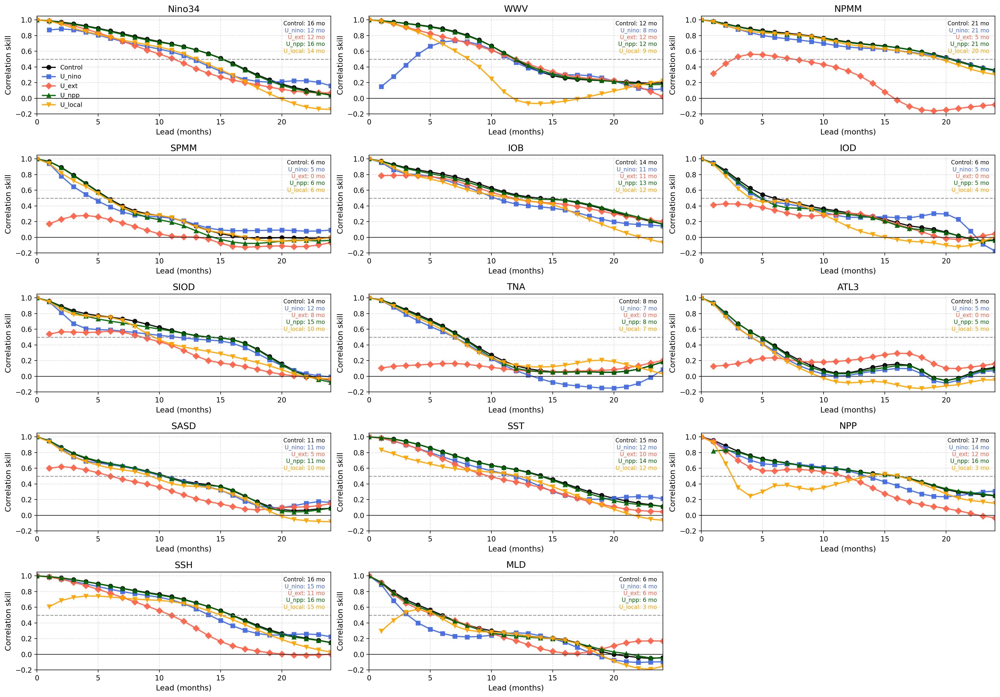

In [81]:
import numpy as np
import matplotlib.pyplot as plt

# ---------------------------------------------------------
# Dataset dictionary
# ---------------------------------------------------------
ds_dict = {
    "Control": OBS_acc_XRO_NPP,
    "U_nino": OBS_acc_XRO_NPP_U_nino,
    "U_ext":  OBS_acc_XRO_NPP_U_ext,
    "U_npp":  OBS_acc_XRO_NPP_U_npp,
    "U_local":OBS_acc_XRO_NPP_U_local,
}

# ---------------------------------------------------------
# Variable list
# ---------------------------------------------------------
var_list = [
    "Nino34","WWV","NPMM","SPMM","IOB","IOD","SIOD",
    "TNA","ATL3","SASD","SST","NPP","SSH","MLD"
]

# ---------------------------------------------------------
# Panel layout
# ---------------------------------------------------------
ncol = 3
nrow = int(np.ceil(len(var_list) / ncol))
fig, axes = plt.subplots(nrow, ncol, figsize=(20, 14))
axes = axes.flatten()

# Colors & markers
colors = {
    "Control": "black",
    "U_nino": "royalblue",
    "U_ext": "tomato",
    "U_npp": "darkgreen",
    "U_local": "orange",
}
markers = {
    "Control": "o",
    "U_nino": "s",
    "U_ext": "D",
    "U_npp": "^",
    "U_local": "v",
}

def max_consecutive_true(mask):
    """Return the length of the longest consecutive True sequence."""
    if not np.any(mask):
        return 0
    padded = np.concatenate(([False], mask, [False]))
    diff = np.diff(padded.astype(int))
    starts = np.where(diff == 1)[0]
    ends = np.where(diff == -1)[0]
    lengths = ends - starts
    return lengths.max() if len(lengths) > 0 else 0

# ---------------------------------------------------------
# Main plotting loop
# ---------------------------------------------------------
for i, var in enumerate(var_list):
    ax = axes[i]
    text_y = 0.95  # start y-position for annotations

    # ---- plot each experiment ----
    for label, ds in ds_dict.items():
        if var in ds:
            lead = ds["lead"].values
            skill = ds[var].values

            # main line
            ax.plot(
                lead, skill,
                marker=markers[label],
                color=colors[label],
                label=label,
                linewidth=1.8,
                alpha=0.9
            )

            # ---- compute max continuous lead with skill ≥ 0.5 ----
            mask = skill >= 0.5
            max_len = max_consecutive_true(mask)

            # annotate text
            ax.text(
                0.98, text_y,
                f"{label}: {max_len} mo",
                color=colors[label],
                ha='right', va='top',
                fontsize=8,
                transform=ax.transAxes
            )
            text_y -= 0.07  # shift down per experiment

    # ---- aesthetics ----
    ax.axhline(0, color='k', lw=0.8)
    ax.axhline(0.5, color='gray', lw=1.2, ls='--', alpha=0.8)
    ax.set_ylim(-0.2, 1.05)
    ax.set_xlim(0, ds["lead"].max())
    ax.grid(True, linestyle='--', alpha=0.4)
    ax.set_title(var, fontsize=13)
    ax.set_xlabel("Lead (months)", fontsize=11)
    ax.set_ylabel("Correlation skill", fontsize=11)
    ax.tick_params(axis='both', labelsize=10)

    if i == 0:
        ax.legend(fontsize=9, loc='lower left', frameon=False)

# Hide unused panels
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


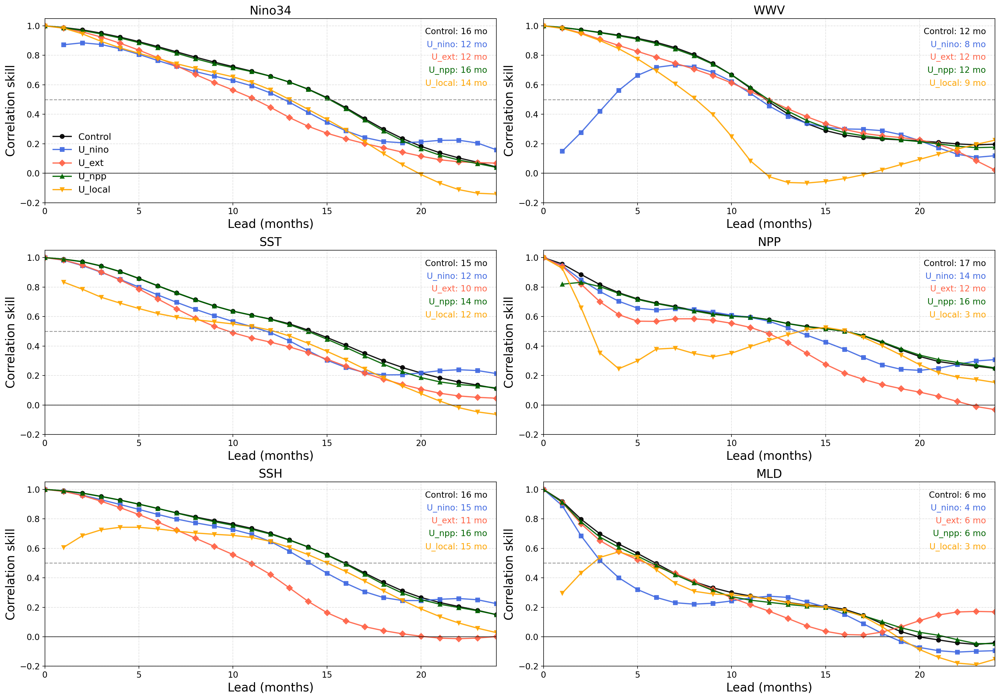

In [84]:
import numpy as np
import matplotlib.pyplot as plt

# ---------------------------------------------------------
# Dataset dictionary
# ---------------------------------------------------------
ds_dict = {
    "Control": OBS_acc_XRO_NPP,
    "U_nino": OBS_acc_XRO_NPP_U_nino,
    "U_ext":  OBS_acc_XRO_NPP_U_ext,
    "U_npp":  OBS_acc_XRO_NPP_U_npp,
    "U_local":OBS_acc_XRO_NPP_U_local,
}

# ---------------------------------------------------------
# Variable list
# ---------------------------------------------------------
var_list = [
    "Nino34","WWV","SST","NPP","SSH","MLD"
]

# ---------------------------------------------------------
# Panel layout
# ---------------------------------------------------------
ncol = 2
nrow = int(np.ceil(len(var_list) / ncol))
fig, axes = plt.subplots(nrow, ncol, figsize=(20, 14))
axes = axes.flatten()

# Colors & markers
colors = {
    "Control": "black",
    "U_nino": "royalblue",
    "U_ext": "tomato",
    "U_npp": "darkgreen",
    "U_local": "orange",
}
markers = {
    "Control": "o",
    "U_nino": "s",
    "U_ext": "D",
    "U_npp": "^",
    "U_local": "v",
}

def max_consecutive_true(mask):
    """Return the length of the longest consecutive True sequence."""
    if not np.any(mask):
        return 0
    padded = np.concatenate(([False], mask, [False]))
    diff = np.diff(padded.astype(int))
    starts = np.where(diff == 1)[0]
    ends = np.where(diff == -1)[0]
    lengths = ends - starts
    return lengths.max() if len(lengths) > 0 else 0

# ---------------------------------------------------------
# Main plotting loop
# ---------------------------------------------------------
for i, var in enumerate(var_list):
    ax = axes[i]
    text_y = 0.95  # start y-position for annotations

    # ---- plot each experiment ----
    for label, ds in ds_dict.items():
        if var in ds:
            lead = ds["lead"].values
            skill = ds[var].values

            # main line
            ax.plot(
                lead, skill,
                marker=markers[label],
                color=colors[label],
                label=label,
                linewidth=1.8,
                alpha=0.9
            )

            # ---- compute max continuous lead with skill ≥ 0.5 ----
            mask = skill >= 0.5
            max_len = max_consecutive_true(mask)

            # annotate text
            ax.text(
                0.98, text_y,
                f"{label}: {max_len} mo",
                color=colors[label],
                ha='right', va='top',
                fontsize=12,
                transform=ax.transAxes
            )
            text_y -= 0.07  # shift down per experiment

    # ---- aesthetics ----
    ax.axhline(0, color='k', lw=0.8)
    ax.axhline(0.5, color='gray', lw=1.2, ls='--', alpha=0.8)
    ax.set_ylim(-0.2, 1.05)
    ax.set_xlim(0, ds["lead"].max())
    ax.grid(True, linestyle='--', alpha=0.4)
    ax.set_title(var, fontsize=17)
    ax.set_xlabel("Lead (months)", fontsize=17)
    ax.set_ylabel("Correlation skill", fontsize=17)
    ax.tick_params(axis='both', labelsize=12)

    if i == 0:
        ax.legend(fontsize=13, loc='lower left', frameon=False)

# Hide unused panels
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


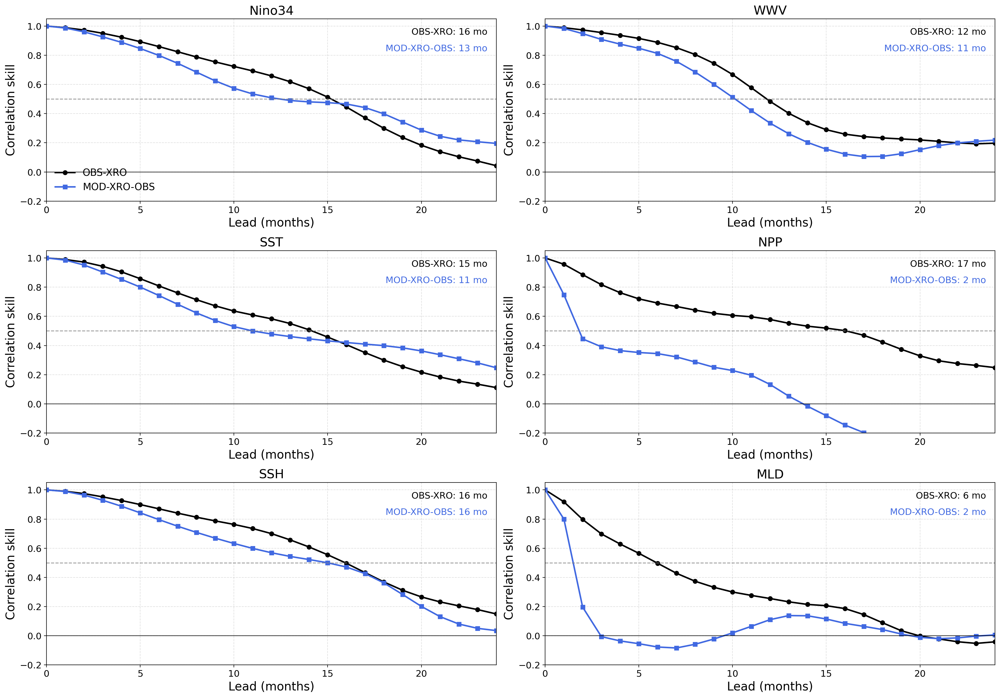

In [125]:
import numpy as np
import matplotlib.pyplot as plt

# ---------------------------------------------------------
# Dataset dictionary (2 curves)
# ---------------------------------------------------------
ds_dict = {
    "OBS-XRO": OBS_acc_XRO_NPP,          # 관측 기반 skill
    "MOD-XRO-OBS": MOD_OBS_acc_XRO_NPP,    # 모델 기반 skill
}

# ---------------------------------------------------------
# 변수 목록
# ---------------------------------------------------------
var_list = ["Nino34","WWV","SST","NPP","SSH","MLD"]

# ---------------------------------------------------------
# 패널 설정
# ---------------------------------------------------------
ncol = 2
nrow = int(np.ceil(len(var_list) / ncol))
fig, axes = plt.subplots(nrow, ncol, figsize=(20, 14))
axes = axes.flatten()

# 색상 & 마커
colors = {
    "OBS-XRO": "black",
    "MOD-XRO-OBS": "royalblue",
}
markers = {
    "OBS-XRO": "o",
    "MOD-XRO-OBS": "s",
}

def max_consecutive_true(mask):
    """Return the length of the longest consecutive True sequence."""
    if not np.any(mask):
        return 0
    padded = np.concatenate(([False], mask, [False]))
    diff = np.diff(padded.astype(int))
    starts = np.where(diff == 1)[0]
    ends = np.where(diff == -1)[0]
    lengths = ends - starts
    return lengths.max() if len(lengths) > 0 else 0


# ---------------------------------------------------------
# 메인 플롯 루프
# ---------------------------------------------------------
for i, var in enumerate(var_list):
    ax = axes[i]
    text_y = 0.95

    for label, ds in ds_dict.items():
        if var not in ds:
            continue

        lead = ds["lead"].values
        skill = ds[var].values

        ax.plot(
            lead, skill,
            marker=markers[label],
            color=colors[label],
            label=label,
            linewidth=2.2
        )

        # ✨ max months with skill ≥ 0.5 계산
        mask = skill >= 0.5
        max_len = max_consecutive_true(mask)

        ax.text(
            0.98, text_y,
            f"{label}: {max_len} mo",
            color=colors[label],
            ha='right', va='top',
            fontsize=13,
            transform=ax.transAxes
        )
        text_y -= 0.09

    # ---------------- aesthetics ----------------
    ax.axhline(0, color='k', lw=0.8)
    ax.axhline(0.5, color='gray', lw=1.2, ls='--', alpha=0.8)
    ax.set_ylim(-0.2, 1.05)
    ax.set_xlim(0, lead.max())
    ax.grid(True, linestyle='--', alpha=0.4)
    ax.set_title(var, fontsize=18)
    ax.set_xlabel("Lead (months)", fontsize=17)
    ax.set_ylabel("Correlation skill", fontsize=17)
    ax.tick_params(axis='both', labelsize=13)

    if i == 0:
        ax.legend(fontsize=14, loc='lower left', frameon=False)

# 빈 패널 제거
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


In [ ]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

def oras_multiyear_from_forecast(ds, varname, max_lag=24):
    """
    Compute ORAS-style multiyear predictability (autocorrelation) map
    from forecast dataset with (init, lead) structure.
    """
    # Extract variable and relevant coordinates
    da = ds[varname]
    month = ds["month"].values.astype(int)
    leads = da["lead"].values
    n_init = da.sizes["init"]
    
    # 1) Correlation: 12 × (lag+1)
    pers = np.full((12, max_lag+1), np.nan)

    # Loop over initial month
    for init_m in range(1, 13):
        idx_init = np.where(month == init_m)[0]

        for lag in range(max_lag+1):
            # check if we can shift leads without going out of bounds
            if lag >= len(leads):
                continue
            valid_idx = idx_init[idx_init + lag < n_init]

            if len(valid_idx) < 5:
                continue

            # Flatten along lead axis: use all available forecast points
            x = da[valid_idx, 0].values  # lead 0 values
            y = da[valid_idx, lag].values

            if np.all(np.isnan(x)) or np.all(np.isnan(y)):
                continue

            corr = np.corrcoef(x, y)[0, 1]
            pers[init_m - 1, lag] = corr

    # 2) Shifted ORAS-style matrix
    W = max_lag + 12
    skill = np.full((12, W), np.nan)
    for im in range(1, 13):
        shift = im - 1
        skill[im - 1, shift:shift + max_lag + 1] = pers[im - 1, :]

    return skill

# =========================================================
# Example usage
# =========================================================
max_lag = 24
vars_to_plot = ["NPP", "Nino34", "WWV"]

skills = {v: oras_multiyear_from_forecast(OBS_XRO_NPP_fcst, v, max_lag=max_lag)
          for v in vars_to_plot}

# =========================================================
# Plot
# =========================================================
calendar = ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug",
            "Sep","Oct","Nov","Dec"]

labels = []
year = 1
for i in range(max_lag + 12):
    mo = i % 12
    if i > 0 and mo == 0:
        year += 1
    labels.append(f"{calendar[mo]}({year})")

fig, axes = plt.subplots(len(vars_to_plot), 1, figsize=(16, 14), sharex=True)
cmap = plt.get_cmap("RdBu_r").copy()
cmap.set_bad(color='lightgray')

for ax, name in zip(axes, vars_to_plot):
    skill = skills[name]
    masked = np.ma.masked_where(np.isnan(skill), skill)

    im = ax.imshow(masked, origin="lower", cmap=cmap, vmin=-1, vmax=1, aspect="auto")

    # Contour lines
    levels = [-0.5, -0.3, -0.1, 0.1, 0.3, 0.5]
    CS = ax.contour(masked, levels=levels, colors='black', linewidths=0.7)
    ax.clabel(CS, fmt='%0.1f', fontsize=7)

    # Dot markers for r ≥ 0.5
    yy, xx = np.where(skill >= 0.5)
    ax.scatter(xx, yy, s=12, color='black', marker='o')

    ax.set_yticks(np.arange(12))
    ax.set_yticklabels(calendar)
    ax.set_ylabel("Initial month", fontsize=12)
    ax.set_title(f"{name} — OBS-XRO Autocorrelation (2-year)", fontsize=14)

axes[-1].set_xticks(np.arange(len(labels)))
axes[-1].set_xticklabels(labels, rotation=90)
axes[-1].set_xlabel("Target month timeline", fontsize=12)

fig.colorbar(im, ax=axes.ravel().tolist(), shrink=0.85, label="Correlation")
# plt.tight_layout()
plt.show()


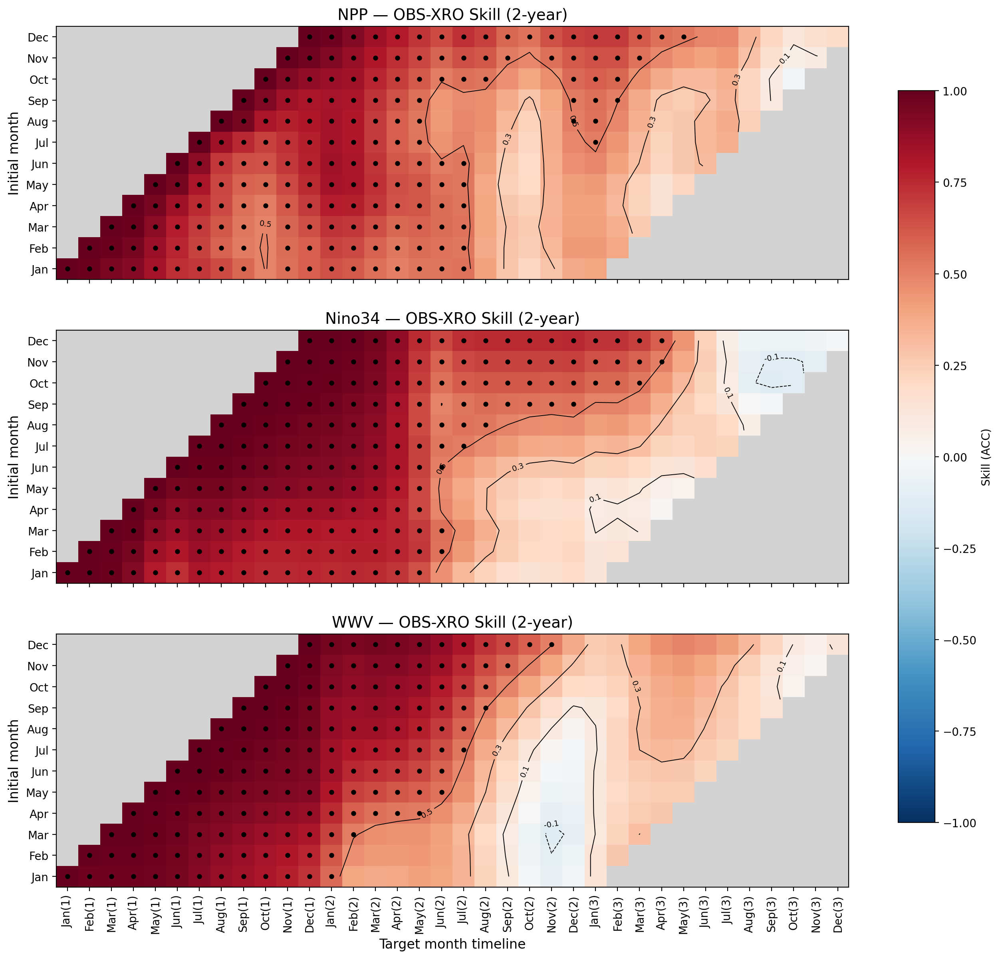

In [129]:
import numpy as np
import matplotlib.pyplot as plt

def oras_shift_from_skill(ds, varname, max_lag=24):
    """
    Convert skill(month, lead) → ORAS-style shifted matrix (12 × (12+max_lag))
    """
    skill_m = ds[varname].values      # shape: (12, lead)
    months = ds["month"].values       # 1..12
    leads  = ds["lead"].values

    pers = np.full((12, max_lag+1), np.nan)

    # fill pers(init_month, lag)
    for m in range(1, 13):
        idx = np.where(months == m)[0]
        if len(idx) == 0:
            continue
        row = idx[0]  # month unique
        for lag in range(max_lag+1):
            if lag < len(leads):
                pers[m-1, lag] = skill_m[row, lag]

    # Shift to ORAS-style grid
    W = max_lag + 12
    out = np.full((12, W), np.nan)
    for im in range(1, 13):
        shift = im - 1
        out[im-1, shift:shift+max_lag+1] = pers[im-1, :]

    return out


# =========================================================
# Variables to plot
# =========================================================
vars_to_plot = ["NPP", "Nino34", "WWV"]
max_lag = 24

skills = {
    v: oras_shift_from_skill(OBS_acc_mon_XRO_NPP, v, max_lag=max_lag)
    for v in vars_to_plot
}

# =========================================================
# Labels
# =========================================================
calendar = ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug",
            "Sep","Oct","Nov","Dec"]

labels = []
year = 1
for i in range(max_lag + 12):
    mo = i % 12
    if i > 0 and mo == 0:
        year += 1
    labels.append(f"{calendar[mo]}({year})")

# =========================================================
# Plot
# =========================================================
fig, axes = plt.subplots(len(vars_to_plot), 1, figsize=(16, 14), sharex=True)
cmap = plt.get_cmap("RdBu_r").copy()
cmap.set_bad(color='lightgray')

for ax, name in zip(axes, vars_to_plot):
    skill = skills[name]
    masked = np.ma.masked_where(np.isnan(skill), skill)

    im = ax.imshow(masked, origin="lower", cmap=cmap,
                   vmin=-1, vmax=1, aspect="auto")

    # Contour lines
    levels = [-0.5, -0.3, -0.1, 0.1, 0.3, 0.5]
    CS = ax.contour(masked, levels=levels, colors='black', linewidths=0.7)
    ax.clabel(CS, fmt='%0.1f', fontsize=7)

    # Dot markers where skill ≥ 0.5
    yy, xx = np.where(skill >= 0.5)
    ax.scatter(xx, yy, s=12, color='black', marker='o')

    ax.set_yticks(np.arange(12))
    ax.set_yticklabels(calendar)
    ax.set_ylabel("Initial month", fontsize=12)
    ax.set_title(f"{name} — OBS-XRO Skill (2-year)", fontsize=14)

axes[-1].set_xticks(np.arange(len(labels)))
axes[-1].set_xticklabels(labels, rotation=90)
axes[-1].set_xlabel("Target month timeline", fontsize=12)

fig.colorbar(im, ax=axes.ravel().tolist(), shrink=0.85, label="Skill (ACC)")
plt.show()


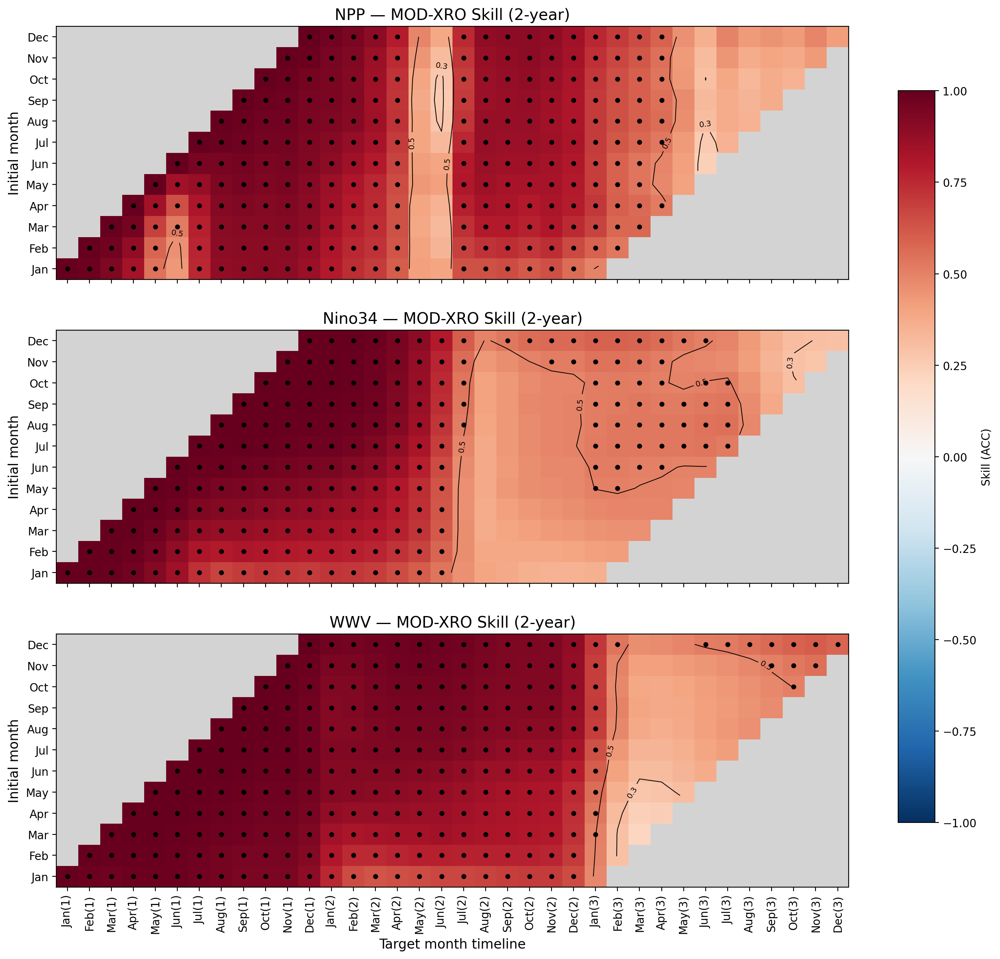

In [130]:
import numpy as np
import matplotlib.pyplot as plt

def oras_shift_from_skill(ds, varname, max_lag=24):
    """
    Convert skill(month, lead) → ORAS-style shifted matrix (12 × (12+max_lag))
    """
    skill_m = ds[varname].values      # shape: (12, lead)
    months = ds["month"].values       # 1..12
    leads  = ds["lead"].values

    pers = np.full((12, max_lag+1), np.nan)

    # fill pers(init_month, lag)
    for m in range(1, 13):
        idx = np.where(months == m)[0]
        if len(idx) == 0:
            continue
        row = idx[0]  # month unique
        for lag in range(max_lag+1):
            if lag < len(leads):
                pers[m-1, lag] = skill_m[row, lag]

    # Shift to ORAS-style grid
    W = max_lag + 12
    out = np.full((12, W), np.nan)
    for im in range(1, 13):
        shift = im - 1
        out[im-1, shift:shift+max_lag+1] = pers[im-1, :]

    return out


# =========================================================
# Variables to plot
# =========================================================
vars_to_plot = ["NPP", "Nino34", "WWV"]
max_lag = 24

skills = {
    v: oras_shift_from_skill(MOD_acc_mon_XRO_NPP, v, max_lag=max_lag)
    for v in vars_to_plot
}

# =========================================================
# Labels
# =========================================================
calendar = ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug",
            "Sep","Oct","Nov","Dec"]

labels = []
year = 1
for i in range(max_lag + 12):
    mo = i % 12
    if i > 0 and mo == 0:
        year += 1
    labels.append(f"{calendar[mo]}({year})")

# =========================================================
# Plot
# =========================================================
fig, axes = plt.subplots(len(vars_to_plot), 1, figsize=(16, 14), sharex=True)
cmap = plt.get_cmap("RdBu_r").copy()
cmap.set_bad(color='lightgray')

for ax, name in zip(axes, vars_to_plot):
    skill = skills[name]
    masked = np.ma.masked_where(np.isnan(skill), skill)

    im = ax.imshow(masked, origin="lower", cmap=cmap,
                   vmin=-1, vmax=1, aspect="auto")

    # Contour lines
    levels = [-0.5, -0.3, -0.1, 0.1, 0.3, 0.5]
    CS = ax.contour(masked, levels=levels, colors='black', linewidths=0.7)
    ax.clabel(CS, fmt='%0.1f', fontsize=7)

    # Dot markers where skill ≥ 0.5
    yy, xx = np.where(skill >= 0.5)
    ax.scatter(xx, yy, s=12, color='black', marker='o')

    ax.set_yticks(np.arange(12))
    ax.set_yticklabels(calendar)
    ax.set_ylabel("Initial month", fontsize=12)
    ax.set_title(f"{name} — MOD-XRO Skill (2-year)", fontsize=14)

axes[-1].set_xticks(np.arange(len(labels)))
axes[-1].set_xticklabels(labels, rotation=90)
axes[-1].set_xlabel("Target month timeline", fontsize=12)

fig.colorbar(im, ax=axes.ravel().tolist(), shrink=0.85, label="Skill (ACC)")
plt.show()


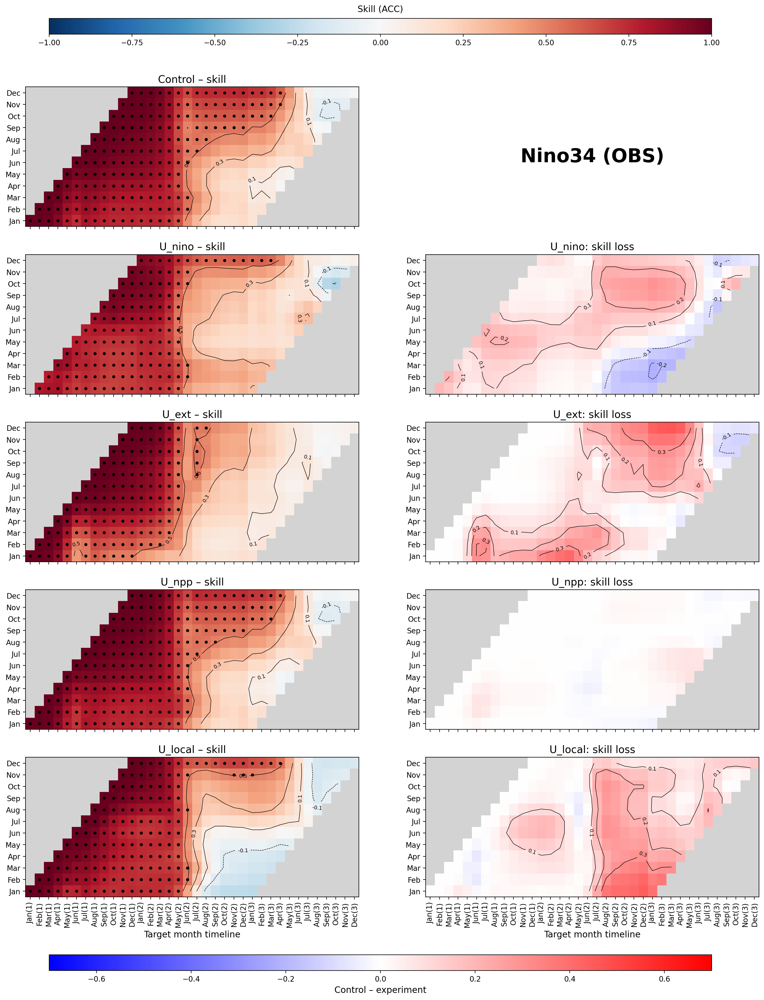

In [142]:
import numpy as np
import matplotlib.pyplot as plt

def oras_shift_from_skill(ds, varname, max_lag=24):
    skill_m = ds[varname].values
    months = ds["month"].values
    leads  = ds["lead"].values

    pers = np.full((12, max_lag+1), np.nan)
    for m in range(1, 13):
        idx = np.where(months == m)[0]
        if len(idx) == 0:
            continue
        row = idx[0]
        for lag in range(max_lag+1):
            if lag < len(leads):
                pers[m-1, lag] = skill_m[row, lag]

    W = max_lag + 12
    out = np.full((12, W), np.nan)
    for im in range(1, 13):
        shift = im - 1
        out[im-1, shift:shift+max_lag+1] = pers[im-1, :]
    return out


# 실험 목록
exp_dict = {
    "Control": OBS_acc_mon_XRO_NPP,
    "U_nino":  OBS_acc_mon_XRO_NPP_U_nino,
    "U_ext":   OBS_acc_mon_XRO_NPP_U_ext,
    "U_npp":   OBS_acc_mon_XRO_NPP_U_npp,
    "U_local": OBS_acc_mon_XRO_NPP_U_local,
}

var = "Nino34"
max_lag = 24

shift_maps = {k: oras_shift_from_skill(ds, var, max_lag) for k, ds in exp_dict.items()}
control_map = shift_maps["Control"]

# label 설정
calendar = ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug","Sep","Oct","Nov","Dec"]
labels = []
year = 1
for i in range(max_lag + 12):
    mo = i % 12
    if i > 0 and mo == 0:
        year += 1
    labels.append(f"{calendar[mo]}({year})")


# ===== Plot (5 × 2) =====
fig, axes = plt.subplots(5, 2, figsize=(18, 20), sharex=True)
cmap = plt.get_cmap("RdBu_r").copy()
cmap.set_bad(color="lightgray")
cmap_diff = plt.get_cmap("bwr").copy()
cmap_diff.set_bad(color="lightgray")

for r, (exp_name, skill) in enumerate(shift_maps.items()):
    # ---- 1열: skill ----
    ax1 = axes[r, 0]
    masked = np.ma.masked_where(np.isnan(skill), skill)
    im = ax1.imshow(masked, origin="lower", cmap=cmap, vmin=-1, vmax=1, aspect="auto")

    CS = ax1.contour(masked, levels=[-0.5,-0.3,-0.1,0.1,0.3,0.5],
                     colors='black', linewidths=0.6)
    ax1.clabel(CS, fmt='%0.1f', fontsize=7)

    yy, xx = np.where(skill >= 0.5)
    ax1.scatter(xx, yy, s=10, color='black')

    ax1.set_yticks(np.arange(12))
    ax1.set_yticklabels(calendar)
    ax1.set_title(f"{exp_name} – skill", fontsize=14)

    # ---- 2열: diff ----
    ax2 = axes[r, 1]
    if exp_name == "Control":
        ax2.axis("off")
        continue

    diff = control_map - skill
    masked_diff = np.ma.masked_where(np.isnan(diff), diff)
    im2 = ax2.imshow(masked_diff, origin="lower", cmap=cmap_diff,
                     vmin=-0.7, vmax=0.7, aspect="auto")

    CS2 = ax2.contour(masked_diff,
                      levels=[-0.3,-0.2,-0.1,0.1,0.2,0.3],
                      colors='black', linewidths=0.6)
    ax2.clabel(CS2, fmt='%0.1f', fontsize=7)

    ax2.set_yticks(np.arange(12))
    ax2.set_yticklabels(calendar)
    ax2.set_title(f"{exp_name}: skill loss", fontsize=14)


# x tick
axes[-1, 0].set_xticks(np.arange(len(labels)))
axes[-1, 0].set_xticklabels(labels, rotation=90)
axes[-1, 0].set_xlabel("Target month timeline", fontsize=12)

axes[-1, 1].set_xticks(np.arange(len(labels)))
axes[-1, 1].set_xticklabels(labels, rotation=90)
axes[-1, 1].set_xlabel("Target month timeline", fontsize=12)

axes[0, 1].axis("off")
axes[0, 1].text(
    0.5, 0.5, f"{var} (OBS)",
    fontsize=26, fontweight='bold',
    ha='center', va='center',
    transform=axes[0, 1].transAxes
)

# === horizontal colorbars ===
cbar_ax_top = fig.add_axes([0.15, 0.93, 0.70, 0.015])
cbar = fig.colorbar(im, cax=cbar_ax_top, orientation="horizontal")
cbar.set_label("Skill (ACC)", fontsize=12, labelpad=-57)
# cbar.ax.xaxis.set_label_position('top')
cbar.ax.xaxis.tick_bottom()

cbar_ax_bot = fig.add_axes([0.15, 0.04, 0.70, 0.015])
cbar2 = fig.colorbar(im2, cax=cbar_ax_bot, orientation="horizontal")
cbar2.set_label("Control – experiment", fontsize=12)

# plt.tight_layout()
plt.show()


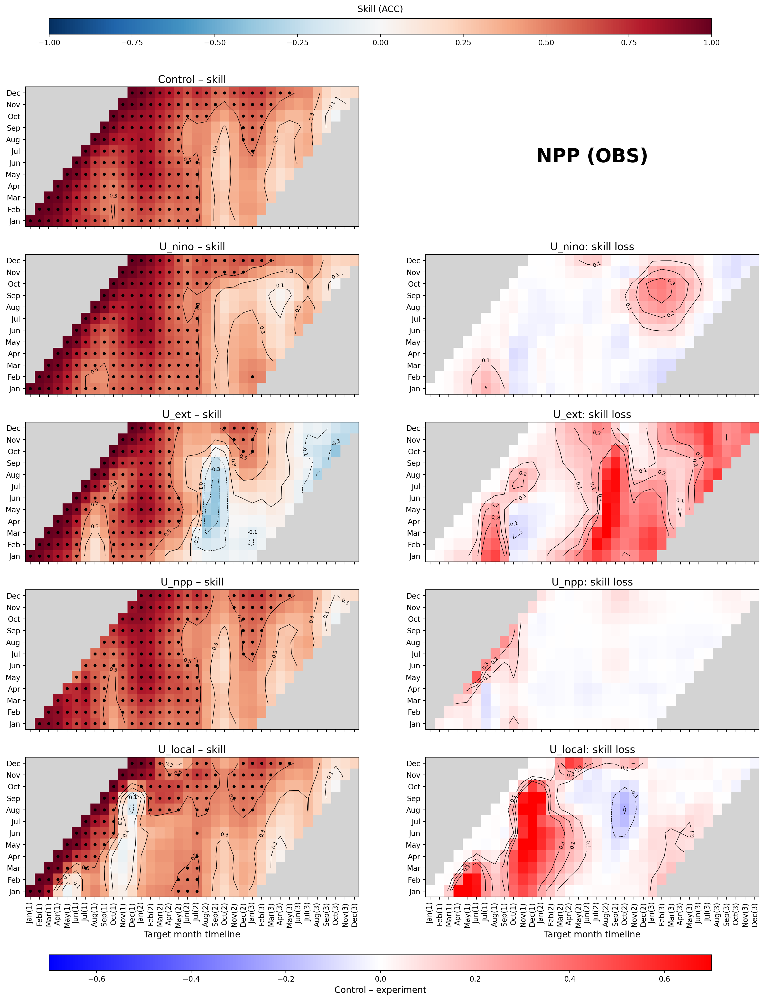

In [143]:
import numpy as np
import matplotlib.pyplot as plt

def oras_shift_from_skill(ds, varname, max_lag=24):
    skill_m = ds[varname].values
    months = ds["month"].values
    leads  = ds["lead"].values

    pers = np.full((12, max_lag+1), np.nan)
    for m in range(1, 13):
        idx = np.where(months == m)[0]
        if len(idx) == 0:
            continue
        row = idx[0]
        for lag in range(max_lag+1):
            if lag < len(leads):
                pers[m-1, lag] = skill_m[row, lag]

    W = max_lag + 12
    out = np.full((12, W), np.nan)
    for im in range(1, 13):
        shift = im - 1
        out[im-1, shift:shift+max_lag+1] = pers[im-1, :]
    return out


# 실험 목록
exp_dict = {
    "Control": OBS_acc_mon_XRO_NPP,
    "U_nino":  OBS_acc_mon_XRO_NPP_U_nino,
    "U_ext":   OBS_acc_mon_XRO_NPP_U_ext,
    "U_npp":   OBS_acc_mon_XRO_NPP_U_npp,
    "U_local": OBS_acc_mon_XRO_NPP_U_local,
}

var = "NPP"
max_lag = 24

shift_maps = {k: oras_shift_from_skill(ds, var, max_lag) for k, ds in exp_dict.items()}
control_map = shift_maps["Control"]

# label 설정
calendar = ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug","Sep","Oct","Nov","Dec"]
labels = []
year = 1
for i in range(max_lag + 12):
    mo = i % 12
    if i > 0 and mo == 0:
        year += 1
    labels.append(f"{calendar[mo]}({year})")


# ===== Plot (5 × 2) =====
fig, axes = plt.subplots(5, 2, figsize=(18, 20), sharex=True)
cmap = plt.get_cmap("RdBu_r").copy()
cmap.set_bad(color="lightgray")
cmap_diff = plt.get_cmap("bwr").copy()
cmap_diff.set_bad(color="lightgray")

for r, (exp_name, skill) in enumerate(shift_maps.items()):
    # ---- 1열: skill ----
    ax1 = axes[r, 0]
    masked = np.ma.masked_where(np.isnan(skill), skill)
    im = ax1.imshow(masked, origin="lower", cmap=cmap, vmin=-1, vmax=1, aspect="auto")

    CS = ax1.contour(masked, levels=[-0.5,-0.3,-0.1,0.1,0.3,0.5],
                     colors='black', linewidths=0.6)
    ax1.clabel(CS, fmt='%0.1f', fontsize=7)

    yy, xx = np.where(skill >= 0.5)
    ax1.scatter(xx, yy, s=10, color='black')

    ax1.set_yticks(np.arange(12))
    ax1.set_yticklabels(calendar)
    ax1.set_title(f"{exp_name} – skill", fontsize=14)

    # ---- 2열: diff ----
    ax2 = axes[r, 1]
    if exp_name == "Control":
        ax2.axis("off")
        continue

    diff = control_map - skill
    masked_diff = np.ma.masked_where(np.isnan(diff), diff)
    im2 = ax2.imshow(masked_diff, origin="lower", cmap=cmap_diff,
                     vmin=-0.7, vmax=0.7, aspect="auto")

    CS2 = ax2.contour(masked_diff,
                      levels=[-0.3,-0.2,-0.1,0.1,0.2,0.3],
                      colors='black', linewidths=0.6)
    ax2.clabel(CS2, fmt='%0.1f', fontsize=7)

    ax2.set_yticks(np.arange(12))
    ax2.set_yticklabels(calendar)
    ax2.set_title(f"{exp_name}: skill loss", fontsize=14)


# x tick
axes[-1, 0].set_xticks(np.arange(len(labels)))
axes[-1, 0].set_xticklabels(labels, rotation=90)
axes[-1, 0].set_xlabel("Target month timeline", fontsize=12)

axes[-1, 1].set_xticks(np.arange(len(labels)))
axes[-1, 1].set_xticklabels(labels, rotation=90)
axes[-1, 1].set_xlabel("Target month timeline", fontsize=12)

axes[0, 1].axis("off")
axes[0, 1].text(
    0.5, 0.5, f"{var} (OBS)",
    fontsize=26, fontweight='bold',
    ha='center', va='center',
    transform=axes[0, 1].transAxes
)

# === horizontal colorbars ===
cbar_ax_top = fig.add_axes([0.15, 0.93, 0.70, 0.015])
cbar = fig.colorbar(im, cax=cbar_ax_top, orientation="horizontal")
cbar.set_label("Skill (ACC)", fontsize=12, labelpad=-57)
# cbar.ax.xaxis.set_label_position('top')
cbar.ax.xaxis.tick_bottom()

cbar_ax_bot = fig.add_axes([0.15, 0.04, 0.70, 0.015])
cbar2 = fig.colorbar(im2, cax=cbar_ax_bot, orientation="horizontal")
cbar2.set_label("Control – experiment", fontsize=12)

# plt.tight_layout()
plt.show()


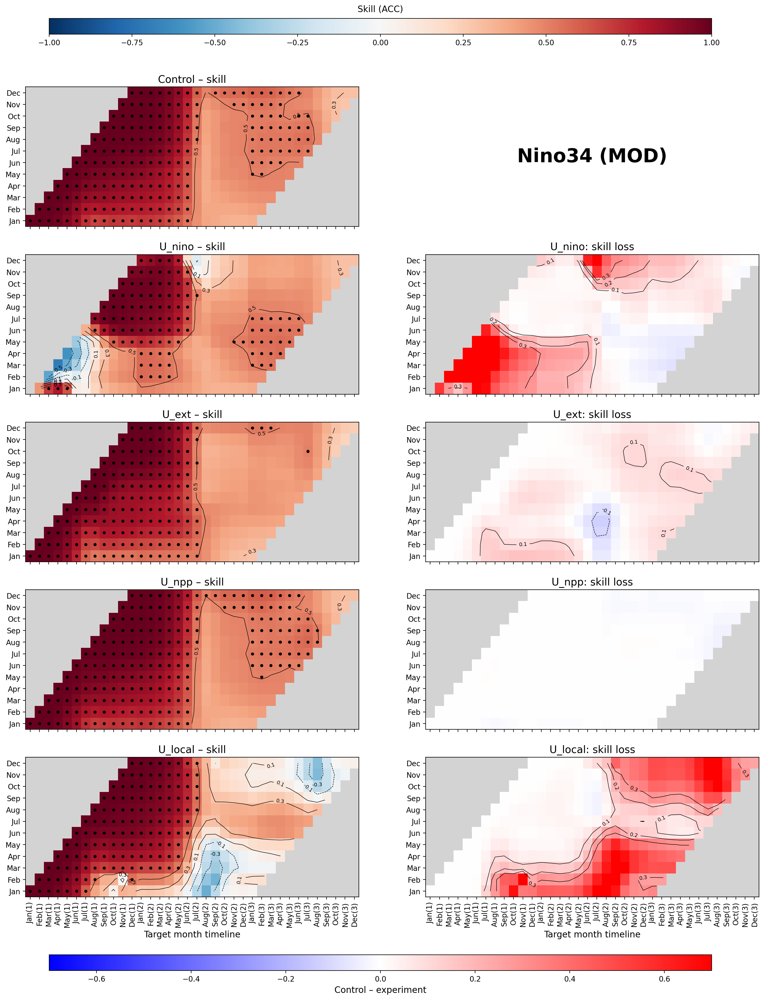

In [144]:
import numpy as np
import matplotlib.pyplot as plt

def oras_shift_from_skill(ds, varname, max_lag=24):
    skill_m = ds[varname].values
    months = ds["month"].values
    leads  = ds["lead"].values

    pers = np.full((12, max_lag+1), np.nan)
    for m in range(1, 13):
        idx = np.where(months == m)[0]
        if len(idx) == 0:
            continue
        row = idx[0]
        for lag in range(max_lag+1):
            if lag < len(leads):
                pers[m-1, lag] = skill_m[row, lag]

    W = max_lag + 12
    out = np.full((12, W), np.nan)
    for im in range(1, 13):
        shift = im - 1
        out[im-1, shift:shift+max_lag+1] = pers[im-1, :]
    return out


# 실험 목록
exp_dict = {
    "Control": MOD_acc_mon_XRO_NPP,
    "U_nino":  MOD_acc_mon_XRO_NPP_U_nino,
    "U_ext":   MOD_acc_mon_XRO_NPP_U_ext,
    "U_npp":   MOD_acc_mon_XRO_NPP_U_npp,
    "U_local": MOD_acc_mon_XRO_NPP_U_local,
}

var = "Nino34"
max_lag = 24

shift_maps = {k: oras_shift_from_skill(ds, var, max_lag) for k, ds in exp_dict.items()}
control_map = shift_maps["Control"]

# label 설정
calendar = ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug","Sep","Oct","Nov","Dec"]
labels = []
year = 1
for i in range(max_lag + 12):
    mo = i % 12
    if i > 0 and mo == 0:
        year += 1
    labels.append(f"{calendar[mo]}({year})")


# ===== Plot (5 × 2) =====
fig, axes = plt.subplots(5, 2, figsize=(18, 20), sharex=True)
cmap = plt.get_cmap("RdBu_r").copy()
cmap.set_bad(color="lightgray")
cmap_diff = plt.get_cmap("bwr").copy()
cmap_diff.set_bad(color="lightgray")

for r, (exp_name, skill) in enumerate(shift_maps.items()):
    # ---- 1열: skill ----
    ax1 = axes[r, 0]
    masked = np.ma.masked_where(np.isnan(skill), skill)
    im = ax1.imshow(masked, origin="lower", cmap=cmap, vmin=-1, vmax=1, aspect="auto")

    CS = ax1.contour(masked, levels=[-0.5,-0.3,-0.1,0.1,0.3,0.5],
                     colors='black', linewidths=0.6)
    ax1.clabel(CS, fmt='%0.1f', fontsize=7)

    yy, xx = np.where(skill >= 0.5)
    ax1.scatter(xx, yy, s=10, color='black')

    ax1.set_yticks(np.arange(12))
    ax1.set_yticklabels(calendar)
    ax1.set_title(f"{exp_name} – skill", fontsize=14)

    # ---- 2열: diff ----
    ax2 = axes[r, 1]
    if exp_name == "Control":
        ax2.axis("off")
        continue

    diff = control_map - skill
    masked_diff = np.ma.masked_where(np.isnan(diff), diff)
    im2 = ax2.imshow(masked_diff, origin="lower", cmap=cmap_diff,
                     vmin=-0.7, vmax=0.7, aspect="auto")

    CS2 = ax2.contour(masked_diff,
                      levels=[-0.3,-0.2,-0.1,0.1,0.2,0.3],
                      colors='black', linewidths=0.6)
    ax2.clabel(CS2, fmt='%0.1f', fontsize=7)

    ax2.set_yticks(np.arange(12))
    ax2.set_yticklabels(calendar)
    ax2.set_title(f"{exp_name}: skill loss", fontsize=14)


# x tick
axes[-1, 0].set_xticks(np.arange(len(labels)))
axes[-1, 0].set_xticklabels(labels, rotation=90)
axes[-1, 0].set_xlabel("Target month timeline", fontsize=12)

axes[-1, 1].set_xticks(np.arange(len(labels)))
axes[-1, 1].set_xticklabels(labels, rotation=90)
axes[-1, 1].set_xlabel("Target month timeline", fontsize=12)

axes[0, 1].axis("off")
axes[0, 1].text(
    0.5, 0.5, f"{var} (MOD)",
    fontsize=26, fontweight='bold',
    ha='center', va='center',
    transform=axes[0, 1].transAxes
)

# === horizontal colorbars ===
cbar_ax_top = fig.add_axes([0.15, 0.93, 0.70, 0.015])
cbar = fig.colorbar(im, cax=cbar_ax_top, orientation="horizontal")
cbar.set_label("Skill (ACC)", fontsize=12, labelpad=-57)
# cbar.ax.xaxis.set_label_position('top')
cbar.ax.xaxis.tick_bottom()

cbar_ax_bot = fig.add_axes([0.15, 0.04, 0.70, 0.015])
cbar2 = fig.colorbar(im2, cax=cbar_ax_bot, orientation="horizontal")
cbar2.set_label("Control – experiment", fontsize=12)

# plt.tight_layout()
plt.show()


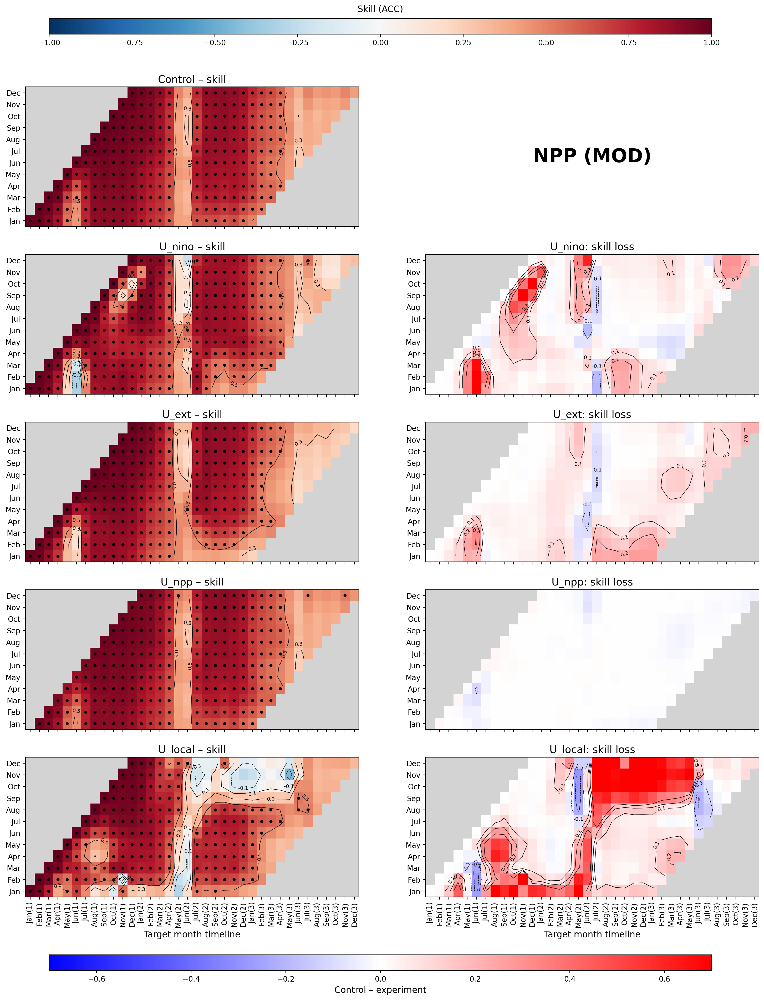

In [145]:
import numpy as np
import matplotlib.pyplot as plt

def oras_shift_from_skill(ds, varname, max_lag=24):
    skill_m = ds[varname].values
    months = ds["month"].values
    leads  = ds["lead"].values

    pers = np.full((12, max_lag+1), np.nan)
    for m in range(1, 13):
        idx = np.where(months == m)[0]
        if len(idx) == 0:
            continue
        row = idx[0]
        for lag in range(max_lag+1):
            if lag < len(leads):
                pers[m-1, lag] = skill_m[row, lag]

    W = max_lag + 12
    out = np.full((12, W), np.nan)
    for im in range(1, 13):
        shift = im - 1
        out[im-1, shift:shift+max_lag+1] = pers[im-1, :]
    return out


# 실험 목록
exp_dict = {
    "Control": MOD_acc_mon_XRO_NPP,
    "U_nino":  MOD_acc_mon_XRO_NPP_U_nino,
    "U_ext":   MOD_acc_mon_XRO_NPP_U_ext,
    "U_npp":   MOD_acc_mon_XRO_NPP_U_npp,
    "U_local": MOD_acc_mon_XRO_NPP_U_local,
}

var = "NPP"
max_lag = 24

shift_maps = {k: oras_shift_from_skill(ds, var, max_lag) for k, ds in exp_dict.items()}
control_map = shift_maps["Control"]

# label 설정
calendar = ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug","Sep","Oct","Nov","Dec"]
labels = []
year = 1
for i in range(max_lag + 12):
    mo = i % 12
    if i > 0 and mo == 0:
        year += 1
    labels.append(f"{calendar[mo]}({year})")


# ===== Plot (5 × 2) =====
fig, axes = plt.subplots(5, 2, figsize=(18, 20), sharex=True)
cmap = plt.get_cmap("RdBu_r").copy()
cmap.set_bad(color="lightgray")
cmap_diff = plt.get_cmap("bwr").copy()
cmap_diff.set_bad(color="lightgray")

for r, (exp_name, skill) in enumerate(shift_maps.items()):
    # ---- 1열: skill ----
    ax1 = axes[r, 0]
    masked = np.ma.masked_where(np.isnan(skill), skill)
    im = ax1.imshow(masked, origin="lower", cmap=cmap, vmin=-1, vmax=1, aspect="auto")

    CS = ax1.contour(masked, levels=[-0.5,-0.3,-0.1,0.1,0.3,0.5],
                     colors='black', linewidths=0.6)
    ax1.clabel(CS, fmt='%0.1f', fontsize=7)

    yy, xx = np.where(skill >= 0.5)
    ax1.scatter(xx, yy, s=10, color='black')

    ax1.set_yticks(np.arange(12))
    ax1.set_yticklabels(calendar)
    ax1.set_title(f"{exp_name} – skill", fontsize=14)

    # ---- 2열: diff ----
    ax2 = axes[r, 1]
    if exp_name == "Control":
        ax2.axis("off")
        continue

    diff = control_map - skill
    masked_diff = np.ma.masked_where(np.isnan(diff), diff)
    im2 = ax2.imshow(masked_diff, origin="lower", cmap=cmap_diff,
                     vmin=-0.7, vmax=0.7, aspect="auto")

    CS2 = ax2.contour(masked_diff,
                      levels=[-0.3,-0.2,-0.1,0.1,0.2,0.3],
                      colors='black', linewidths=0.6)
    ax2.clabel(CS2, fmt='%0.1f', fontsize=7)

    ax2.set_yticks(np.arange(12))
    ax2.set_yticklabels(calendar)
    ax2.set_title(f"{exp_name}: skill loss", fontsize=14)


# x tick
axes[-1, 0].set_xticks(np.arange(len(labels)))
axes[-1, 0].set_xticklabels(labels, rotation=90)
axes[-1, 0].set_xlabel("Target month timeline", fontsize=12)

axes[-1, 1].set_xticks(np.arange(len(labels)))
axes[-1, 1].set_xticklabels(labels, rotation=90)
axes[-1, 1].set_xlabel("Target month timeline", fontsize=12)

axes[0, 1].axis("off")
axes[0, 1].text(
    0.5, 0.5, f"{var} (MOD)",
    fontsize=26, fontweight='bold',
    ha='center', va='center',
    transform=axes[0, 1].transAxes
)

# === horizontal colorbars ===
cbar_ax_top = fig.add_axes([0.15, 0.93, 0.70, 0.015])
cbar = fig.colorbar(im, cax=cbar_ax_top, orientation="horizontal")
cbar.set_label("Skill (ACC)", fontsize=12, labelpad=-57)
# cbar.ax.xaxis.set_label_position('top')
cbar.ax.xaxis.tick_bottom()

cbar_ax_bot = fig.add_axes([0.15, 0.04, 0.70, 0.015])
cbar2 = fig.colorbar(im2, cax=cbar_ax_bot, orientation="horizontal")
cbar2.set_label("Control – experiment", fontsize=12)

# plt.tight_layout()
plt.show()


In [146]:
OBS_XRO_NPP_fcst

<xarray.Dataset> Size: 877kB
Dimensions:  (init: 312, lead: 25)
Coordinates:
  * init     (init) datetime64[ns] 2kB 1998-01-01 1998-02-01 ... 2023-12-01
  * lead     (lead) int32 100B 0 1 2 3 4 5 6 7 8 ... 16 17 18 19 20 21 22 23 24
    month    (init) int32 1kB 1 2 3 4 5 6 7 8 9 10 11 ... 3 4 5 6 7 8 9 10 11 12
Data variables: (12/14)
    Nino34   (init, lead) float64 62kB 2.65 2.356 1.765 ... -0.06737 -0.07463
    WWV      (init, lead) float64 62kB -9.418 -12.55 -16.4 ... 8.651 7.915 7.167
    NPMM     (init, lead) float64 62kB 0.09372 0.04643 ... -0.3557 -0.285
    SPMM     (init, lead) float64 62kB -0.2806 -0.4426 ... -0.259 -0.2462
    IOB      (init, lead) float64 62kB 0.7303 0.7295 0.7292 ... -0.1154 -0.06396
    IOD      (init, lead) float64 62kB 0.8122 0.3874 ... -0.05197 0.04634
    ...       ...
    ATL3     (init, lead) float64 62kB 1.05 1.013 0.7931 ... -0.09061 -0.1035
    SASD     (init, lead) float64 62kB -0.8272 -0.7591 -0.7168 ... 0.1908 0.2267
    SST      (init, lead) float64 62kB 1.855 1.764 1.519 ... -0.1543 -0.1594
    NPP      (init, lead) float64 62kB -93.48 -90.97 -88.74 ... -1.189 3.518
    SSH      (init, lead) float64 62kB 0.1355 0.1218 ... -0.01274 -0.0138
    MLD      (init, lead) float64 62kB 3.849 4.299 4.498 ... 2.178 2.003 1.726

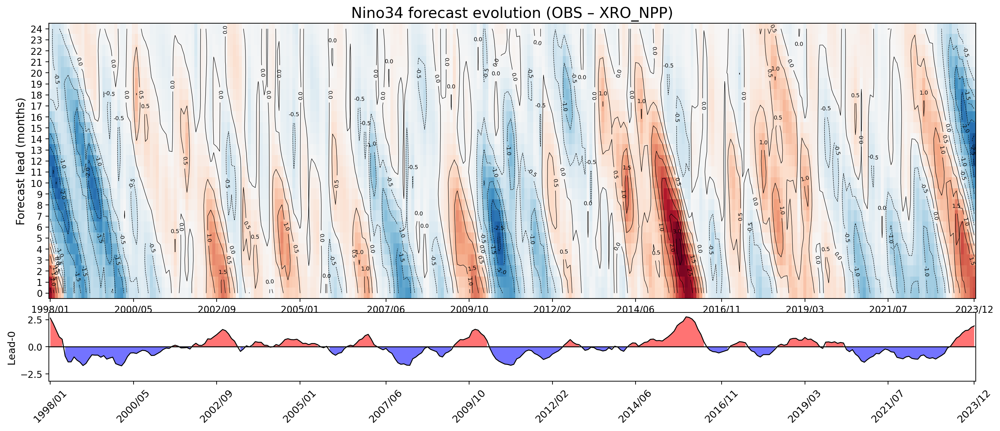

In [150]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# ---------------------------------------------------------
# Extract Nino34 forecast (init × lead)
# ---------------------------------------------------------
da = OBS_XRO_NPP_fcst["Nino34"]
init = pd.to_datetime(OBS_XRO_NPP_fcst["init"].values)
lead = da["lead"].values
values = da.values   # (n_init, n_lead)

# ---------------------------------------------------------
# Figure layout: 2 vertical panels (main shading + lead0 panel)
# ---------------------------------------------------------
fig, _ = plt.subplots(figsize=(18, 7))
gs = plt.GridSpec(2, 1, height_ratios=[4, 1], hspace=0.08)

ax_main = plt.subplot(gs[0])   # shading panel
ax_bot  = plt.subplot(gs[1], sharex=ax_main)  # lead0 anomaly panel

# ---------------------------------------------------------
# MAIN SHADING (init vs lead)
# ---------------------------------------------------------
cmap = plt.get_cmap("RdBu_r").copy()
cmap.set_bad("lightgray")

skill = values.T   # (lead, init)
masked = np.ma.masked_where(np.isnan(skill), skill)

im = ax_main.imshow(
    masked, origin="lower", cmap=cmap,
    vmin=-3, vmax=3, aspect="auto"
)

# contour lines
levels = np.linspace(-3, 3, 13)
cs = ax_main.contour(masked, levels=levels, colors="k", linewidths=0.45)
ax_main.clabel(cs, fmt="%.1f", fontsize=6)

ax_main.set_ylabel("Forecast lead (months)", fontsize=12)
ax_main.set_yticks(np.arange(len(lead)))
ax_main.set_yticklabels(lead)
ax_main.set_title("Nino34 forecast evolution (OBS – XRO_NPP)", fontsize=16)

# ---------------------------------------------------------
# LEAD 0 PANEL (positive / negative preserved)
# ---------------------------------------------------------
lead0 = values[:, 0]
x = np.arange(len(init))

# baseline
ax_bot.axhline(0, color="black", lw=1)

# positive fill
ax_bot.fill_between(x, 0, lead0, where=lead0 >= 0,
                    facecolor="red", alpha=0.55)
# negative fill
ax_bot.fill_between(x, 0, lead0, where=lead0 < 0,
                    facecolor="blue", alpha=0.55)

# curve on top
ax_bot.plot(x, lead0, color="black", lw=1)

# autoscale padding for visibility
max_abs = np.nanmax(np.abs(lead0))
ax_bot.set_ylim(-max_abs * 1.15, max_abs * 1.15)

ax_bot.set_ylabel("Lead-0", fontsize=11)

# ---------------------------------------------------------
# DATETIME X-AXIS LABELS (instead of index)
# ---------------------------------------------------------
xticks = np.linspace(0, len(init) - 1, 12, dtype=int)
ax_bot.set_xticks(xticks)
ax_bot.set_xticklabels([init[t].strftime("%Y/%m") for t in xticks],
                       rotation=45, fontsize=11)

# # ---------------------------------------------------------
# # Colorbar
# # ---------------------------------------------------------
# cbar = fig.colorbar(im, ax=ax_main, pad=0.015, shrink=0.85)
# cbar.set_label("Predicted anomaly", fontsize=12)

plt.show()


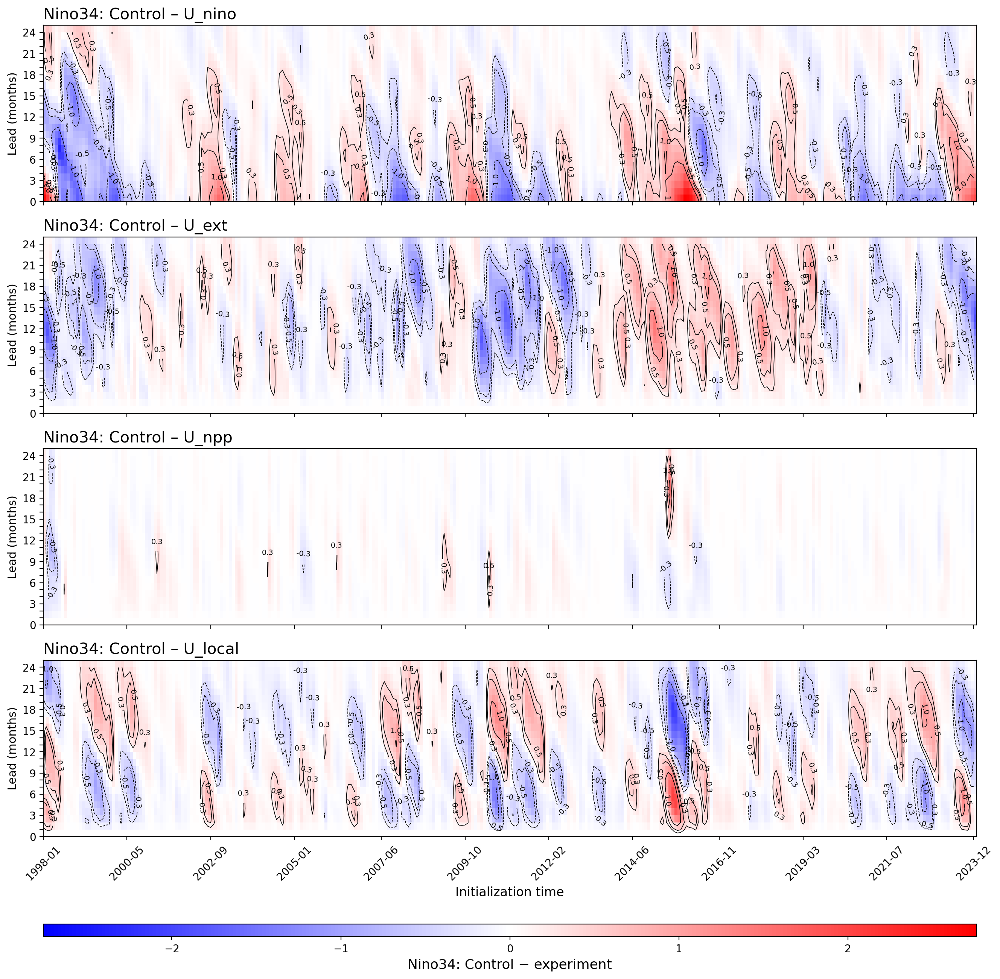

In [165]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

var = "Nino34"
exp_dict = {
    "Control": OBS_XRO_NPP_fcst,
    "U_nino":  OBS_XRO_NPP_fcst_U_nino,
    "U_ext":   OBS_XRO_NPP_fcst_U_ext,
    "U_npp":   OBS_XRO_NPP_fcst_U_npp,
    "U_local": OBS_XRO_NPP_fcst_U_local,
}

# baseline
fc_control = exp_dict["Control"][var].values
init = pd.to_datetime(exp_dict["Control"]["init"].values)
lead = exp_dict["Control"]["lead"].values

# calculate common vlim from diffs
diff_exps = [k for k in exp_dict.keys() if k != "Control"]
all_diff_vals = np.concatenate([
    (fc_control - exp_dict[name][var].values).flatten() for name in diff_exps
])
vlim = np.nanmax(np.abs(all_diff_vals))
levels_diff = [-1.0, -0.5, -0.3, 0.3, 0.5, 1.0]

# figure
n = len(diff_exps)
fig, axes = plt.subplots(n, 1, figsize=(16, 3.5 * n), sharex=True)
if n == 1:
    axes = [axes]

for ax, name in zip(axes, diff_exps):
    fc_exp = exp_dict[name][var].values
    diff = fc_control - fc_exp

    X, Y = np.meshgrid(np.arange(len(init) + 1),
                       np.arange(len(lead) + 1))

    im = ax.pcolormesh(
        X, Y, np.ma.masked_invalid(diff.T),
        cmap="bwr", vmin=-vlim, vmax=vlim, shading="auto"
    )

    CS = ax.contour(
        np.arange(len(init)), np.arange(len(lead)), diff.T,
        levels=levels_diff, colors="black", linewidths=0.6
    )
    ax.clabel(CS, fmt="%.1f", fontsize=7)

    # --- clean y axis: ticks every lead, labels every 3 ---
    ax.set_yticks(np.arange(len(lead)))
    yticks_show = np.arange(0, len(lead), 3)
    ax.set_yticklabels([
        str(lead[k]) if k in yticks_show else "" 
        for k in range(len(lead))
    ])

    ax.set_ylabel("Lead (months)", fontsize=11)
    ax.set_title(f"{var}: Control – {name}", fontsize=15, loc="left")

# x axis
xticks = np.linspace(0, len(init)-1, 12, dtype=int)
axes[-1].set_xticks(xticks)
axes[-1].set_xticklabels([init[t].strftime("%Y-%m") for t in xticks],
                         rotation=45, fontsize=10)
axes[-1].set_xlabel("Initialization time", fontsize=12)

# horizontal colorbar
# cbar = fig.colorbar(im, ax=axes, orientation="horizontal",
#                     pad=0.03, shrink=0.88)
# --- slim horizontal colorbar (moved further down) ---
last_ax = axes[-1]
bbox = last_ax.get_position()

# x0 그대로 / y0는 더 낮게 / width 동일 / height 매우 얇게
cax = fig.add_axes([
    bbox.x0,
    bbox.y0 - 0.095,   # down (previous -0.035 → -0.065)
    bbox.width,
    0.012             # slim colorbar (too slim, 0.008 is av)
])

cbar = fig.colorbar(im, cax=cax, orientation="horizontal")
cbar.set_label(f"{var}: Control − experiment", fontsize=13)

plt.show()


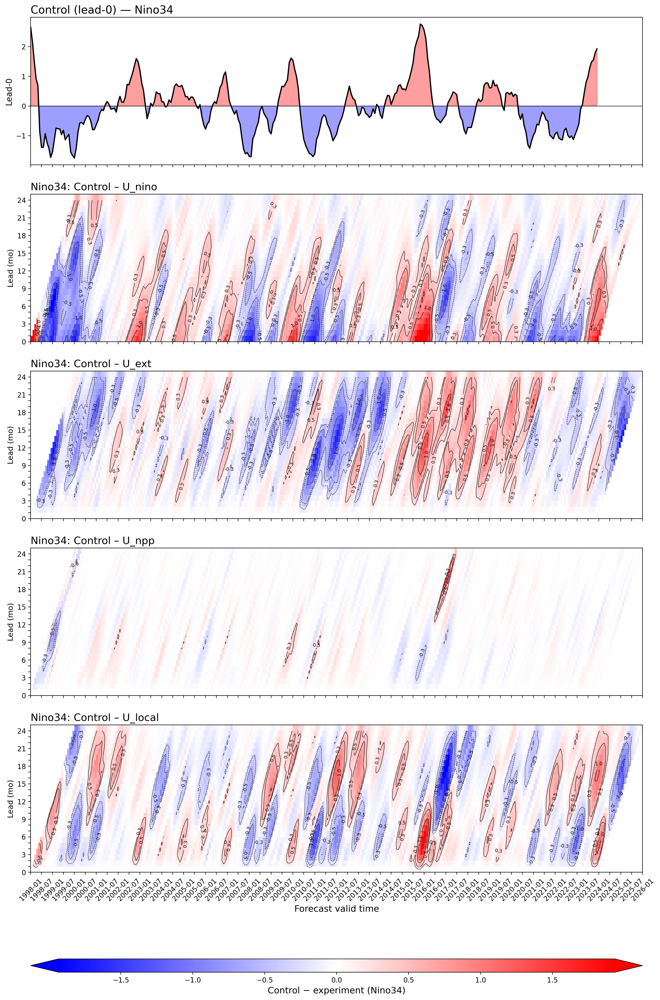

In [180]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

var = "Nino34"
exp_dict = {
    "Control": OBS_XRO_NPP_fcst,
    "U_nino":  OBS_XRO_NPP_fcst_U_nino,
    "U_ext":   OBS_XRO_NPP_fcst_U_ext,
    "U_npp":   OBS_XRO_NPP_fcst_U_npp,
    "U_local": OBS_XRO_NPP_fcst_U_local,
}

# ---------------------------------------------------------
# time information
# ---------------------------------------------------------
init = pd.to_datetime(exp_dict["Control"]["init"].values)
lead = exp_dict["Control"]["lead"].values
fc_control = exp_dict["Control"][var].values      # (init, lead)

# ---------------------------------------------------------
# build shifted valid_time (init + lead months)
# ---------------------------------------------------------
valid_time = np.empty_like(fc_control, dtype="datetime64[ns]")
for j, lag in enumerate(lead):
    valid_time[:, j] = init + pd.DateOffset(months=int(lag))

tmin = init.min()
tmax = valid_time.max()

# extend to end-of-month grid
time_edges = pd.date_range(tmin, tmax + pd.DateOffset(months=1), freq="MS")
time_num = time_edges.values.astype("datetime64[ns]")

# ---------------------------------------------------------
# difference limits
# ---------------------------------------------------------
diff_exps = [k for k in exp_dict.keys() if k != "Control"]
all_diff_vals = np.concatenate([
    (fc_control - exp_dict[name][var].values).flatten()
    for name in diff_exps
])
vlim = np.nanmax(np.abs(all_diff_vals))
show_lim = 0.70 * vlim      # 🔥 colorbar range 70%

im = ax.pcolormesh(
    time_edges, np.arange(len(lead)+1), Z_plot,
    cmap="bwr", vmin=-show_lim, vmax=show_lim, shading="auto"
)

# ---------------------------------------------------------
# build shift matrix function (triangular)
# ---------------------------------------------------------
def build_shift(diff_matrix):
    n_init, n_lead = diff_matrix.shape
    Z = np.full((n_lead, len(time_edges)), np.nan)
    for i in range(n_init):
        for j in range(n_lead):
            t = valid_time[i, j]
            if pd.isna(t):
                continue
            idx = np.searchsorted(time_edges, t)
            if 0 <= idx < len(time_edges):
                Z[j, idx] = diff_matrix[i, j]
    return Z

# ---------------------------------------------------------
# figure
# ---------------------------------------------------------
fig, axes = plt.subplots(len(diff_exps) + 1, 1, figsize=(16, 4.5 * (len(diff_exps)+1)), sharex=True)
if len(axes) == 1:
    axes = [axes]

# ---------------------------------------------------------
# TOP PANEL → Control lead-0 timeseries
# ---------------------------------------------------------
ax0 = axes[0]
fc0 = fc_control[:, 0]
tidx = np.arange(len(init))

ax0.plot(init, fc0, color="black", lw=1.8)
ax0.fill_between(init, 0, fc0, where=fc0 >= 0, color="red", alpha=0.38)
ax0.fill_between(init, 0, fc0, where=fc0 <  0, color="blue", alpha=0.38)
ax0.axhline(0, color="k", lw=0.7)

ax0.set_ylabel("Lead-0", fontsize=12)
ax0.set_title(f"Control (lead-0) — {var}", fontsize=16, loc="left")

# ---------------------------------------------------------
# HEATMAPS → diff = Control – experiment
# ---------------------------------------------------------
for ax, name in zip(axes[1:], diff_exps):
    diff = fc_control - exp_dict[name][var].values
    Z = build_shift(diff)
    Z_plot = np.ma.masked_invalid(Z[:len(lead), :-1])   # pcolormesh size fix

    im = ax.pcolormesh(
        time_edges, np.arange(len(lead)+1),
        Z_plot,
        cmap="bwr", vmin=-show_lim, vmax=show_lim, shading="auto"
    )

    CS = ax.contour(
        time_edges[:-1], np.arange(len(lead)),
        Z_plot,
        levels=levels_diff, colors="black", linewidths=0.55
    )
    ax.clabel(CS, fmt="%.1f", fontsize=7)

    # y ticks
    ax.set_yticks(np.arange(len(lead)))
    yticks_show = np.arange(0, len(lead), 3)
    ax.set_yticklabels([str(lead[k]) if k in yticks_show else "" for k in range(len(lead))])

    ax.set_ylabel("Lead (mo)", fontsize=11)
    ax.set_title(f"{var}: Control – {name}", fontsize=15, loc="left")

# ---------------------------------------------------------
# bottom x-axis tick formatting
# ---------------------------------------------------------
axes[-1].set_xticks(time_edges[::6])
axes[-1].set_xticklabels([t.strftime("%Y-%m") for t in time_edges[::6]], rotation=45, fontsize=10)
axes[-1].set_xlabel("Forecast valid time", fontsize=13)

# ---------------------------------------------------------
# colorbar (horizontal, slim)
# ---------------------------------------------------------
bbox = axes[-1].get_position()
cax = fig.add_axes([bbox.x0, bbox.y0 - 0.09, bbox.width, 0.012])
cbar = fig.colorbar(im, cax=cax, orientation="horizontal", extend="both")
cbar.set_label(f"Control − experiment ({var})", fontsize=13)

plt.show()


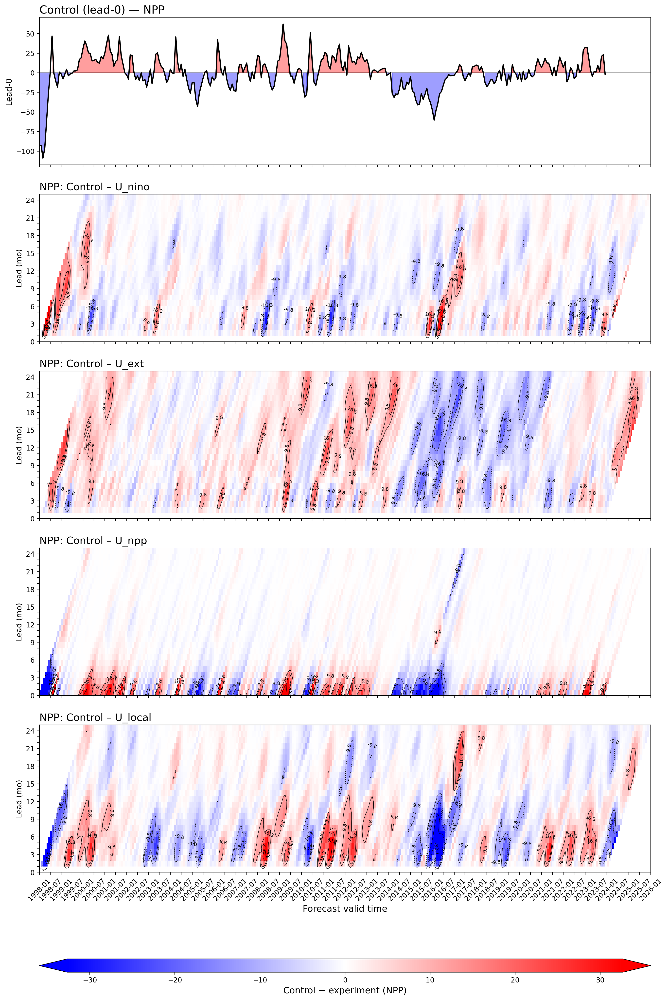

In [183]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

var = "NPP"
exp_dict = {
    "Control": OBS_XRO_NPP_fcst,
    "U_nino":  OBS_XRO_NPP_fcst_U_nino,
    "U_ext":   OBS_XRO_NPP_fcst_U_ext,
    "U_npp":   OBS_XRO_NPP_fcst_U_npp,
    "U_local": OBS_XRO_NPP_fcst_U_local,
}

# ---------------------------------------------------------
# time information
# ---------------------------------------------------------
init = pd.to_datetime(exp_dict["Control"]["init"].values)
lead = exp_dict["Control"]["lead"].values
fc_control = exp_dict["Control"][var].values      # (init, lead)

# ---------------------------------------------------------
# build shifted valid_time (init + lead months)
# ---------------------------------------------------------
valid_time = np.empty_like(fc_control, dtype="datetime64[ns]")
for j, lag in enumerate(lead):
    valid_time[:, j] = init + pd.DateOffset(months=int(lag))

tmin = init.min()
tmax = valid_time.max()

# extend to end-of-month grid
time_edges = pd.date_range(tmin, tmax + pd.DateOffset(months=1), freq="MS")
time_num = time_edges.values.astype("datetime64[ns]")

# ---------------------------------------------------------
# difference limits
# ---------------------------------------------------------
diff_exps = [k for k in exp_dict.keys() if k != "Control"]
all_diff_vals = np.concatenate([
    (fc_control - exp_dict[name][var].values).flatten()
    for name in diff_exps
])
vlim = np.nanmax(np.abs(all_diff_vals))
show_lim = 0.30 * vlim      # 🔥 colorbar range 50%
levels_diff = [-1.0*show_lim, -0.5*show_lim, -0.3*show_lim, 0.3*show_lim, 0.5*show_lim, 1.0*show_lim]


im = ax.pcolormesh(
    time_edges, np.arange(len(lead)+1), Z_plot,
    cmap="bwr", vmin=-show_lim, vmax=show_lim, shading="auto"
)

# ---------------------------------------------------------
# build shift matrix function (triangular)
# ---------------------------------------------------------
def build_shift(diff_matrix):
    n_init, n_lead = diff_matrix.shape
    Z = np.full((n_lead, len(time_edges)), np.nan)
    for i in range(n_init):
        for j in range(n_lead):
            t = valid_time[i, j]
            if pd.isna(t):
                continue
            idx = np.searchsorted(time_edges, t)
            if 0 <= idx < len(time_edges):
                Z[j, idx] = diff_matrix[i, j]
    return Z

# ---------------------------------------------------------
# figure
# ---------------------------------------------------------
fig, axes = plt.subplots(len(diff_exps) + 1, 1, figsize=(16, 4.5 * (len(diff_exps)+1)), sharex=True)
if len(axes) == 1:
    axes = [axes]

# ---------------------------------------------------------
# TOP PANEL → Control lead-0 timeseries
# ---------------------------------------------------------
ax0 = axes[0]
fc0 = fc_control[:, 0]
tidx = np.arange(len(init))

ax0.plot(init, fc0, color="black", lw=1.8)
ax0.fill_between(init, 0, fc0, where=fc0 >= 0, color="red", alpha=0.38)
ax0.fill_between(init, 0, fc0, where=fc0 <  0, color="blue", alpha=0.38)
ax0.axhline(0, color="k", lw=0.7)

ax0.set_ylabel("Lead-0", fontsize=12)
ax0.set_title(f"Control (lead-0) — {var}", fontsize=16, loc="left")

# ---------------------------------------------------------
# HEATMAPS → diff = Control – experiment
# ---------------------------------------------------------
for ax, name in zip(axes[1:], diff_exps):
    diff = fc_control - exp_dict[name][var].values
    Z = build_shift(diff)
    Z_plot = np.ma.masked_invalid(Z[:len(lead), :-1])   # pcolormesh size fix

    im = ax.pcolormesh(
        time_edges, np.arange(len(lead)+1),
        Z_plot,
        cmap="bwr", vmin=-show_lim, vmax=show_lim, shading="auto"
    )

    CS = ax.contour(
        time_edges[:-1], np.arange(len(lead)),
        Z_plot,
        levels=levels_diff, colors="black", linewidths=0.55
    )
    ax.clabel(CS, fmt="%.1f", fontsize=7)

    # y ticks
    ax.set_yticks(np.arange(len(lead)))
    yticks_show = np.arange(0, len(lead), 3)
    ax.set_yticklabels([str(lead[k]) if k in yticks_show else "" for k in range(len(lead))])

    ax.set_ylabel("Lead (mo)", fontsize=11)
    ax.set_title(f"{var}: Control – {name}", fontsize=15, loc="left")

# ---------------------------------------------------------
# bottom x-axis tick formatting
# ---------------------------------------------------------
axes[-1].set_xticks(time_edges[::6])
axes[-1].set_xticklabels([t.strftime("%Y-%m") for t in time_edges[::6]], rotation=45, fontsize=10)
axes[-1].set_xlabel("Forecast valid time", fontsize=13)

# ---------------------------------------------------------
# colorbar (horizontal, slim)
# ---------------------------------------------------------
bbox = axes[-1].get_position()
cax = fig.add_axes([bbox.x0, bbox.y0 - 0.09, bbox.width, 0.012])
cbar = fig.colorbar(im, cax=cax, orientation="horizontal", extend="both")
cbar.set_label(f"Control − experiment ({var})", fontsize=13)

plt.show()


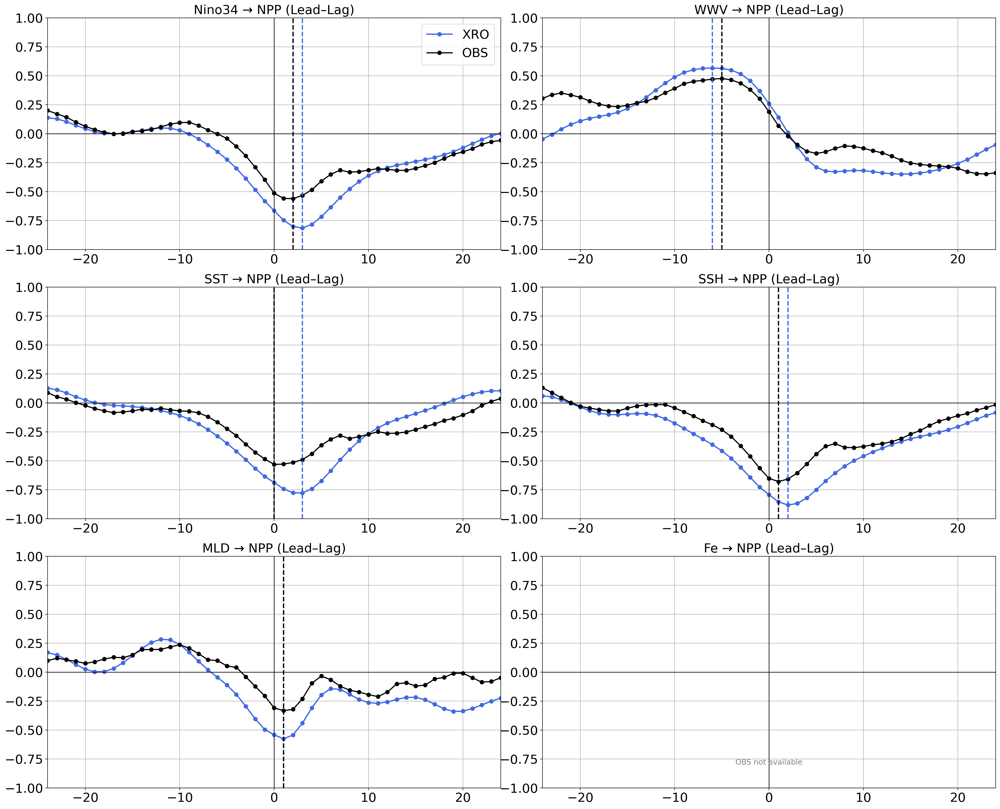

In [188]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt


# ---------------------------------------------------------
# Function: lead–lag correlation from OBS time series
# ---------------------------------------------------------
def leadlag_corr_obs(x, y, max_lag=24):
    lags = np.arange(-max_lag, max_lag + 1)
    corr = np.zeros(len(lags))
    for i, lag in enumerate(lags):
        if lag > 0:
            c = xr.corr(x.shift(time=lag), y, dim="time")
        elif lag < 0:
            c = xr.corr(x, y.shift(time=-lag), dim="time")
        else:
            c = xr.corr(x, y, dim="time")
        corr[i] = c.values
    return lags, corr


# ---------------------------------------------------------
# Function: lead–lag correlation from XRO forecasts
# (init × lead)
# ---------------------------------------------------------
def leadlag_corr_xro(pred, targ, max_lag=24):
    lags = np.arange(-max_lag, max_lag + 1)
    corr = np.zeros(len(lags))
    for i, lag in enumerate(lags):
        if lag > 0:
            p = pred[:, :-lag]
            t = targ[:, lag:]
        elif lag < 0:
            p = pred[:, -lag:]
            t = targ[:, :lag]
        else:
            p = pred
            t = targ
        p1 = p.values.flatten()
        t1 = t.values.flatten()
        mask = np.isfinite(p1) & np.isfinite(t1)
        corr[i] = np.corrcoef(p1[mask], t1[mask])[0, 1] if mask.sum() > 20 else np.nan
    return lags, corr


# =========================================================
# VARIABLES (OBS + XRO overlay)
# =========================================================
var_list = ["Nino34", "WWV", "SST", "SSH", "MLD", "Fe"]
target_obs = obs_all["NPP"]       # time
target_xro = OBS_XRO_NPP_fcst["NPP"]   # (init, lead)


# =========================================================
# FIGURE
# =========================================================
n = len(var_list)
ncol = 2
nrow = int(np.ceil(n / ncol))
plt.figure(figsize=(22, 18))

for i, var in enumerate(var_list):
    ax = plt.subplot(nrow, ncol, i+1)

    # ===== XRO correlation =====
    if var in OBS_XRO_NPP_fcst:
        pred_xro = OBS_XRO_NPP_fcst[var]
        lags, corr_xro = leadlag_corr_xro(pred_xro, target_xro, max_lag=24)
        ax.plot(lags, corr_xro, marker='o', color='royalblue',
                label='XRO', lw=2)

    # ===== OBS correlation =====
    if var in obs_all:
        pred_obs = obs_all[var]
        lags_obs, corr_obs = leadlag_corr_obs(pred_obs, target_obs, max_lag=24)
        ax.plot(lags_obs, corr_obs, marker='o', color='black',
                label='OBS', lw=1.8)
    else:
        ax.text(0.5, 0.1, "OBS not available", fontsize=12,
                transform=ax.transAxes, ha='center', color='gray')

    # zero axes
    ax.axhline(0, color='k', lw=1)
    ax.axvline(0, color='k', lw=1)

    ax.set_ylim(-1, 1)
    ax.set_xlim(-24, 24)
    ax.grid(True)

    # highlight strongest correlations
    if var in OBS_XRO_NPP_fcst:
        idx = np.nanargmax(np.abs(corr_xro))
        ax.axvline(lags[idx], color='royalblue', linestyle='--', lw=2)
    if var in obs_all:
        idx = np.nanargmax(np.abs(corr_obs))
        ax.axvline(lags_obs[idx], color='black', linestyle='--', lw=2)

    ax.set_title(f"{var} → NPP (Lead–Lag)", fontsize=20)

    if i == 0:
        ax.legend(fontsize=20)

    ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.show()


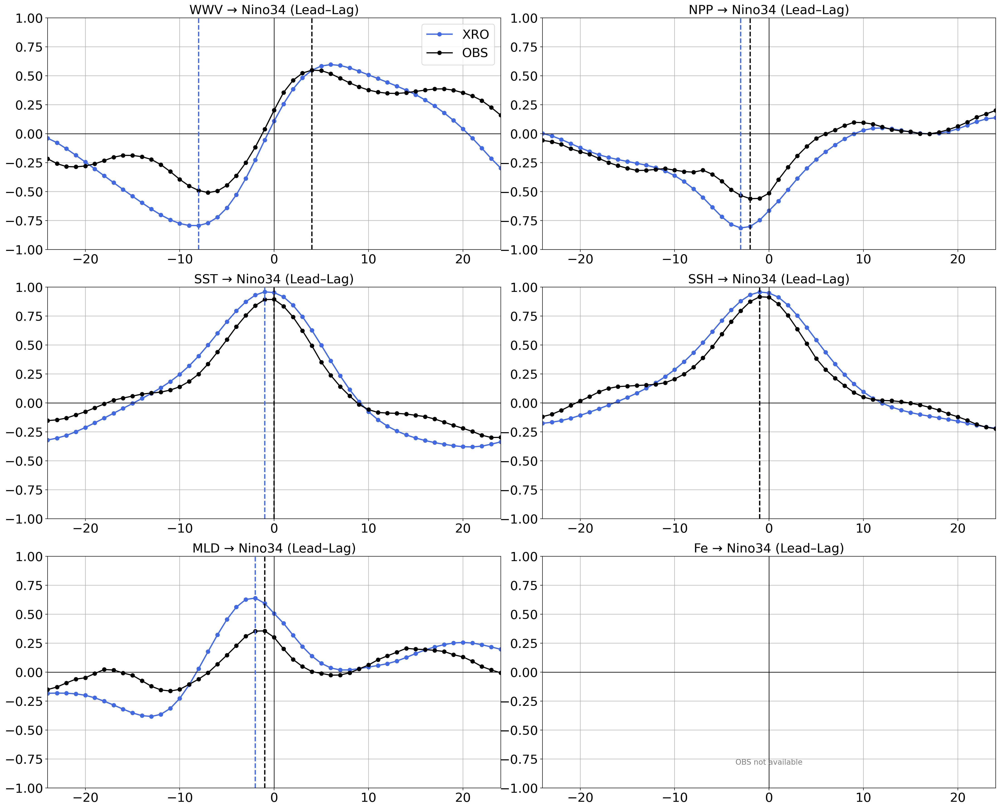

In [191]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt


# ---------------------------------------------------------
# Function: lead–lag correlation from OBS time series
# ---------------------------------------------------------
def leadlag_corr_obs(x, y, max_lag=24):
    lags = np.arange(-max_lag, max_lag + 1)
    corr = np.zeros(len(lags))
    for i, lag in enumerate(lags):
        if lag > 0:
            c = xr.corr(x.shift(time=lag), y, dim="time")
        elif lag < 0:
            c = xr.corr(x, y.shift(time=-lag), dim="time")
        else:
            c = xr.corr(x, y, dim="time")
        corr[i] = c.values
    return lags, corr


# ---------------------------------------------------------
# Function: lead–lag correlation from XRO forecasts
# (init × lead)
# ---------------------------------------------------------
def leadlag_corr_xro(pred, targ, max_lag=24):
    lags = np.arange(-max_lag, max_lag + 1)
    corr = np.zeros(len(lags))
    for i, lag in enumerate(lags):
        if lag > 0:
            p = pred[:, :-lag]
            t = targ[:, lag:]
        elif lag < 0:
            p = pred[:, -lag:]
            t = targ[:, :lag]
        else:
            p = pred
            t = targ
        p1 = p.values.flatten()
        t1 = t.values.flatten()
        mask = np.isfinite(p1) & np.isfinite(t1)
        corr[i] = np.corrcoef(p1[mask], t1[mask])[0, 1] if mask.sum() > 20 else np.nan
    return lags, corr


# =========================================================
# VARIABLES (OBS + XRO overlay)
# =========================================================
var_list = ["WWV", "NPP", "SST", "SSH", "MLD", "Fe"]
target_obs = obs_all["Nino34"]       # time
target_xro = OBS_XRO_NPP_fcst["Nino34"]   # (init, lead)


# =========================================================
# FIGURE
# =========================================================
n = len(var_list)
ncol = 2
nrow = int(np.ceil(n / ncol))
plt.figure(figsize=(22, 18))

for i, var in enumerate(var_list):
    ax = plt.subplot(nrow, ncol, i+1)

    # ===== XRO correlation =====
    if var in OBS_XRO_NPP_fcst:
        pred_xro = OBS_XRO_NPP_fcst[var]
        lags, corr_xro = leadlag_corr_xro(pred_xro, target_xro, max_lag=24)
        ax.plot(lags, corr_xro, marker='o', color='royalblue',
                label='XRO', lw=2)

    # ===== OBS correlation =====
    if var in obs_all:
        pred_obs = obs_all[var]
        lags_obs, corr_obs = leadlag_corr_obs(pred_obs, target_obs, max_lag=24)
        ax.plot(lags_obs, corr_obs, marker='o', color='black',
                label='OBS', lw=1.8)
    else:
        ax.text(0.5, 0.1, "OBS not available", fontsize=12,
                transform=ax.transAxes, ha='center', color='gray')

    # zero axes
    ax.axhline(0, color='k', lw=1)
    ax.axvline(0, color='k', lw=1)

    ax.set_ylim(-1, 1)
    ax.set_xlim(-24, 24)
    ax.grid(True)

    # highlight strongest correlations
    if var in OBS_XRO_NPP_fcst:
        idx = np.nanargmax(np.abs(corr_xro))
        ax.axvline(lags[idx], color='royalblue', linestyle='--', lw=2)
    if var in obs_all:
        idx = np.nanargmax(np.abs(corr_obs))
        ax.axvline(lags_obs[idx], color='black', linestyle='--', lw=2)

    ax.set_title(f"{var} → Nino34 (Lead–Lag)", fontsize=20)

    if i == 0:
        ax.legend(fontsize=20)

    ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.show()


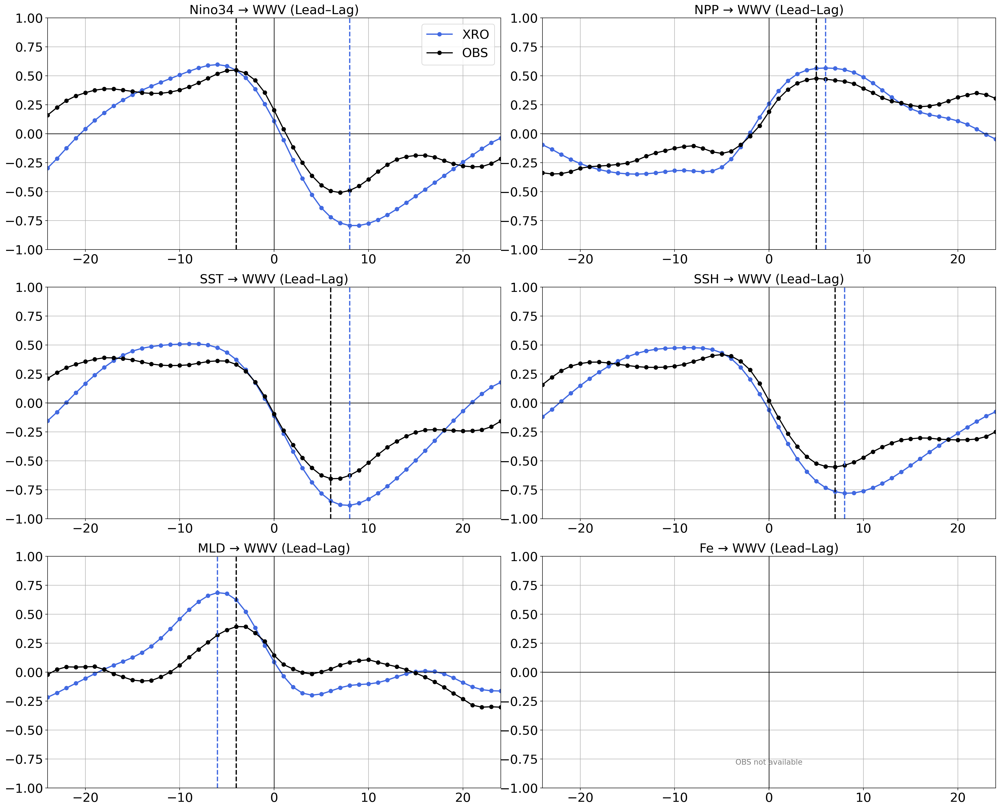

In [193]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt


# ---------------------------------------------------------
# Function: lead–lag correlation from OBS time series
# ---------------------------------------------------------
def leadlag_corr_obs(x, y, max_lag=24):
    lags = np.arange(-max_lag, max_lag + 1)
    corr = np.zeros(len(lags))
    for i, lag in enumerate(lags):
        if lag > 0:
            c = xr.corr(x.shift(time=lag), y, dim="time")
        elif lag < 0:
            c = xr.corr(x, y.shift(time=-lag), dim="time")
        else:
            c = xr.corr(x, y, dim="time")
        corr[i] = c.values
    return lags, corr


# ---------------------------------------------------------
# Function: lead–lag correlation from XRO forecasts
# (init × lead)
# ---------------------------------------------------------
def leadlag_corr_xro(pred, targ, max_lag=24):
    lags = np.arange(-max_lag, max_lag + 1)
    corr = np.zeros(len(lags))
    for i, lag in enumerate(lags):
        if lag > 0:
            p = pred[:, :-lag]
            t = targ[:, lag:]
        elif lag < 0:
            p = pred[:, -lag:]
            t = targ[:, :lag]
        else:
            p = pred
            t = targ
        p1 = p.values.flatten()
        t1 = t.values.flatten()
        mask = np.isfinite(p1) & np.isfinite(t1)
        corr[i] = np.corrcoef(p1[mask], t1[mask])[0, 1] if mask.sum() > 20 else np.nan
    return lags, corr


# =========================================================
# VARIABLES (OBS + XRO overlay)
# =========================================================
var_list = ["Nino34", "NPP", "SST", "SSH", "MLD", "Fe"]
target_obs = obs_all["WWV"]       # time
target_xro = OBS_XRO_NPP_fcst["WWV"]   # (init, lead)


# =========================================================
# FIGURE
# =========================================================
n = len(var_list)
ncol = 2
nrow = int(np.ceil(n / ncol))
plt.figure(figsize=(22, 18))

for i, var in enumerate(var_list):
    ax = plt.subplot(nrow, ncol, i+1)

    # ===== XRO correlation =====
    if var in OBS_XRO_NPP_fcst:
        pred_xro = OBS_XRO_NPP_fcst[var]
        lags, corr_xro = leadlag_corr_xro(pred_xro, target_xro, max_lag=24)
        ax.plot(lags, corr_xro, marker='o', color='royalblue',
                label='XRO', lw=2)

    # ===== OBS correlation =====
    if var in obs_all:
        pred_obs = obs_all[var]
        lags_obs, corr_obs = leadlag_corr_obs(pred_obs, target_obs, max_lag=24)
        ax.plot(lags_obs, corr_obs, marker='o', color='black',
                label='OBS', lw=1.8)
    else:
        ax.text(0.5, 0.1, "OBS not available", fontsize=12,
                transform=ax.transAxes, ha='center', color='gray')

    # zero axes
    ax.axhline(0, color='k', lw=1)
    ax.axvline(0, color='k', lw=1)

    ax.set_ylim(-1, 1)
    ax.set_xlim(-24, 24)
    ax.grid(True)

    # highlight strongest correlations
    if var in OBS_XRO_NPP_fcst:
        idx = np.nanargmax(np.abs(corr_xro))
        ax.axvline(lags[idx], color='royalblue', linestyle='--', lw=2)
    if var in obs_all:
        idx = np.nanargmax(np.abs(corr_obs))
        ax.axvline(lags_obs[idx], color='black', linestyle='--', lw=2)

    ax.set_title(f"{var} → WWV (Lead–Lag)", fontsize=20)

    if i == 0:
        ax.legend(fontsize=20)

    ax.tick_params(axis='both', labelsize=20)

plt.tight_layout()
plt.show()


In [1]:
a=1